# ECE 228 Unet (ISBI 2012 dataset)

# Python imports

In [1]:
import numpy as np
import os
import sys
from matplotlib import pyplot as plt
%matplotlib inline  

import torch
from torch import nn
from torch.autograd import Variable
from torchvision import transforms, utils
from skimage import io, transform
from skimage.color import rgb2gray

from models import * 
from train import *
from data_loader import * 

from scipy import ndimage

from matplotlib.colors import ListedColormap


# Load data

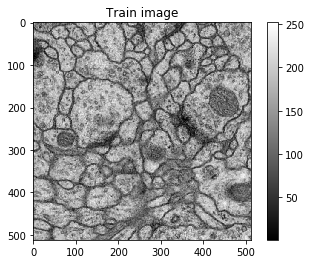

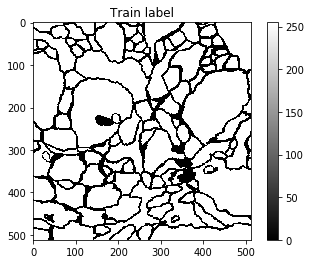

train_imgs shape =  (30, 1, 512, 512)
train_labels shape =  (30, 1, 512, 512)


In [2]:
from PIL import Image

data_tif = Image.open('datasets/isbi_2012/train-volume.tif')
train_imgs = []
i = 0
while True:
    try:
        data_tif.seek(i)
        train_imgs.append(np.array(data_tif))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_imgs = np.array(train_imgs)
train_imgs = np.expand_dims(train_imgs, axis=1)


label_tif = Image.open('datasets/isbi_2012/train-labels.tif')
train_labels = []
i = 0
while True:
    try:
        label_tif.seek(i)
        train_labels.append(np.array(label_tif))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_labels = np.array(train_labels)
train_labels = np.expand_dims(train_labels, axis=1)

plt.imshow(np.squeeze(train_imgs[0]),cmap="gray")
plt.title("Train image")
plt.colorbar()
plt.show()

plt.imshow(np.squeeze(train_labels[0]), cmap="gray")
plt.title("Train label")
plt.colorbar()
plt.show()


#train_imgs = (train_imgs/127)-1
train_labels = (train_labels != 0).astype(np.uint8)




print("train_imgs shape = ",train_imgs.shape)
print("train_labels shape = ",train_labels.shape)




# Run Training

GPU is enabled 
80/20 training/validation split
total_train_size =  30
val_size =  24
y train shape =  (6, 512, 512)
y train shape =  (24, 512, 512)
training image from batch 0


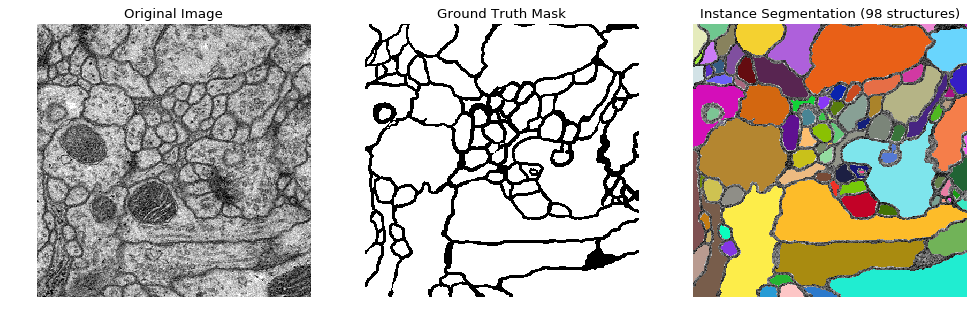

training image from batch 1


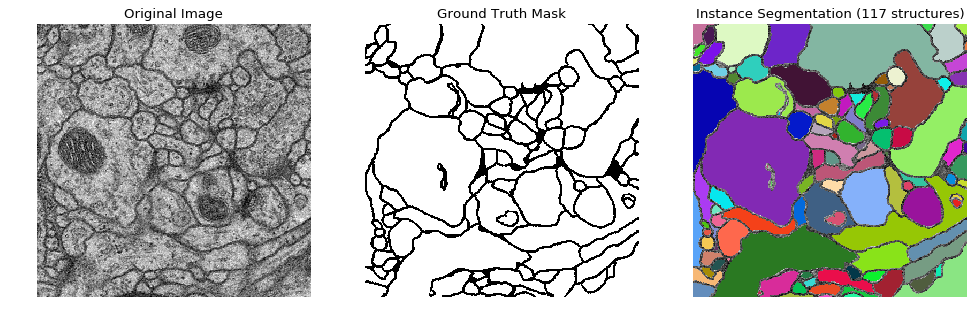

training image from batch 2


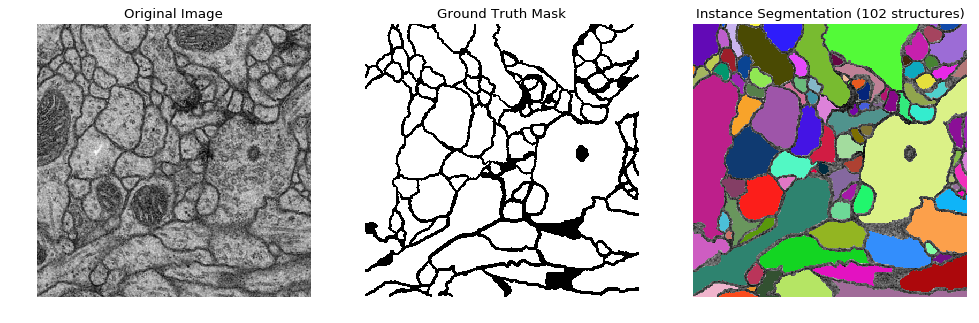

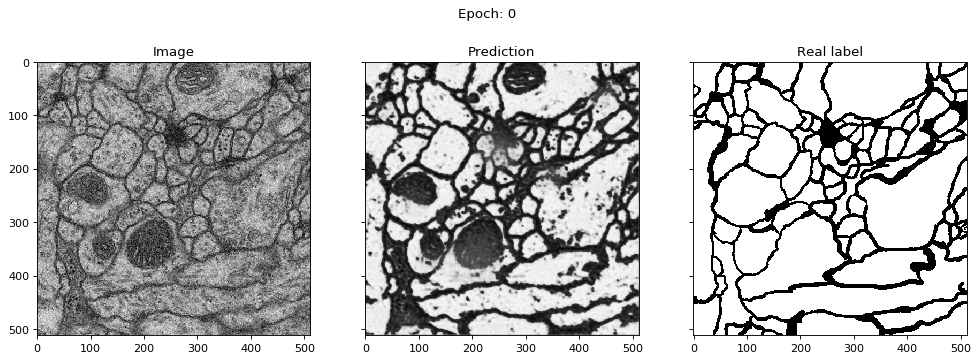

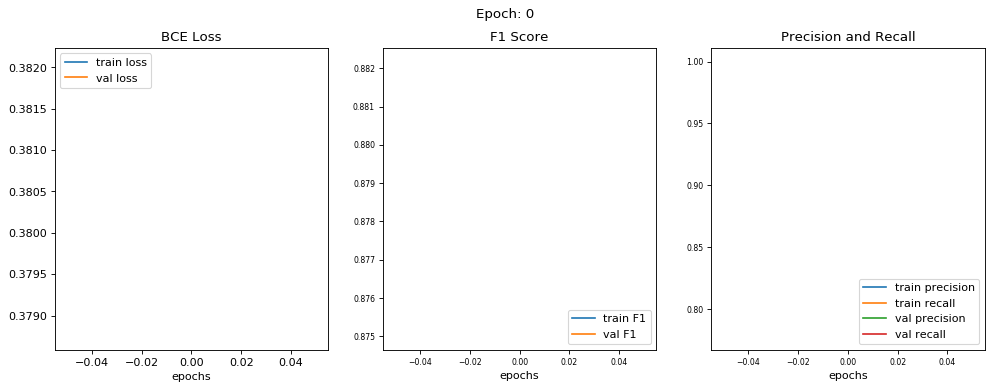

epoch [0/100] 
train loss = 0.3788, train f1 score = 0.8822 
train precision = 0.7895, train recall = 1.0000 

val loss = 0.3821, val f1 score = 0.8750 
val precision = 0.7781, val recall = 1.0000 




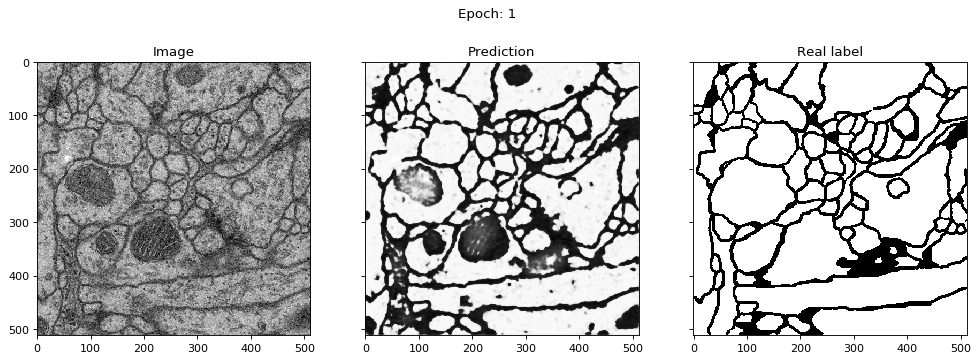

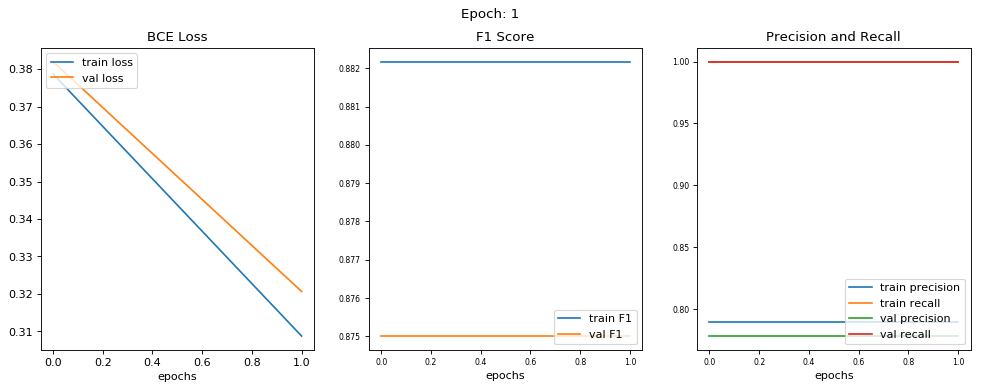

epoch [1/100] 
train loss = 0.3087, train f1 score = 0.8822 
train precision = 0.7895, train recall = 1.0000 

val loss = 0.3207, val f1 score = 0.8750 
val precision = 0.7781, val recall = 1.0000 




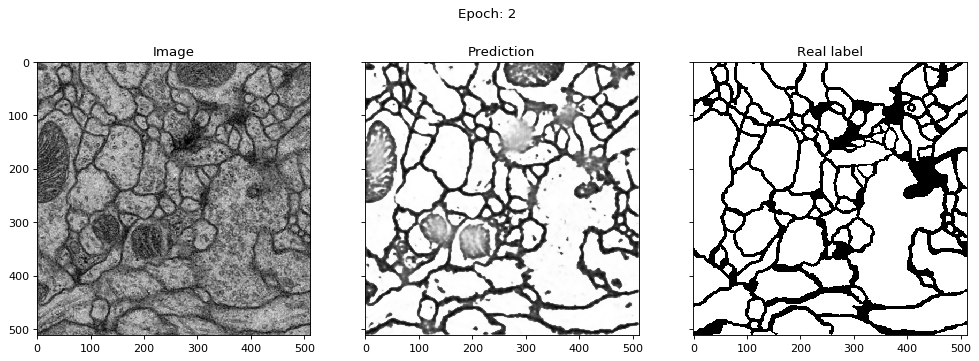

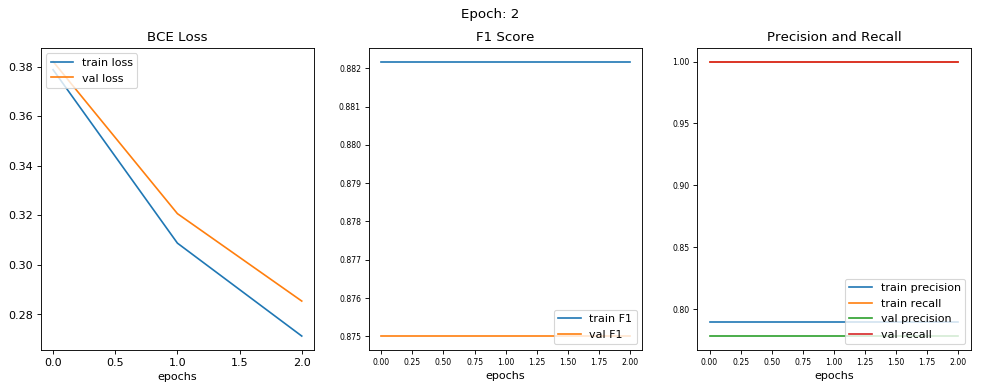

epoch [2/100] 
train loss = 0.2712, train f1 score = 0.8822 
train precision = 0.7895, train recall = 1.0000 

val loss = 0.2854, val f1 score = 0.8750 
val precision = 0.7781, val recall = 1.0000 




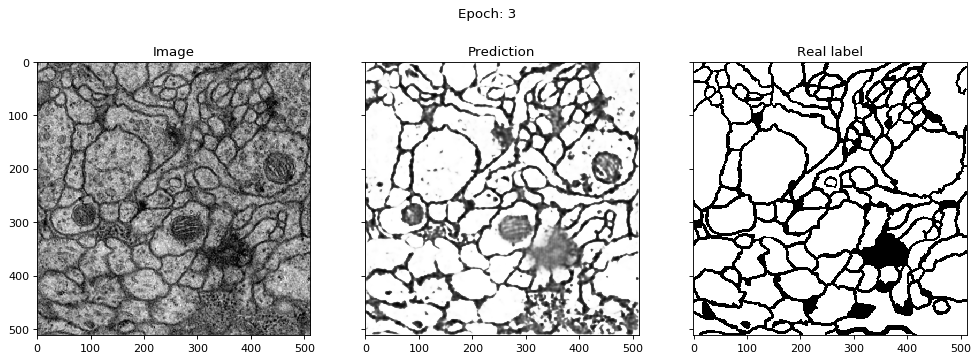

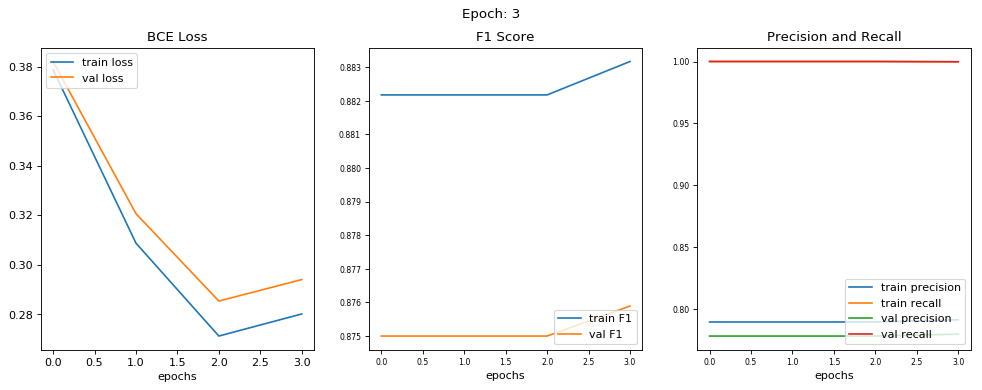

epoch [3/100] 
train loss = 0.2802, train f1 score = 0.8832 
train precision = 0.7912, train recall = 0.9997 

val loss = 0.2940, val f1 score = 0.8759 
val precision = 0.7796, val recall = 0.9998 




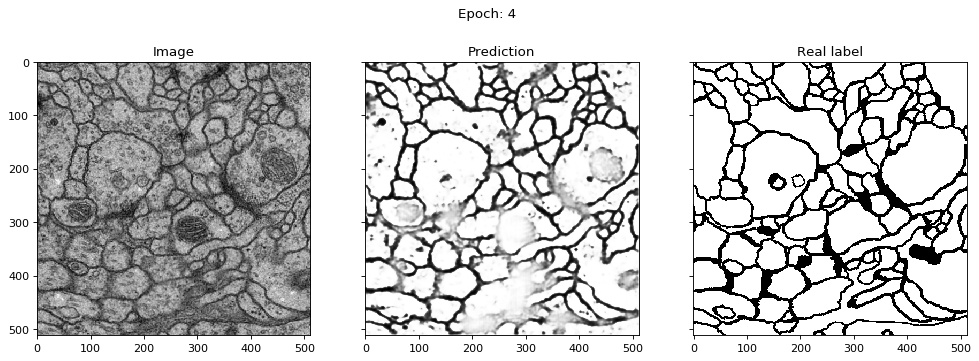

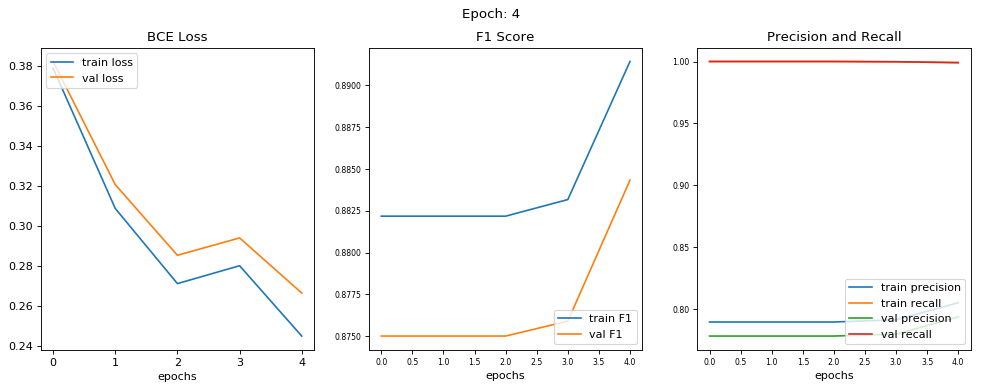

epoch [4/100] 
train loss = 0.2451, train f1 score = 0.8914 
train precision = 0.8050, train recall = 0.9991 

val loss = 0.2665, val f1 score = 0.8843 
val precision = 0.7936, val recall = 0.9991 




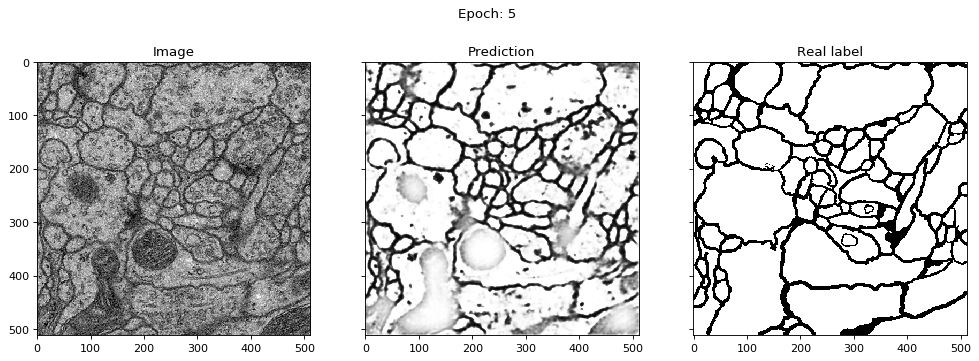

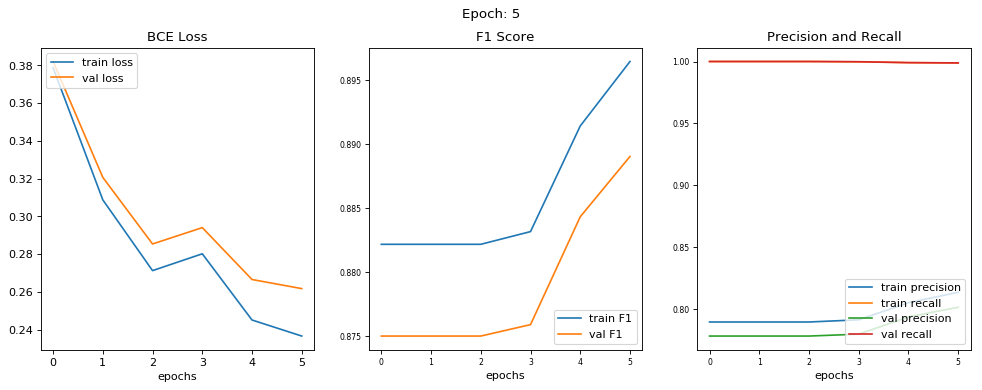

epoch [5/100] 
train loss = 0.2366, train f1 score = 0.8965 
train precision = 0.8135, train recall = 0.9988 

val loss = 0.2617, val f1 score = 0.8890 
val precision = 0.8014, val recall = 0.9989 




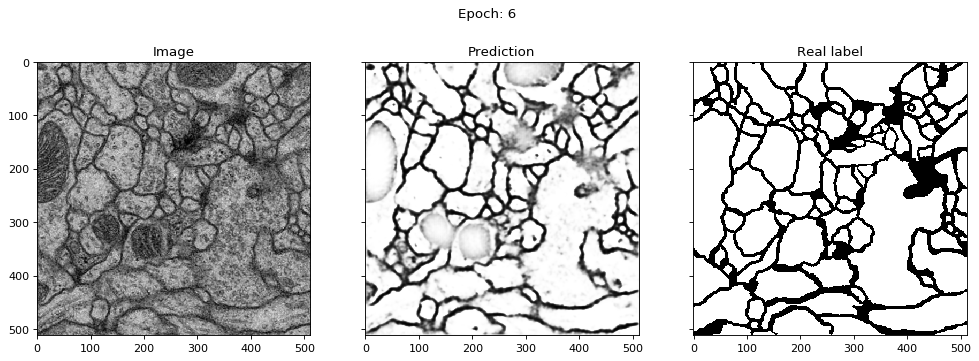

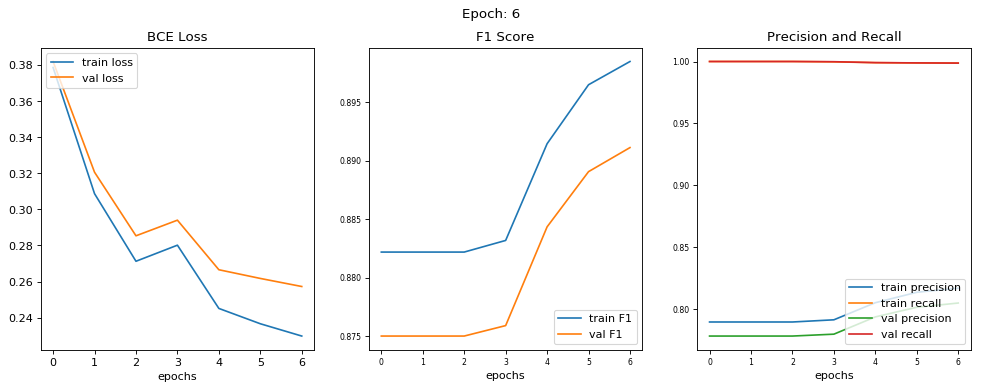

epoch [6/100] 
train loss = 0.2297, train f1 score = 0.8985 
train precision = 0.8168, train recall = 0.9987 

val loss = 0.2572, val f1 score = 0.8911 
val precision = 0.8048, val recall = 0.9987 




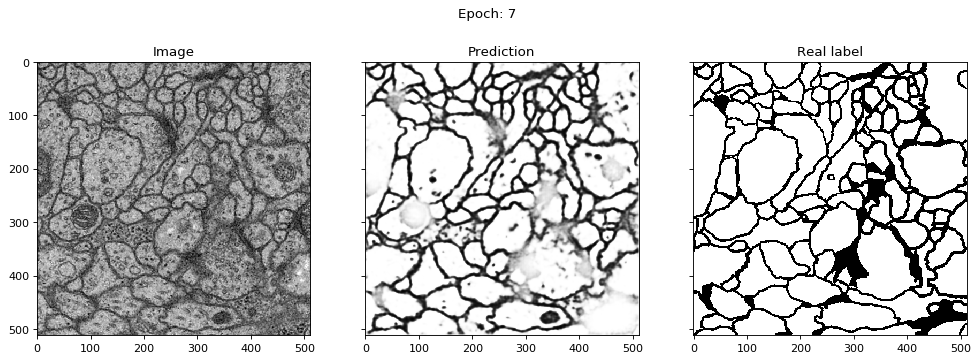

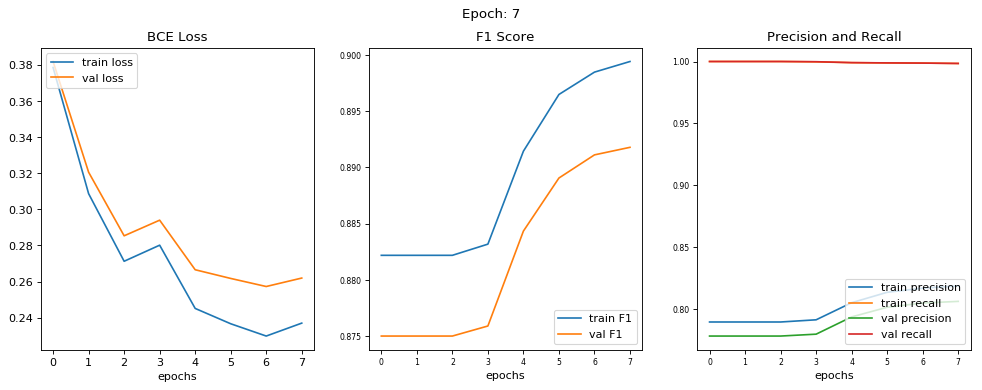

epoch [7/100] 
train loss = 0.2369, train f1 score = 0.8994 
train precision = 0.8186, train recall = 0.9984 

val loss = 0.2619, val f1 score = 0.8918 
val precision = 0.8061, val recall = 0.9984 




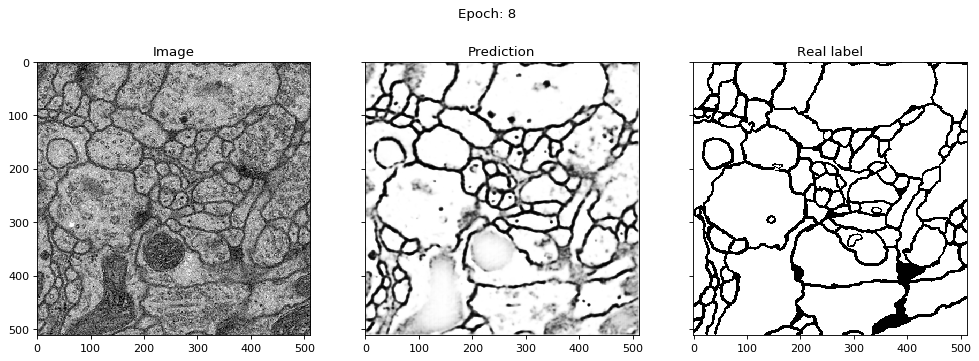

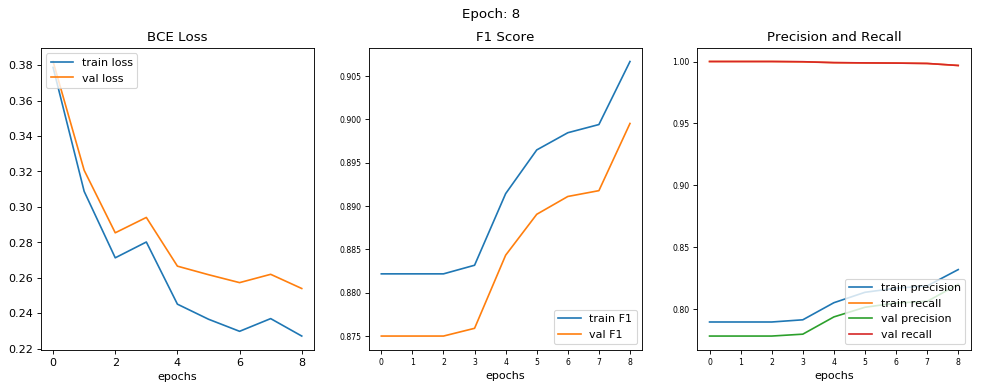

epoch [8/100] 
train loss = 0.2271, train f1 score = 0.9067 
train precision = 0.8318, train recall = 0.9968 

val loss = 0.2539, val f1 score = 0.8995 
val precision = 0.8199, val recall = 0.9968 




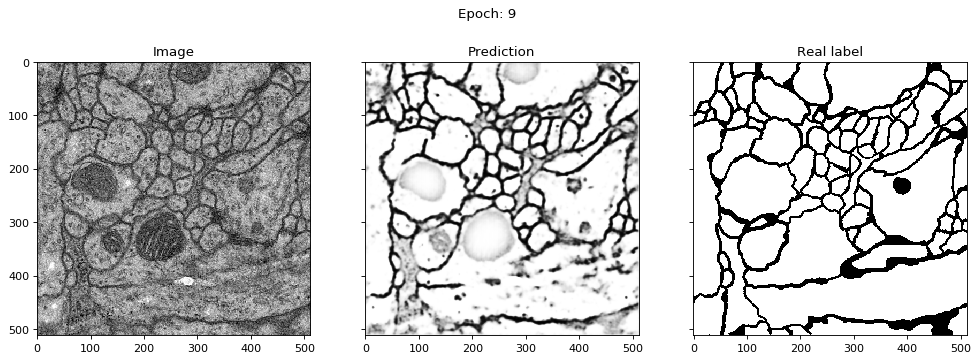

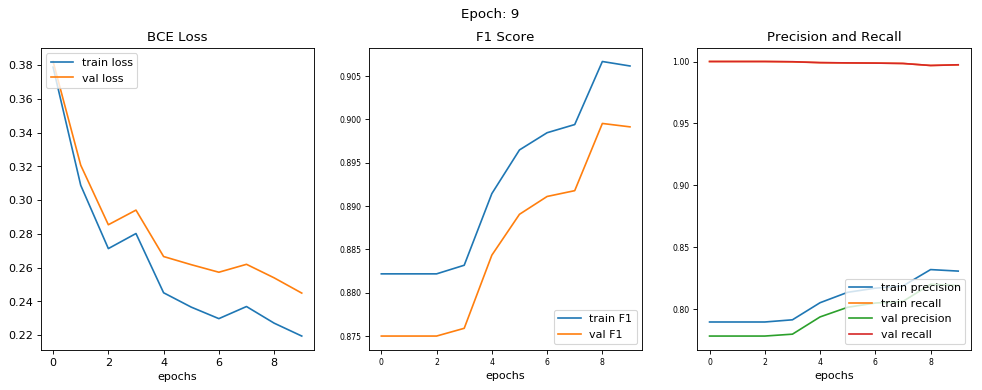

epoch [9/100] 
train loss = 0.2194, train f1 score = 0.9062 
train precision = 0.8306, train recall = 0.9973 

val loss = 0.2449, val f1 score = 0.8991 
val precision = 0.8189, val recall = 0.9974 




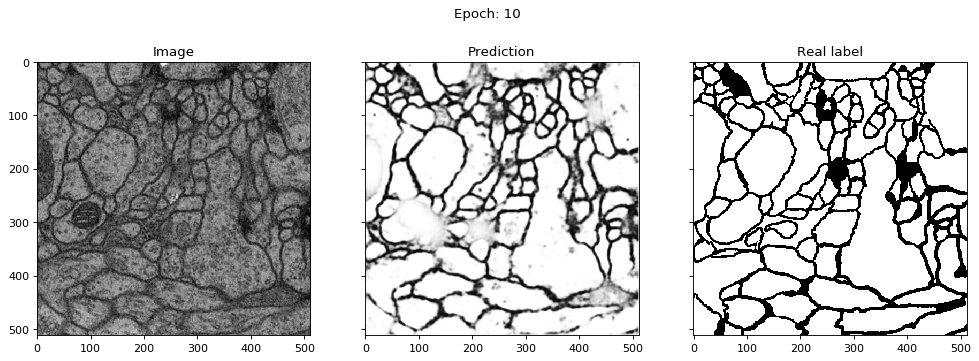

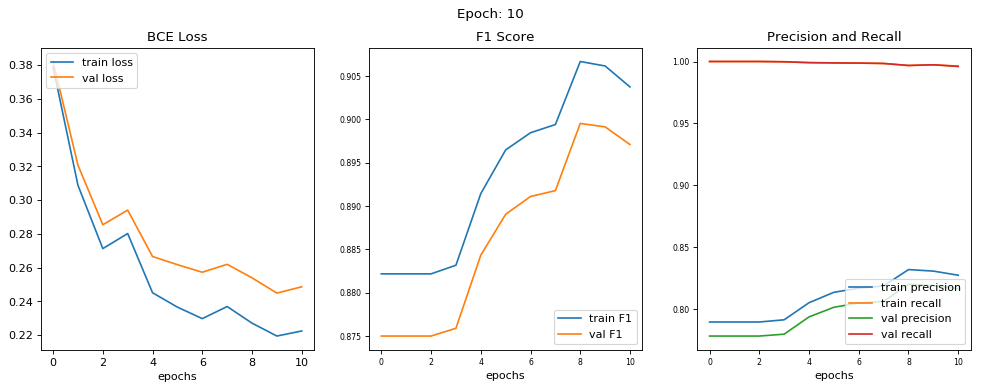

epoch [10/100] 
train loss = 0.2224, train f1 score = 0.9037 
train precision = 0.8273, train recall = 0.9963 

val loss = 0.2486, val f1 score = 0.8971 
val precision = 0.8164, val recall = 0.9960 




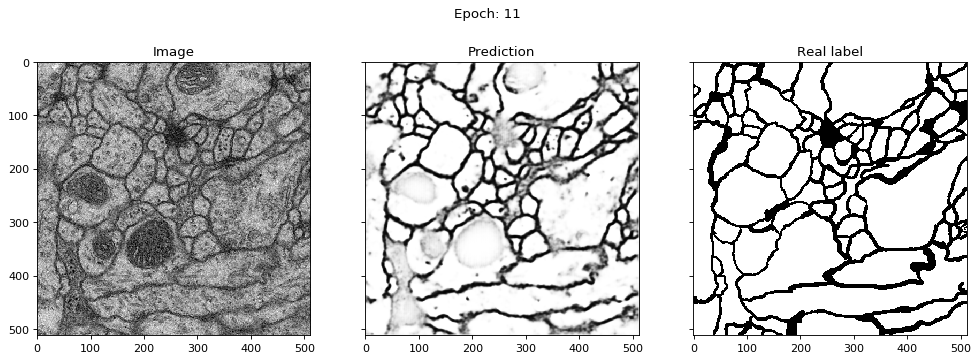

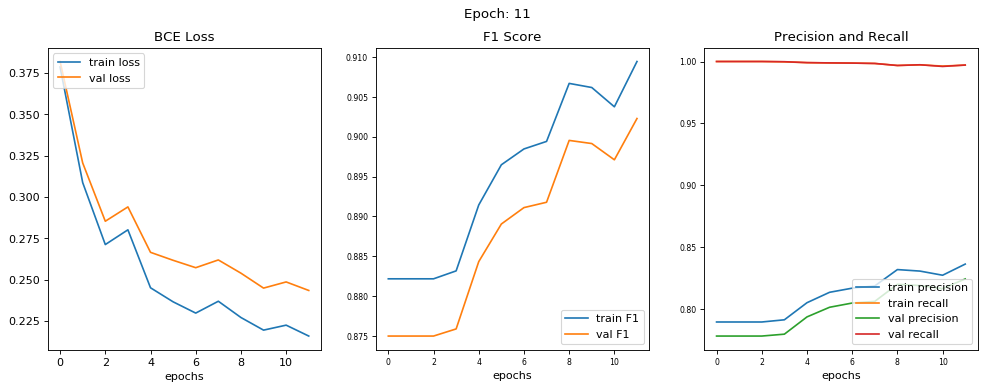

epoch [11/100] 
train loss = 0.2158, train f1 score = 0.9094 
train precision = 0.8363, train recall = 0.9971 

val loss = 0.2435, val f1 score = 0.9023 
val precision = 0.8243, val recall = 0.9971 




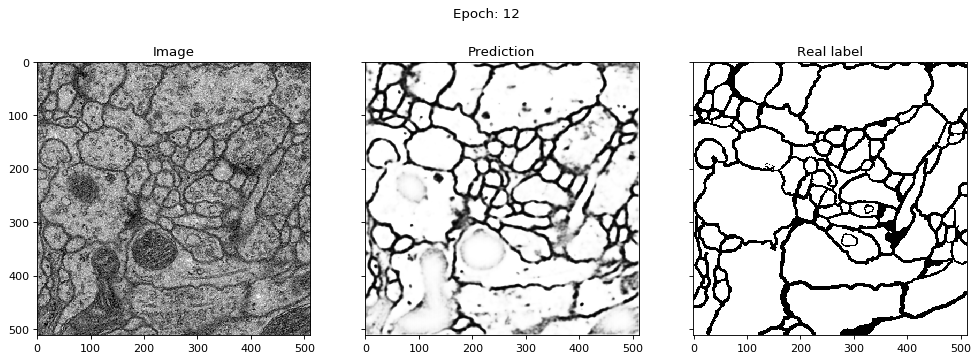

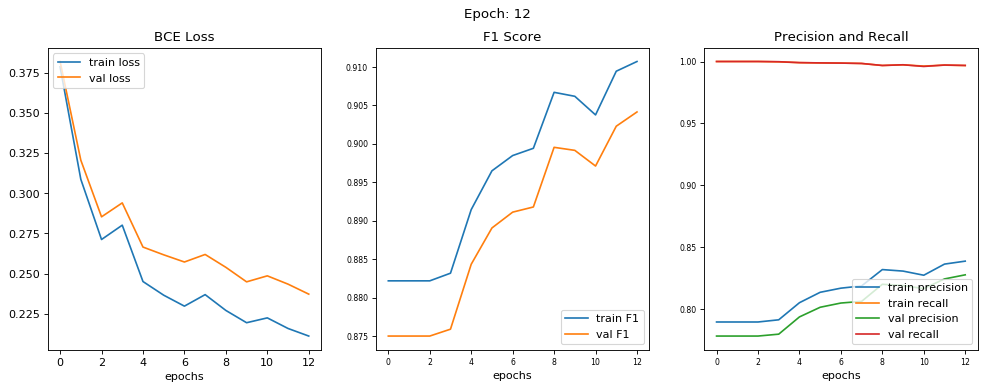

epoch [12/100] 
train loss = 0.2111, train f1 score = 0.9107 
train precision = 0.8386, train recall = 0.9967 

val loss = 0.2372, val f1 score = 0.9041 
val precision = 0.8276, val recall = 0.9968 




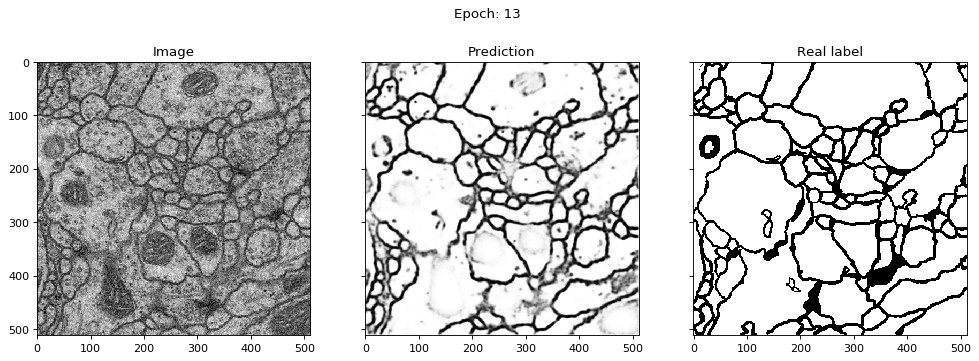

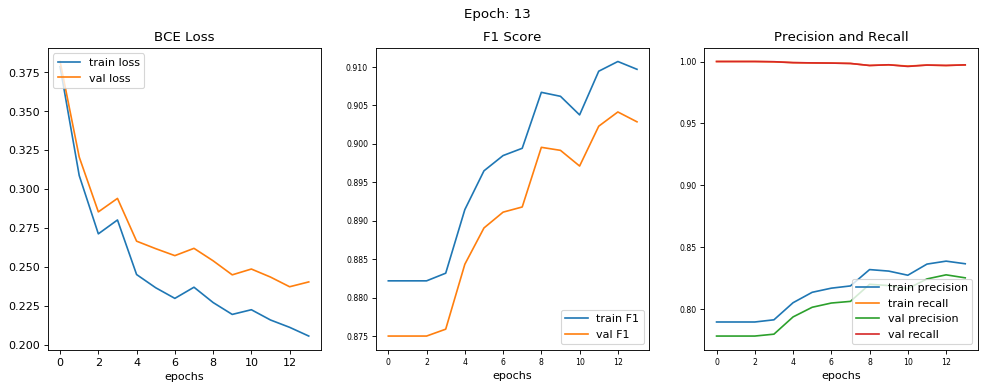

epoch [13/100] 
train loss = 0.2055, train f1 score = 0.9097 
train precision = 0.8365, train recall = 0.9973 

val loss = 0.2403, val f1 score = 0.9028 
val precision = 0.8251, val recall = 0.9973 




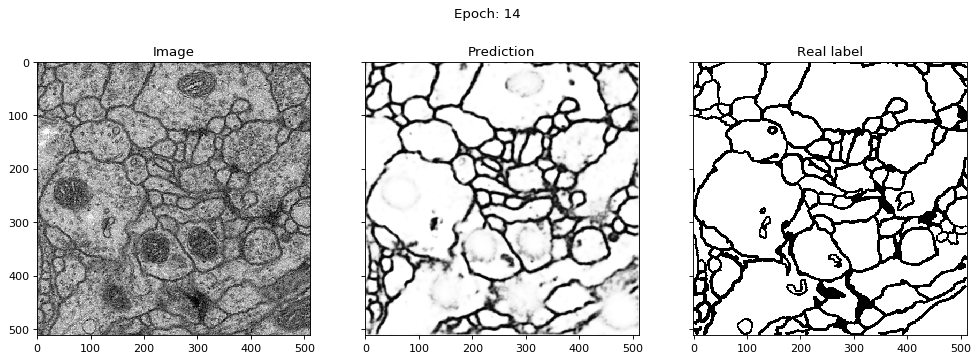

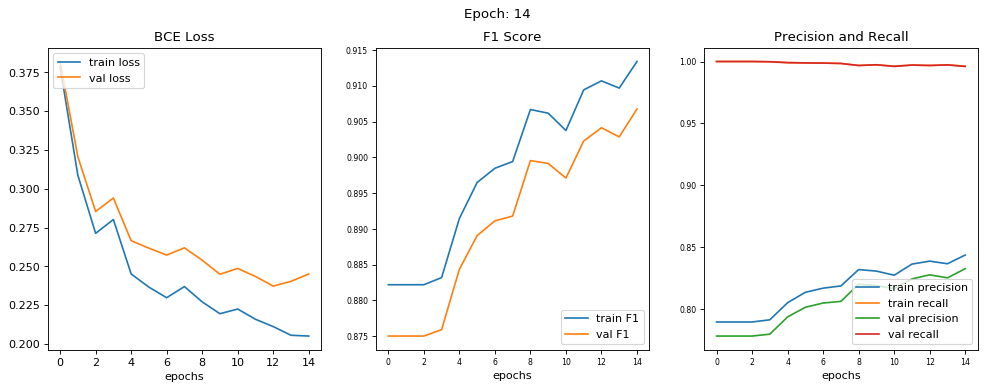

epoch [14/100] 
train loss = 0.2050, train f1 score = 0.9134 
train precision = 0.8436, train recall = 0.9962 

val loss = 0.2450, val f1 score = 0.9068 
val precision = 0.8326, val recall = 0.9960 




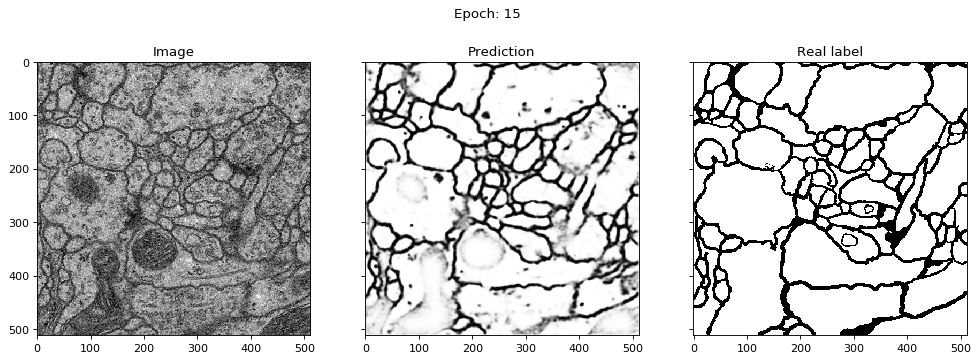

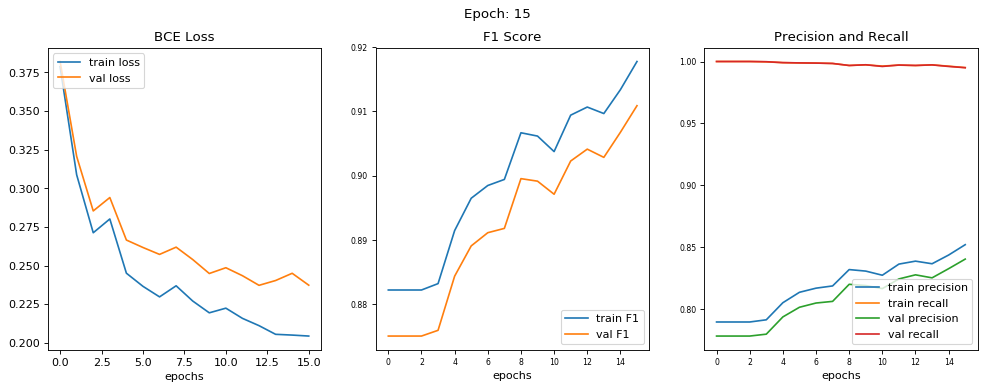

epoch [15/100] 
train loss = 0.2044, train f1 score = 0.9178 
train precision = 0.8520, train recall = 0.9951 

val loss = 0.2373, val f1 score = 0.9109 
val precision = 0.8403, val recall = 0.9950 




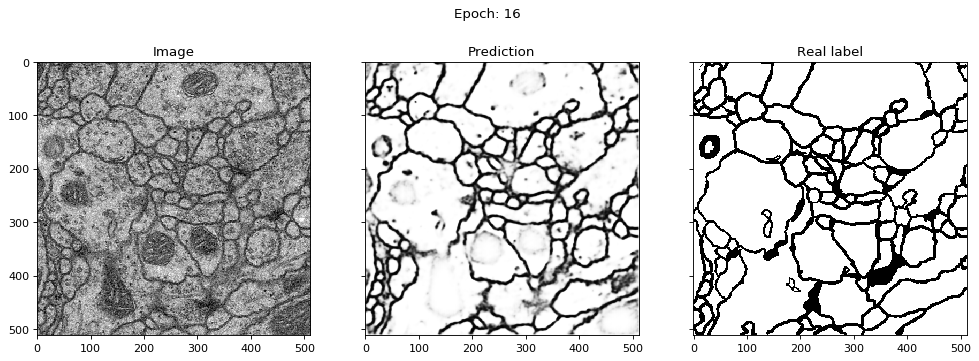

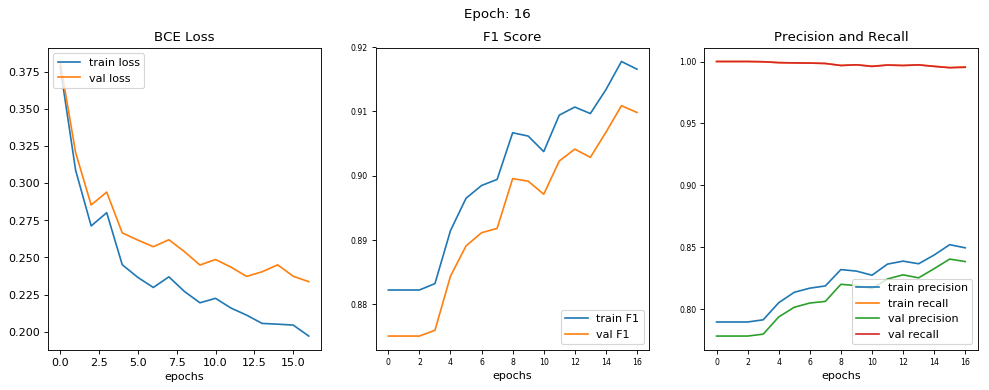

epoch [16/100] 
train loss = 0.1970, train f1 score = 0.9166 
train precision = 0.8494, train recall = 0.9958 

val loss = 0.2337, val f1 score = 0.9098 
val precision = 0.8383, val recall = 0.9953 




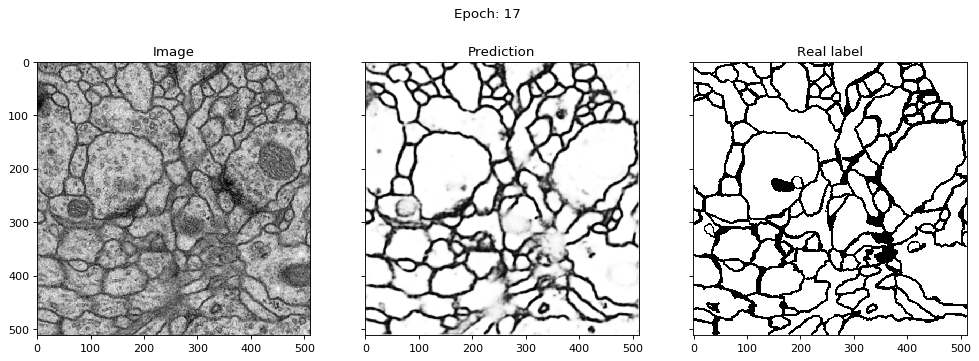

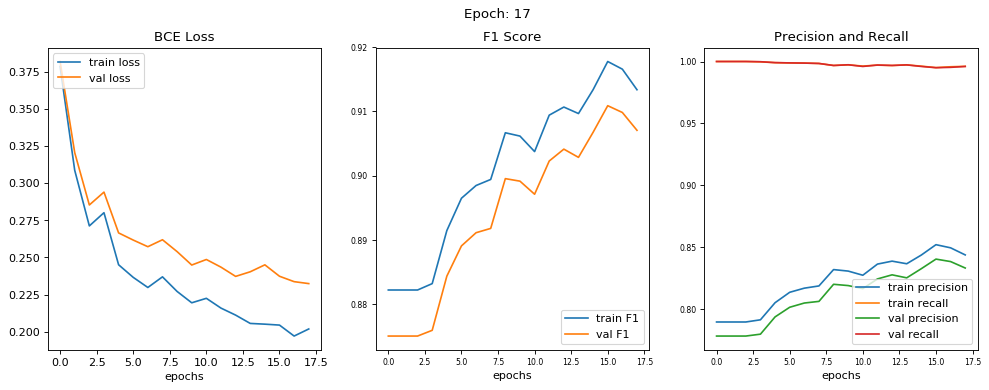

epoch [17/100] 
train loss = 0.2018, train f1 score = 0.9134 
train precision = 0.8437, train recall = 0.9961 

val loss = 0.2324, val f1 score = 0.9071 
val precision = 0.8331, val recall = 0.9960 




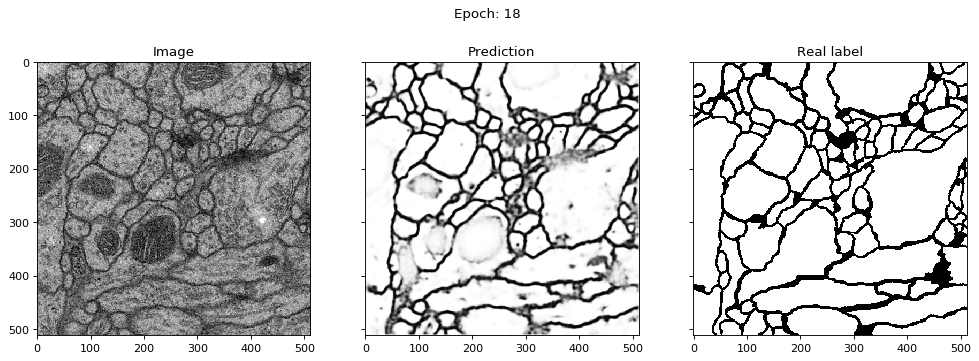

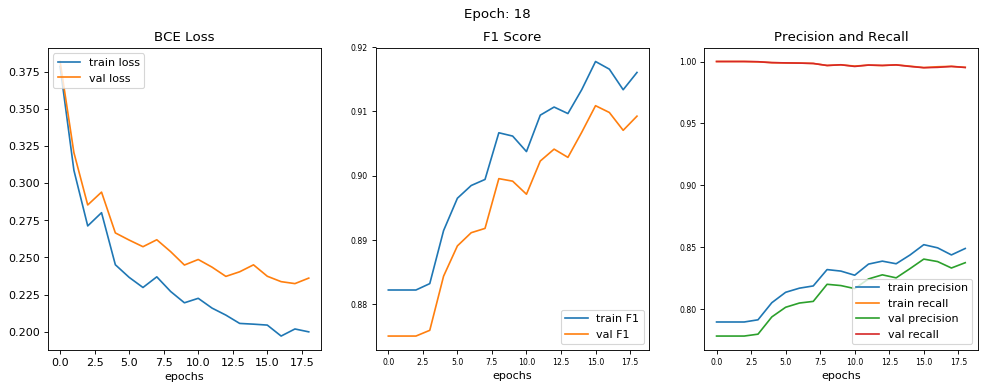

epoch [18/100] 
train loss = 0.1998, train f1 score = 0.9161 
train precision = 0.8489, train recall = 0.9953 

val loss = 0.2361, val f1 score = 0.9093 
val precision = 0.8374, val recall = 0.9952 




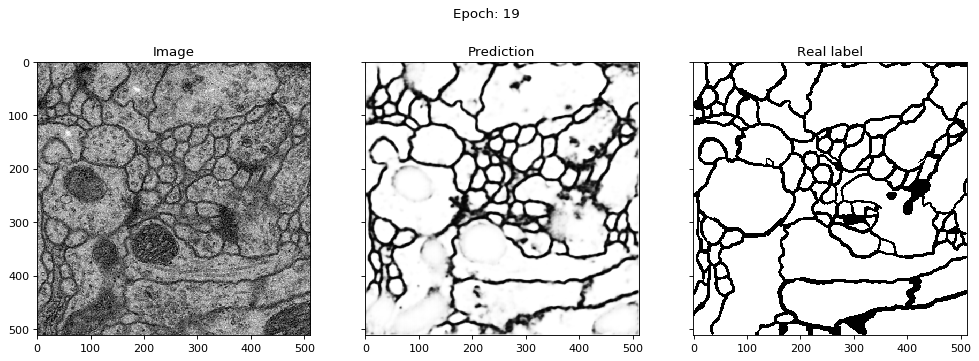

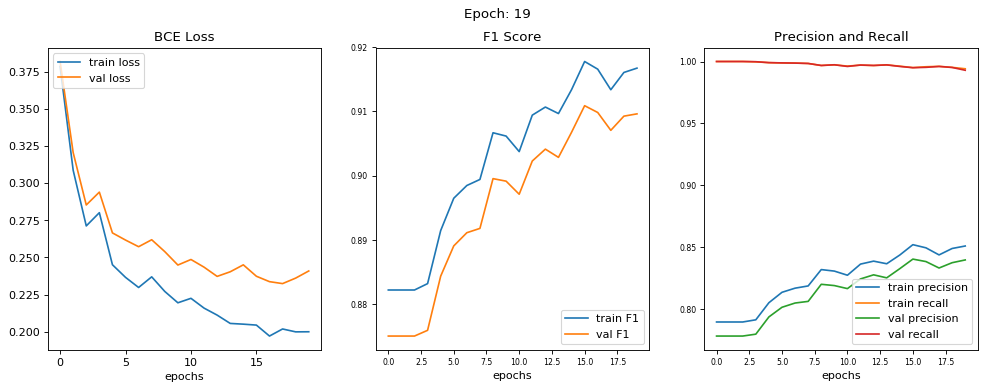

epoch [19/100] 
train loss = 0.1999, train f1 score = 0.9168 
train precision = 0.8509, train recall = 0.9941 

val loss = 0.2409, val f1 score = 0.9096 
val precision = 0.8396, val recall = 0.9929 




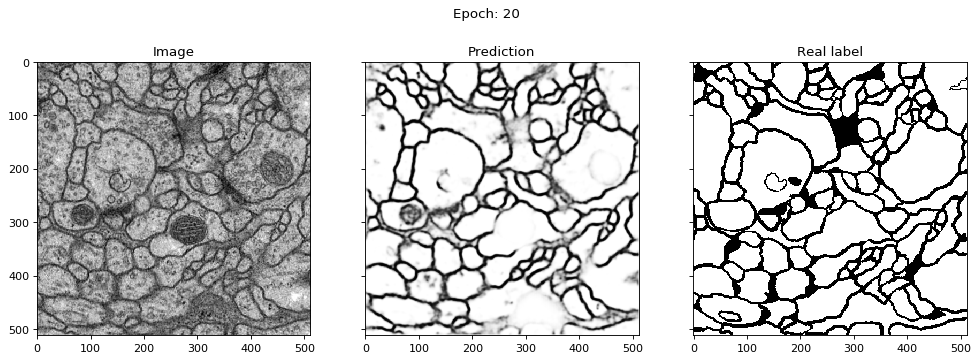

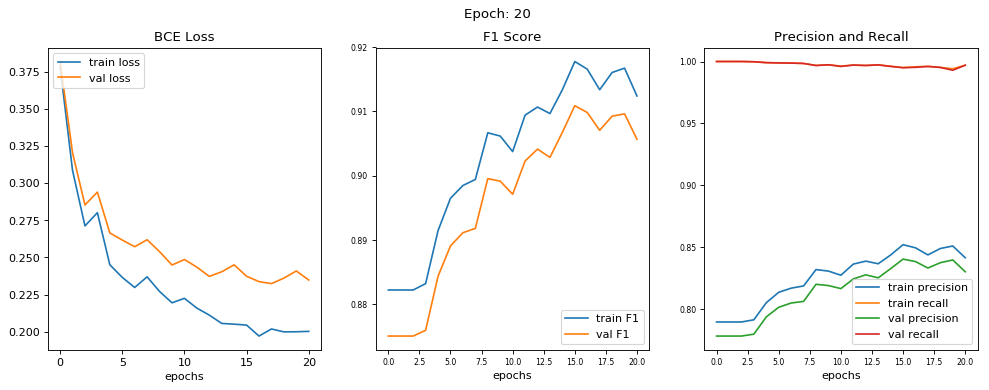

epoch [20/100] 
train loss = 0.2002, train f1 score = 0.9124 
train precision = 0.8414, train recall = 0.9970 

val loss = 0.2348, val f1 score = 0.9057 
val precision = 0.8301, val recall = 0.9970 




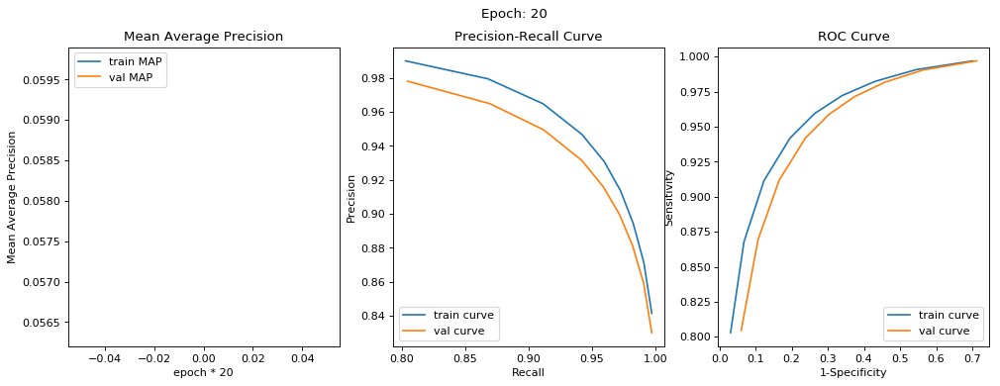

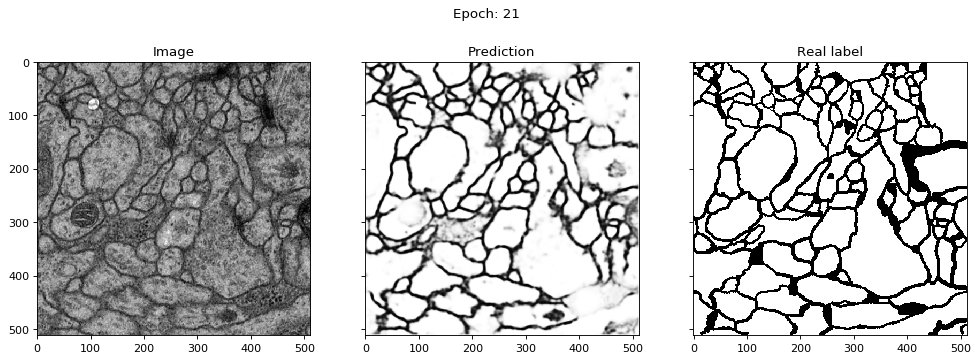

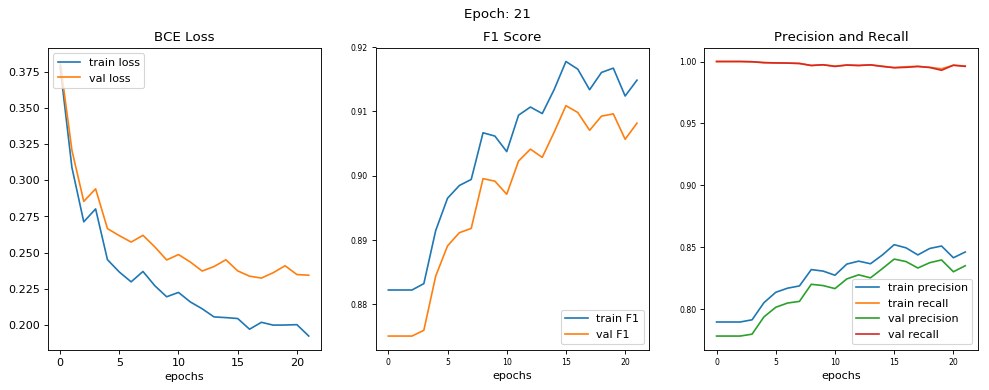

epoch [21/100] 
train loss = 0.1923, train f1 score = 0.9149 
train precision = 0.8460, train recall = 0.9964 

val loss = 0.2343, val f1 score = 0.9082 
val precision = 0.8349, val recall = 0.9961 




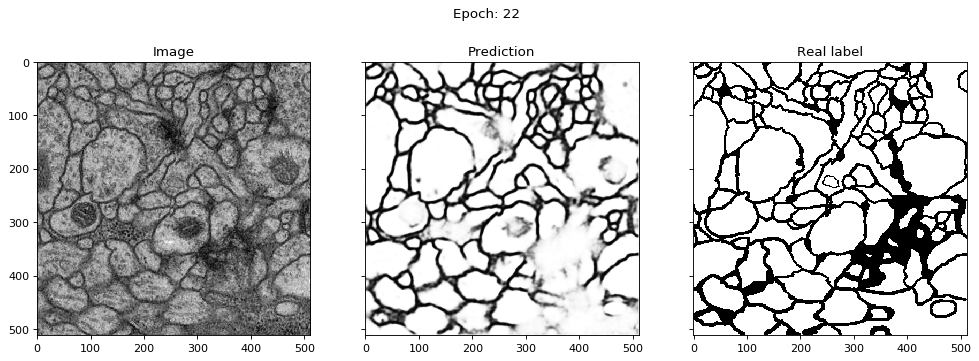

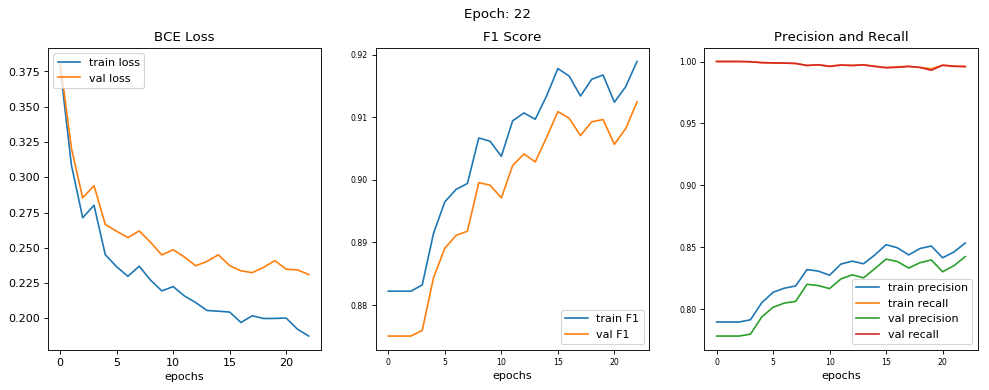

epoch [22/100] 
train loss = 0.1874, train f1 score = 0.9189 
train precision = 0.8533, train recall = 0.9960 

val loss = 0.2310, val f1 score = 0.9124 
val precision = 0.8423, val recall = 0.9959 




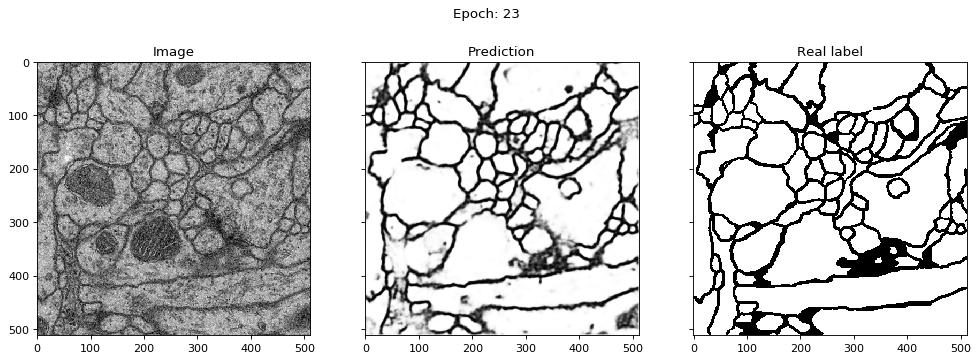

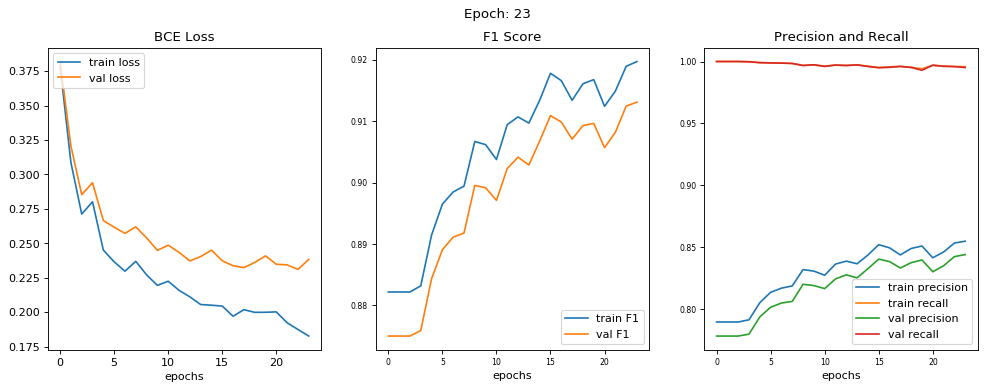

epoch [23/100] 
train loss = 0.1826, train f1 score = 0.9197 
train precision = 0.8548, train recall = 0.9958 

val loss = 0.2383, val f1 score = 0.9131 
val precision = 0.8440, val recall = 0.9951 




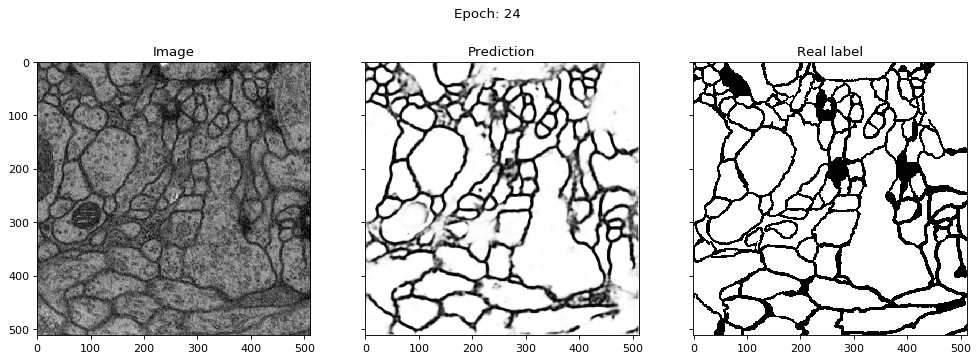

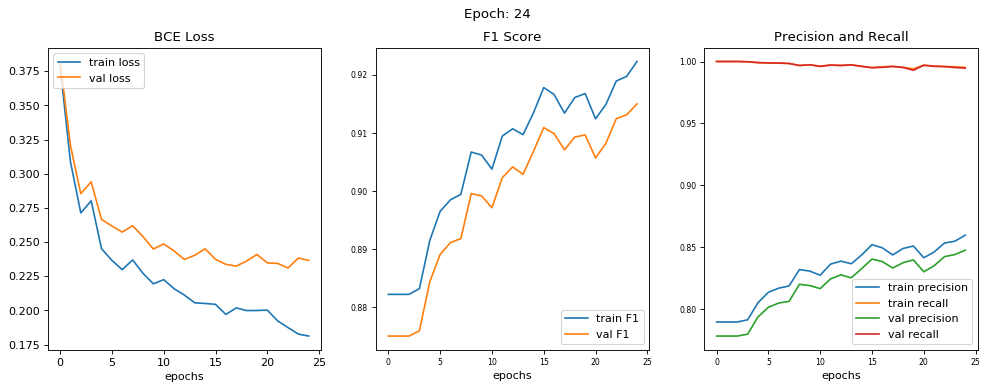

epoch [24/100] 
train loss = 0.1812, train f1 score = 0.9223 
train precision = 0.8596, train recall = 0.9952 

val loss = 0.2366, val f1 score = 0.9150 
val precision = 0.8475, val recall = 0.9946 




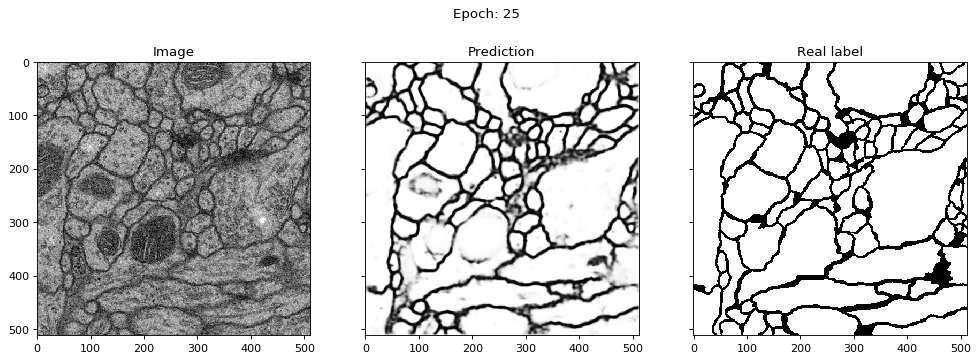

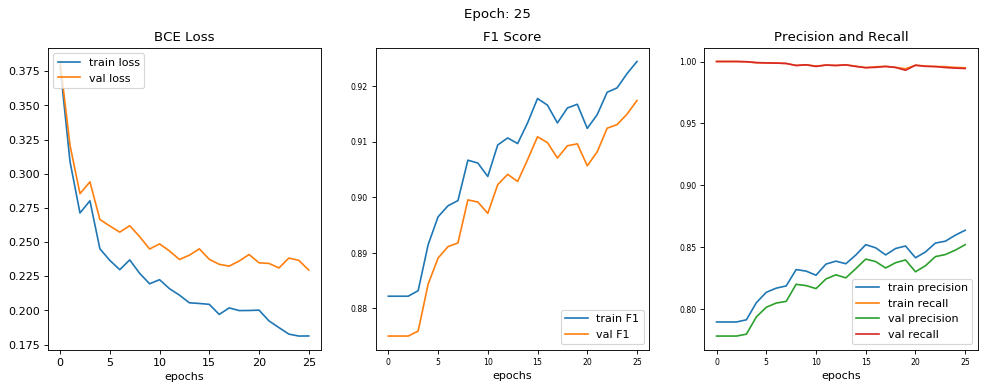

epoch [25/100] 
train loss = 0.1813, train f1 score = 0.9245 
train precision = 0.8636, train recall = 0.9949 

val loss = 0.2295, val f1 score = 0.9174 
val precision = 0.8520, val recall = 0.9944 




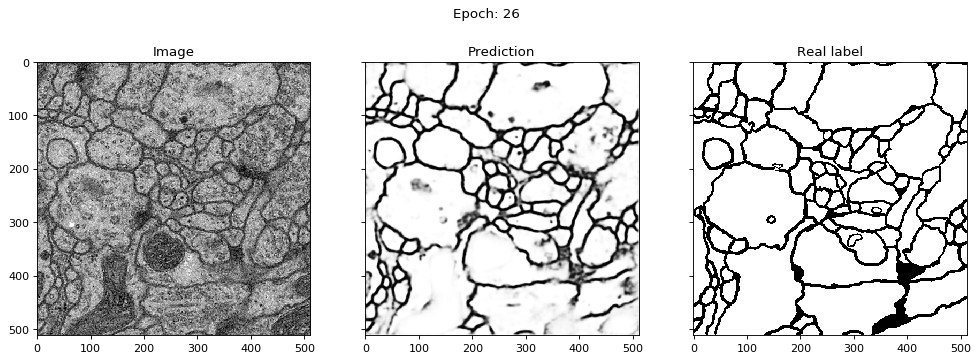

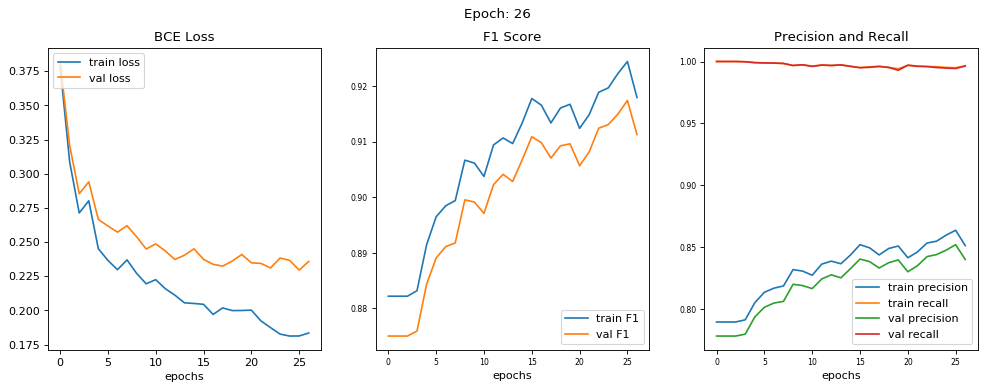

epoch [26/100] 
train loss = 0.1834, train f1 score = 0.9180 
train precision = 0.8512, train recall = 0.9966 

val loss = 0.2358, val f1 score = 0.9113 
val precision = 0.8400, val recall = 0.9963 




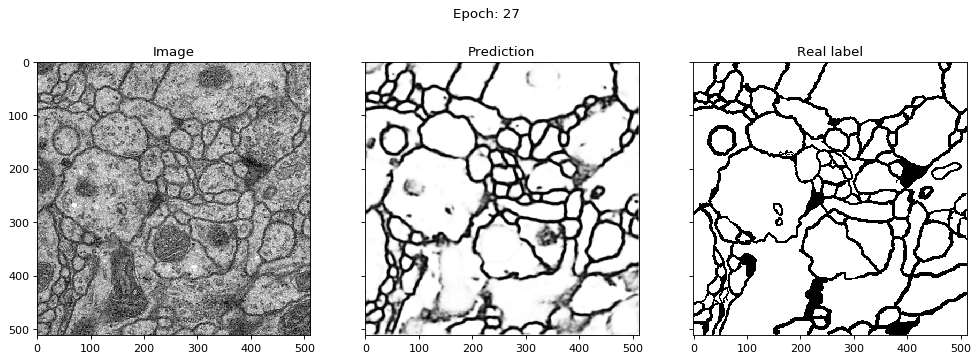

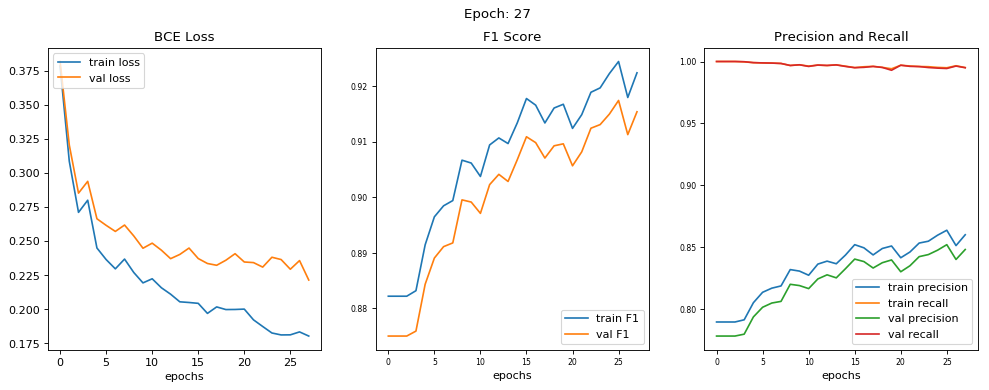

epoch [27/100] 
train loss = 0.1804, train f1 score = 0.9224 
train precision = 0.8600, train recall = 0.9951 

val loss = 0.2215, val f1 score = 0.9154 
val precision = 0.8480, val recall = 0.9950 




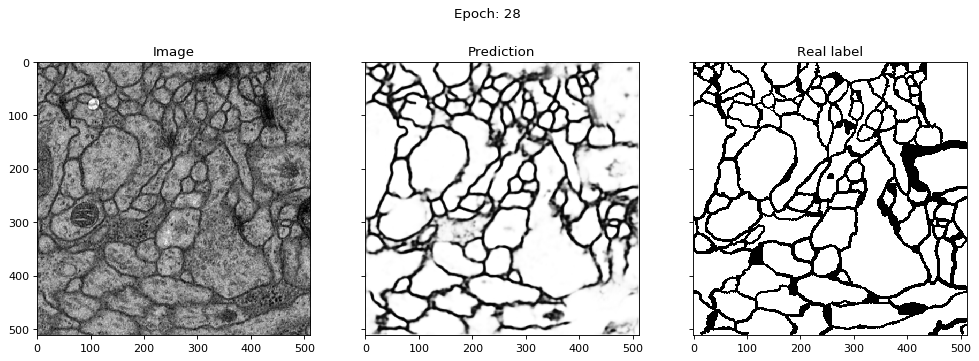

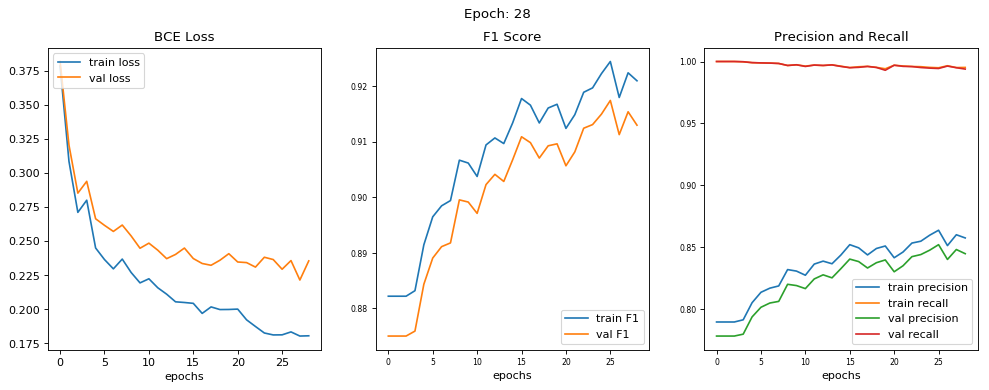

epoch [28/100] 
train loss = 0.1806, train f1 score = 0.9210 
train precision = 0.8574, train recall = 0.9952 

val loss = 0.2356, val f1 score = 0.9130 
val precision = 0.8447, val recall = 0.9939 




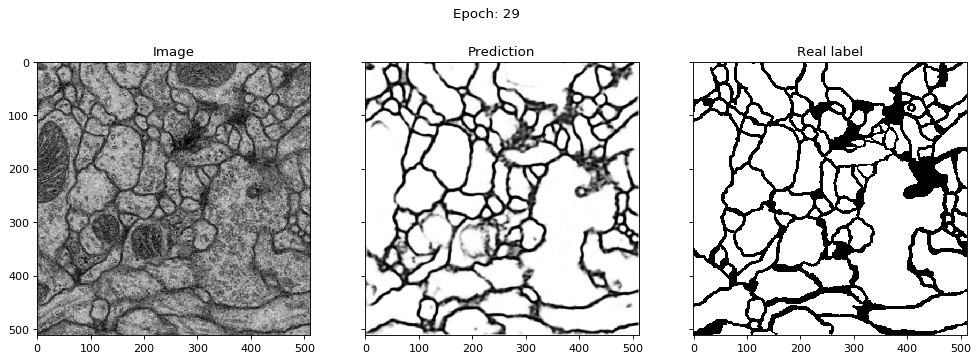

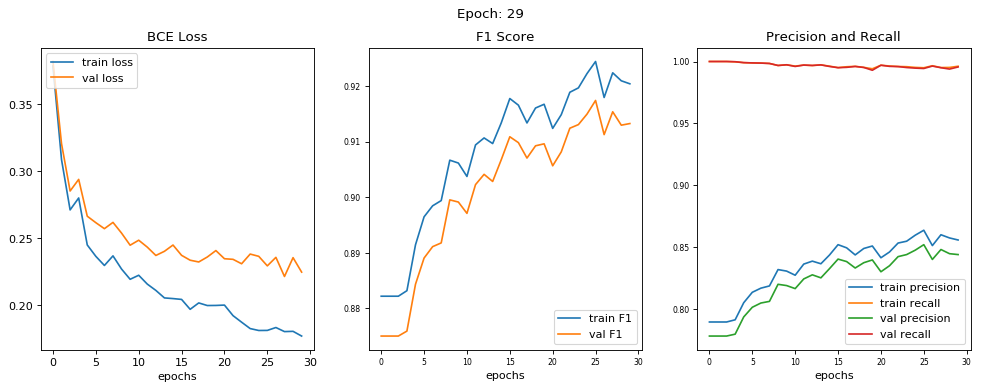

epoch [29/100] 
train loss = 0.1770, train f1 score = 0.9204 
train precision = 0.8557, train recall = 0.9962 

val loss = 0.2248, val f1 score = 0.9133 
val precision = 0.8439, val recall = 0.9956 




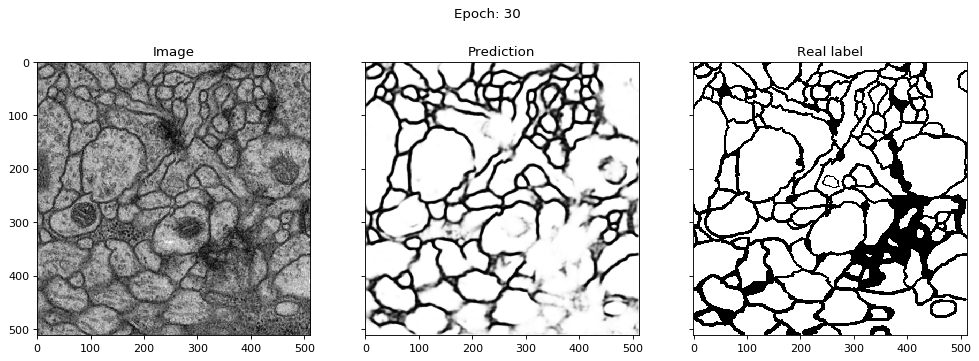

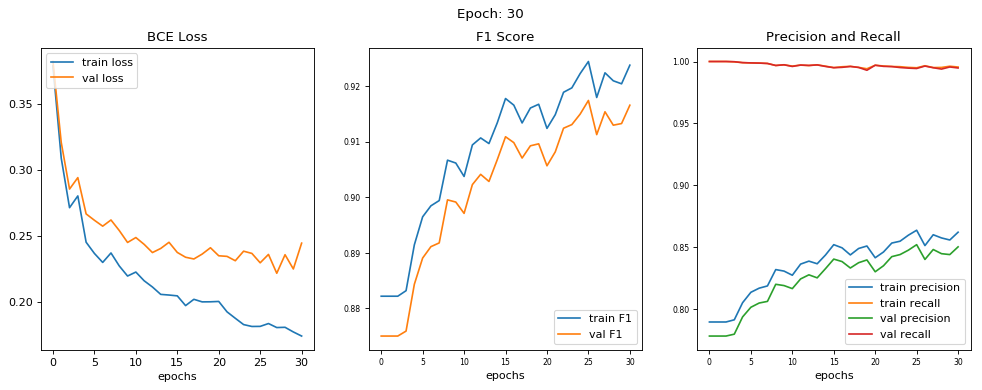

epoch [30/100] 
train loss = 0.1739, train f1 score = 0.9238 
train precision = 0.8620, train recall = 0.9955 

val loss = 0.2444, val f1 score = 0.9166 
val precision = 0.8502, val recall = 0.9948 




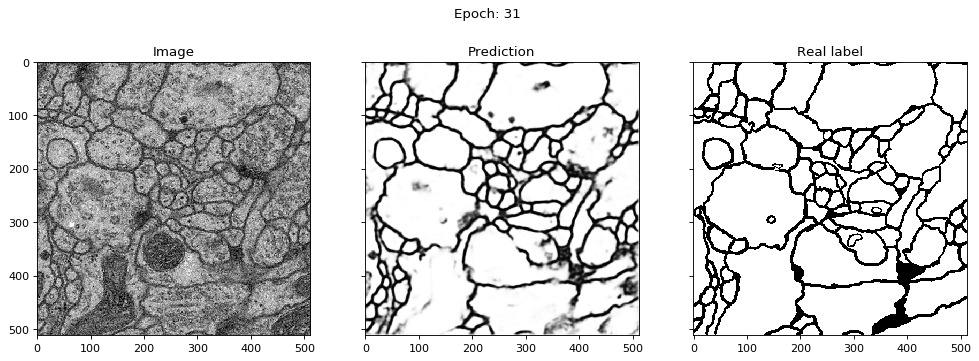

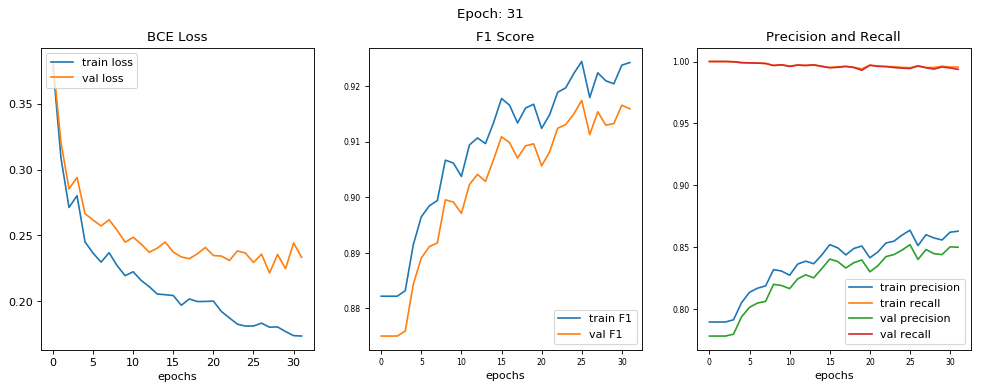

epoch [31/100] 
train loss = 0.1736, train f1 score = 0.9243 
train precision = 0.8628, train recall = 0.9955 

val loss = 0.2333, val f1 score = 0.9159 
val precision = 0.8499, val recall = 0.9937 




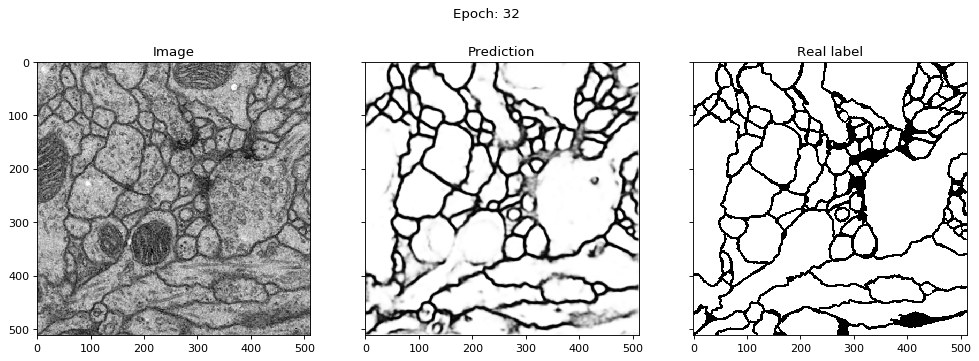

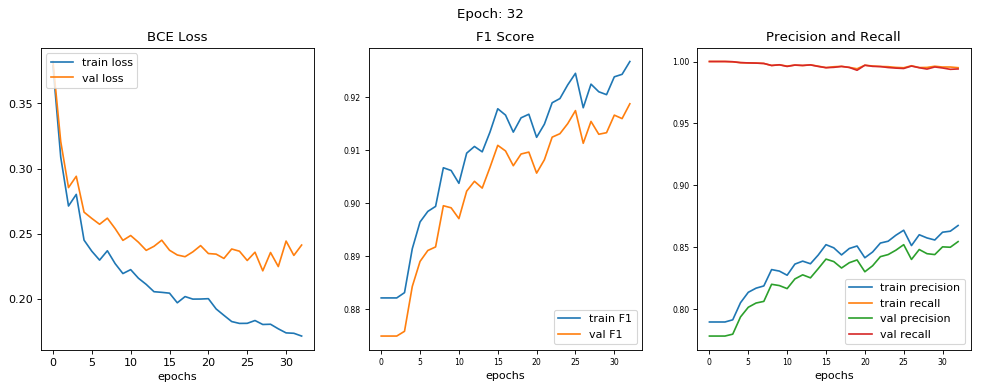

epoch [32/100] 
train loss = 0.1715, train f1 score = 0.9267 
train precision = 0.8674, train recall = 0.9950 

val loss = 0.2413, val f1 score = 0.9187 
val precision = 0.8544, val recall = 0.9940 




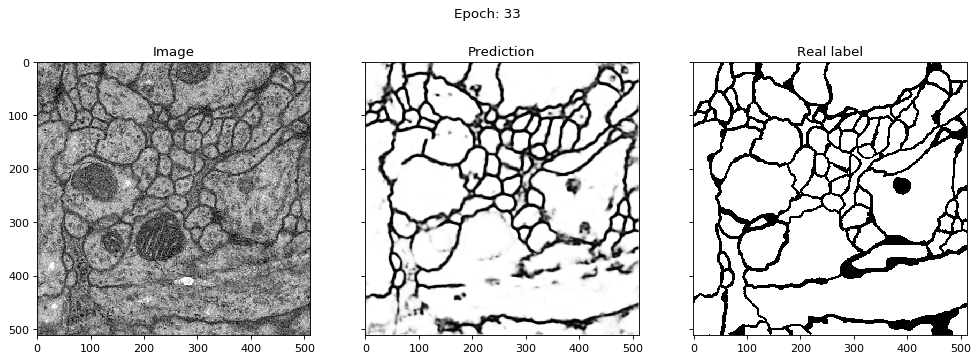

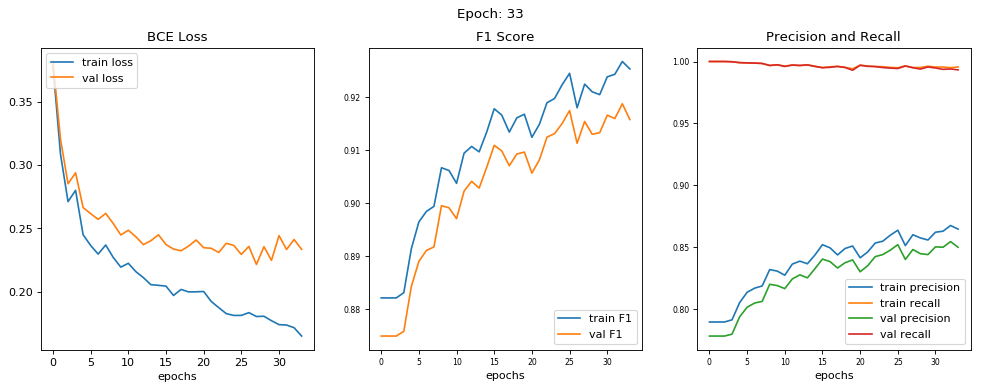

epoch [33/100] 
train loss = 0.1649, train f1 score = 0.9253 
train precision = 0.8645, train recall = 0.9956 

val loss = 0.2335, val f1 score = 0.9158 
val precision = 0.8499, val recall = 0.9933 




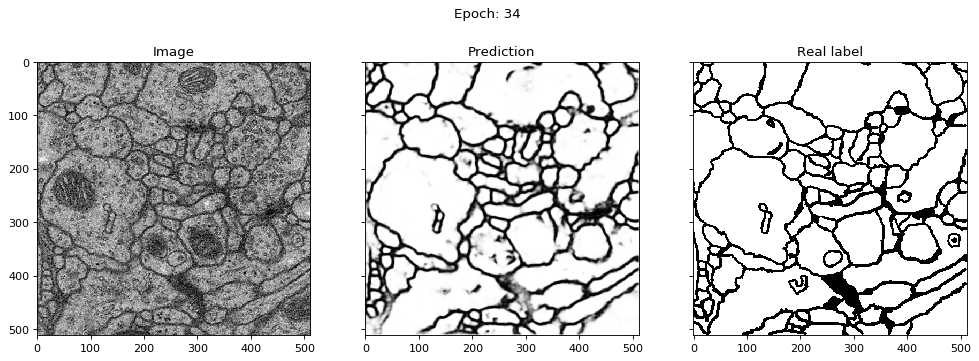

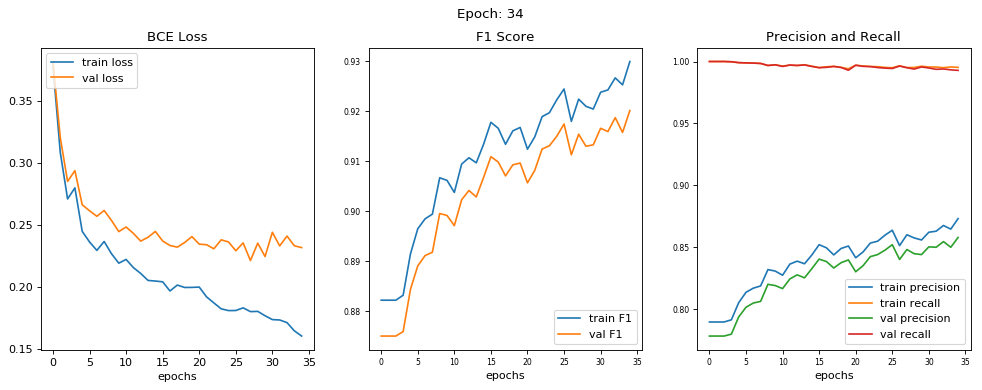

epoch [34/100] 
train loss = 0.1607, train f1 score = 0.9300 
train precision = 0.8730, train recall = 0.9953 

val loss = 0.2320, val f1 score = 0.9201 
val precision = 0.8578, val recall = 0.9928 




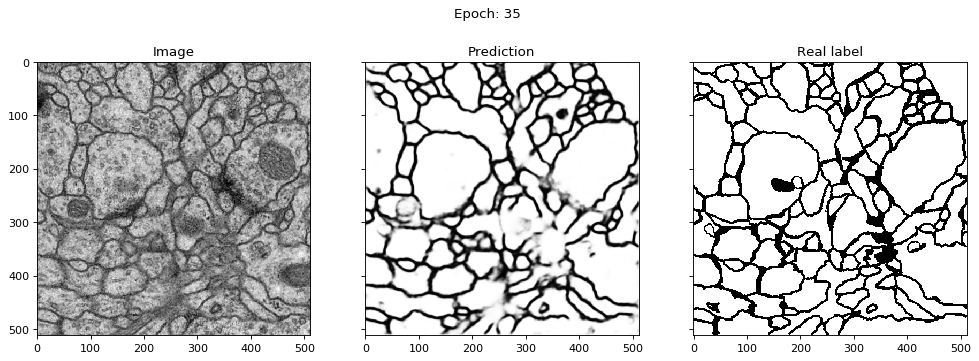

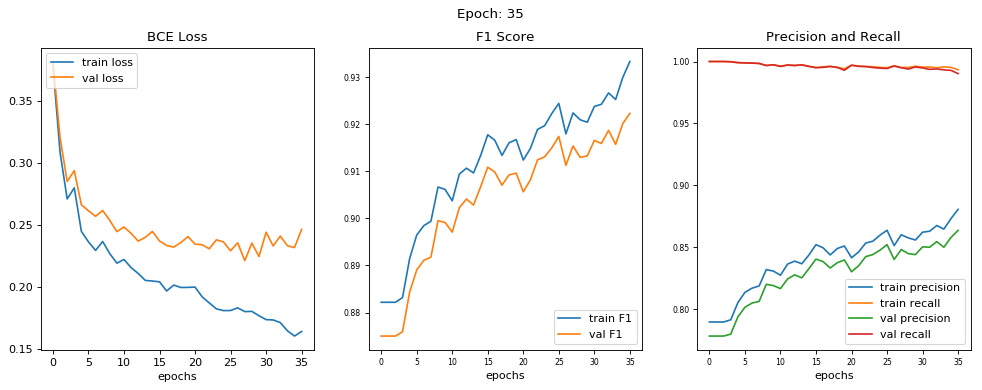

epoch [35/100] 
train loss = 0.1644, train f1 score = 0.9334 
train precision = 0.8805, train recall = 0.9933 

val loss = 0.2467, val f1 score = 0.9223 
val precision = 0.8635, val recall = 0.9902 




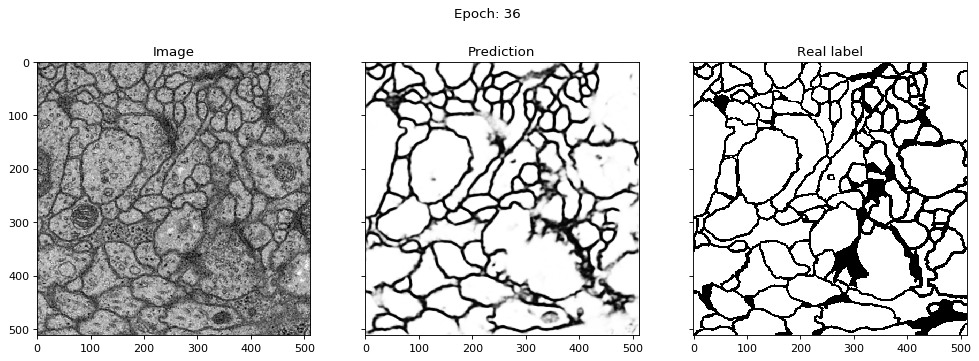

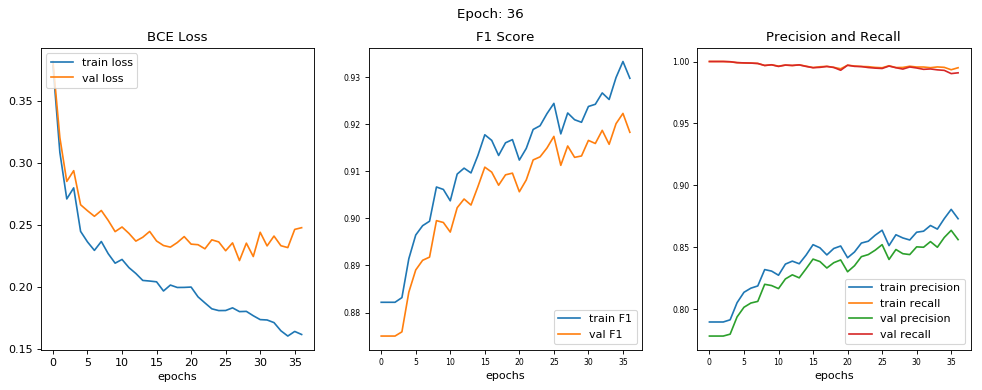

epoch [36/100] 
train loss = 0.1619, train f1 score = 0.9298 
train precision = 0.8729, train recall = 0.9950 

val loss = 0.2480, val f1 score = 0.9183 
val precision = 0.8561, val recall = 0.9909 




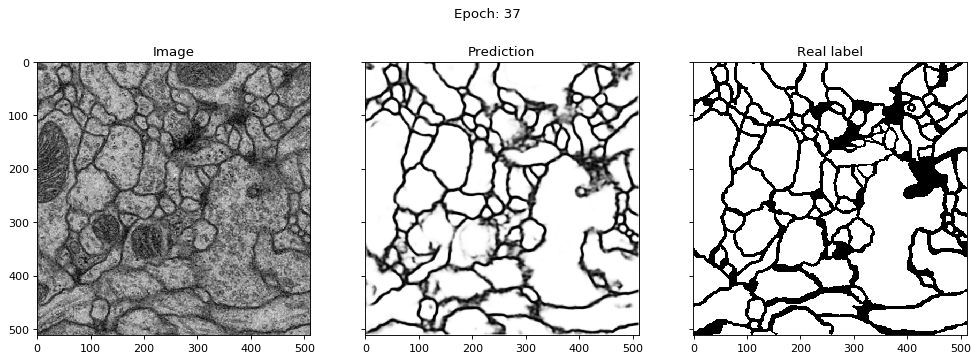

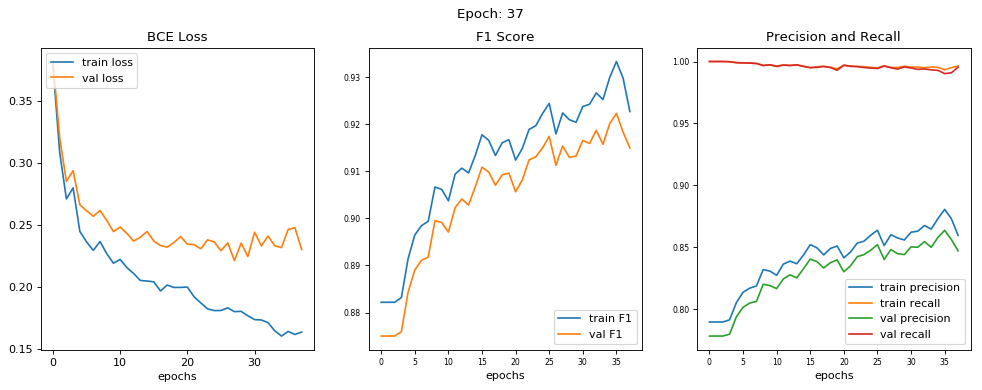

epoch [37/100] 
train loss = 0.1639, train f1 score = 0.9227 
train precision = 0.8595, train recall = 0.9964 

val loss = 0.2304, val f1 score = 0.9150 
val precision = 0.8470, val recall = 0.9954 




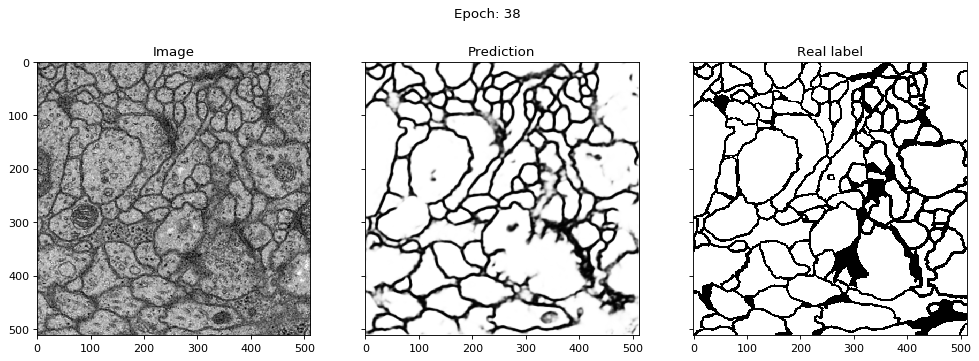

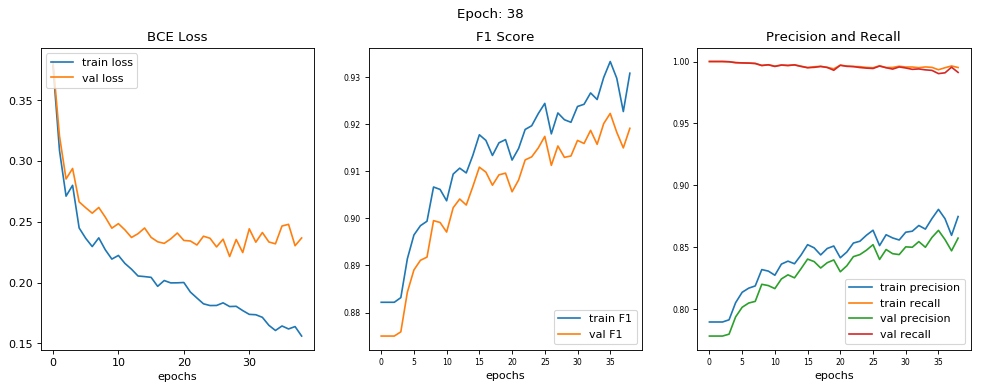

epoch [38/100] 
train loss = 0.1561, train f1 score = 0.9309 
train precision = 0.8747, train recall = 0.9951 

val loss = 0.2368, val f1 score = 0.9192 
val precision = 0.8573, val recall = 0.9912 




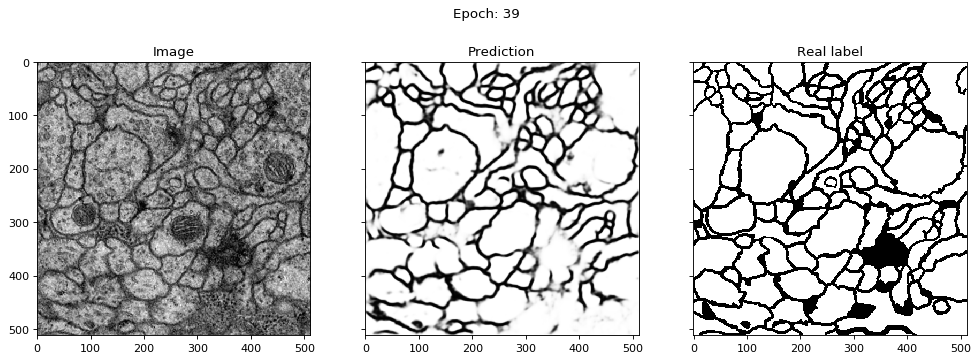

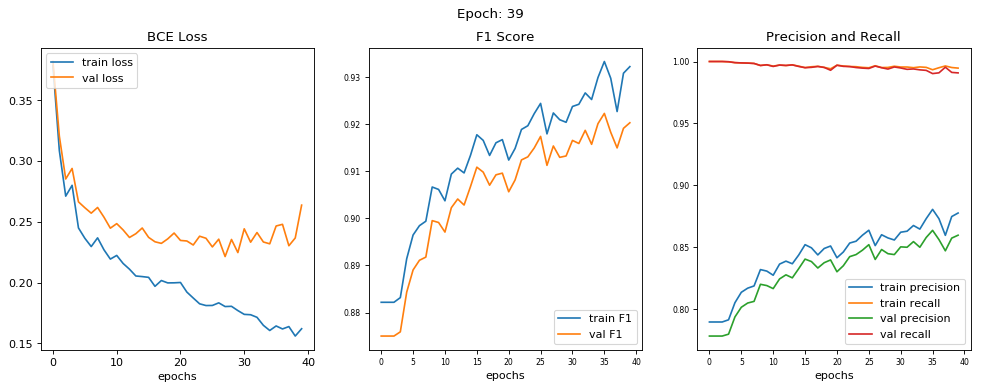

epoch [39/100] 
train loss = 0.1621, train f1 score = 0.9323 
train precision = 0.8775, train recall = 0.9947 

val loss = 0.2638, val f1 score = 0.9203 
val precision = 0.8596, val recall = 0.9908 




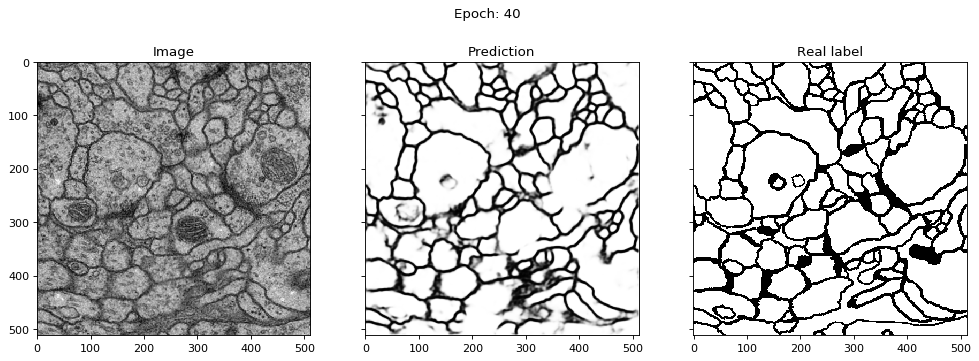

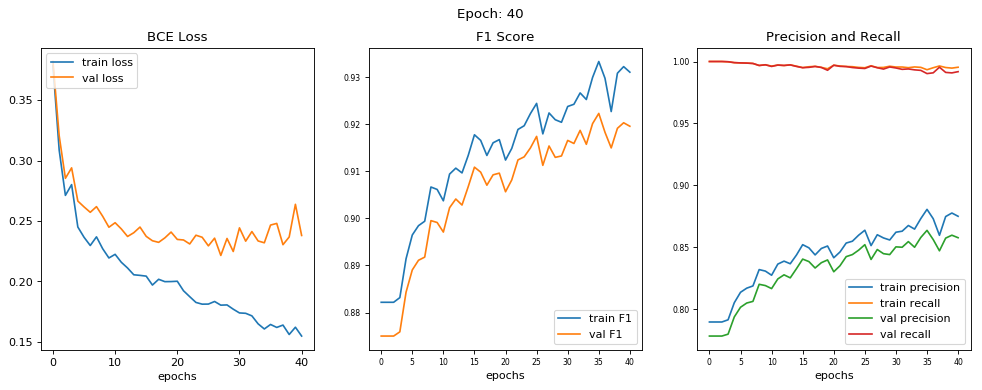

epoch [40/100] 
train loss = 0.1548, train f1 score = 0.9311 
train precision = 0.8749, train recall = 0.9954 

val loss = 0.2381, val f1 score = 0.9196 
val precision = 0.8576, val recall = 0.9918 




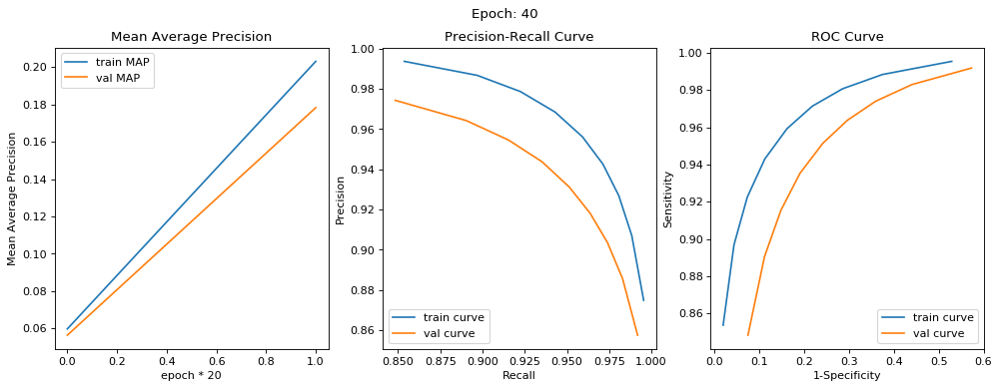

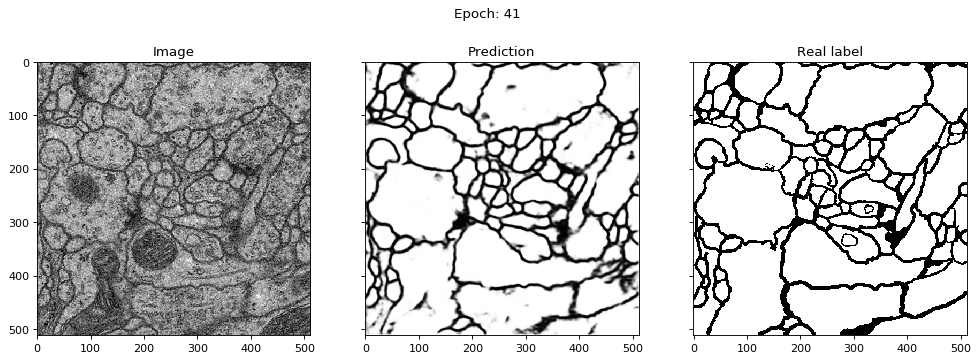

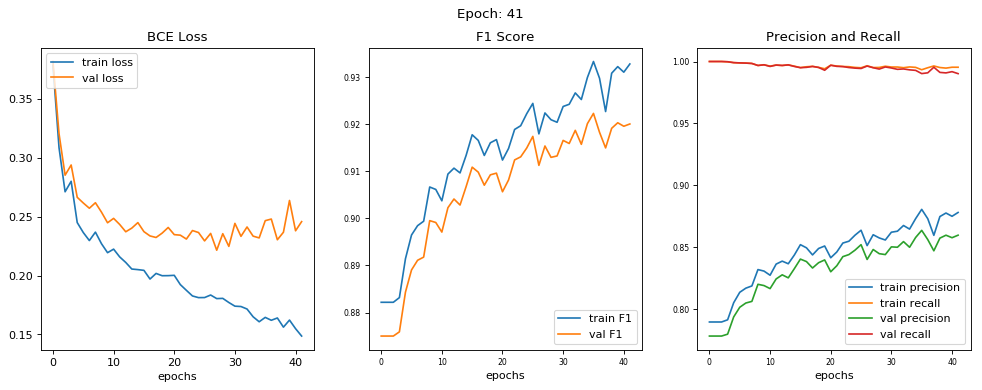

epoch [41/100] 
train loss = 0.1485, train f1 score = 0.9328 
train precision = 0.8780, train recall = 0.9954 

val loss = 0.2459, val f1 score = 0.9201 
val precision = 0.8596, val recall = 0.9902 




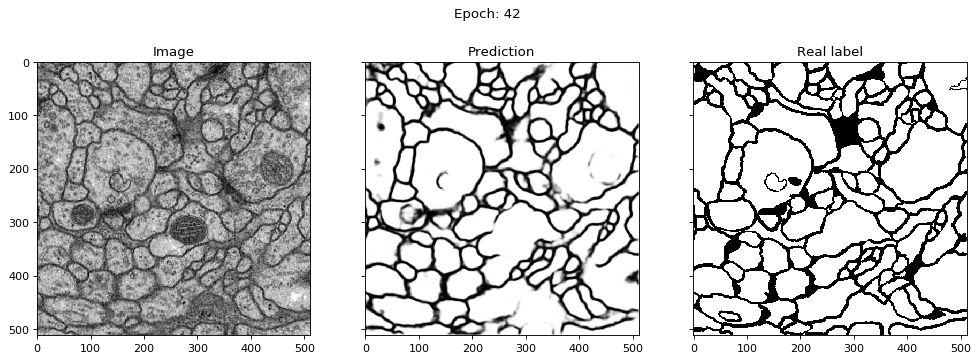

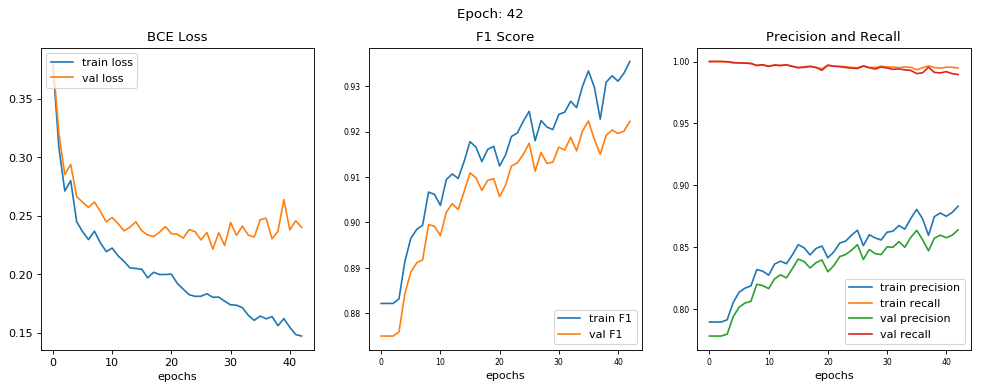

epoch [42/100] 
train loss = 0.1472, train f1 score = 0.9354 
train precision = 0.8830, train recall = 0.9948 

val loss = 0.2402, val f1 score = 0.9222 
val precision = 0.8639, val recall = 0.9895 




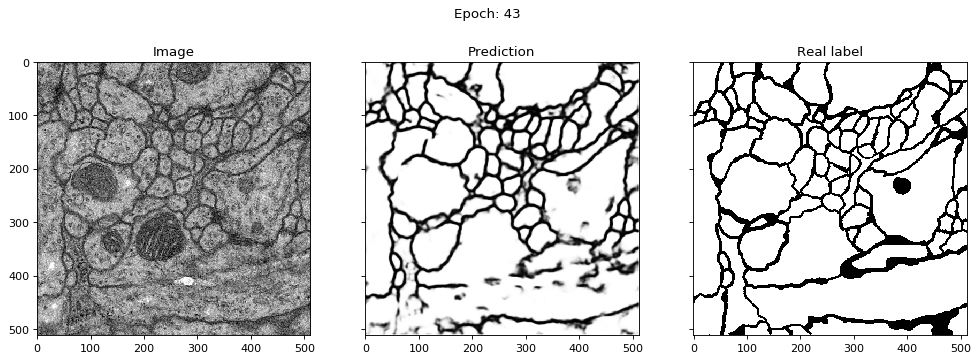

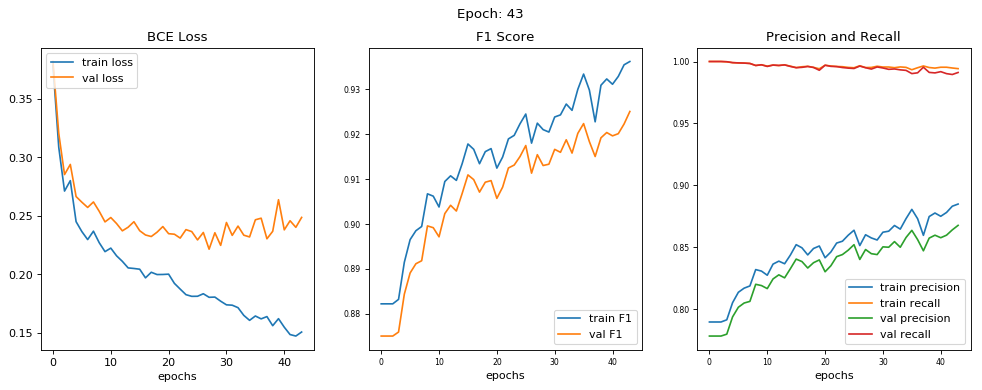

epoch [43/100] 
train loss = 0.1507, train f1 score = 0.9362 
train precision = 0.8848, train recall = 0.9942 

val loss = 0.2487, val f1 score = 0.9250 
val precision = 0.8676, val recall = 0.9911 




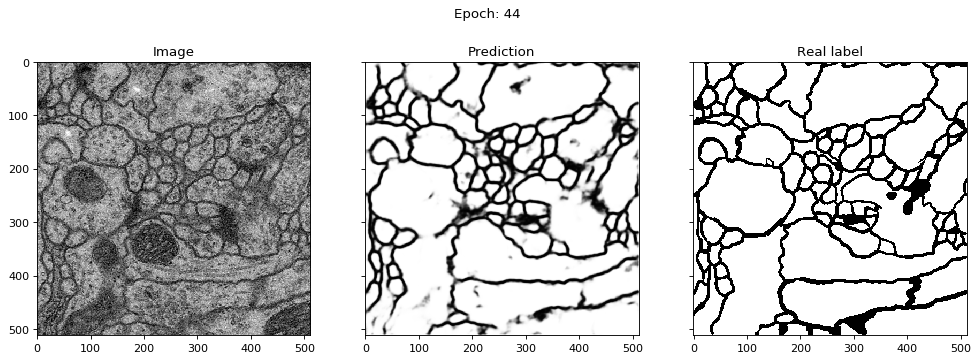

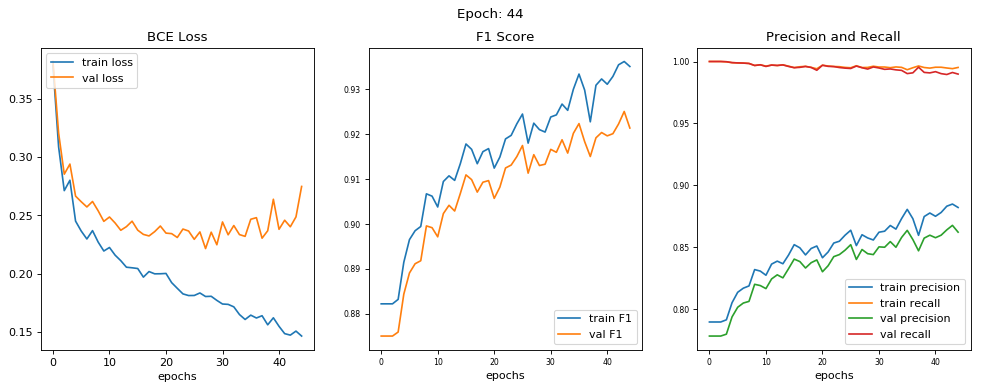

epoch [44/100] 
train loss = 0.1464, train f1 score = 0.9350 
train precision = 0.8820, train recall = 0.9952 

val loss = 0.2748, val f1 score = 0.9213 
val precision = 0.8621, val recall = 0.9898 




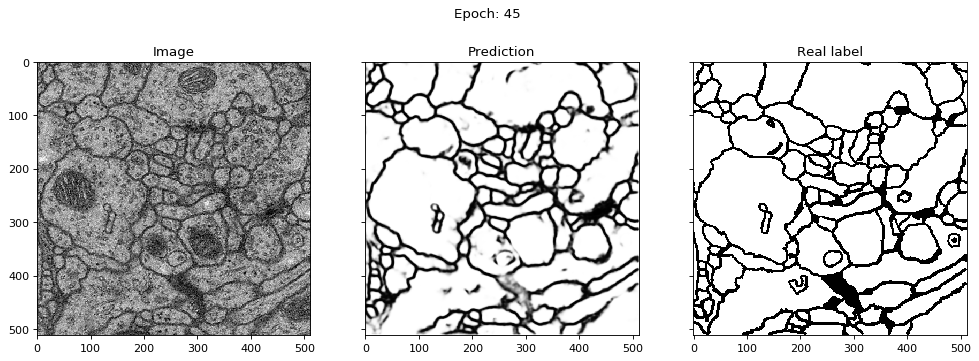

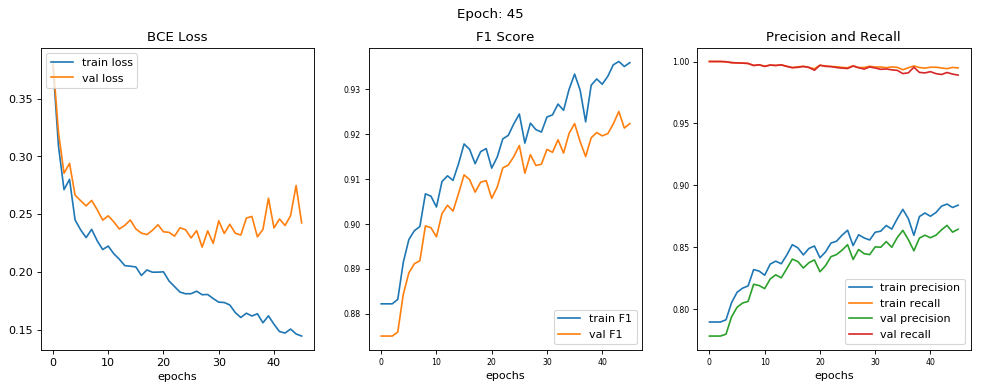

epoch [45/100] 
train loss = 0.1446, train f1 score = 0.9359 
train precision = 0.8839, train recall = 0.9948 

val loss = 0.2425, val f1 score = 0.9223 
val precision = 0.8644, val recall = 0.9890 




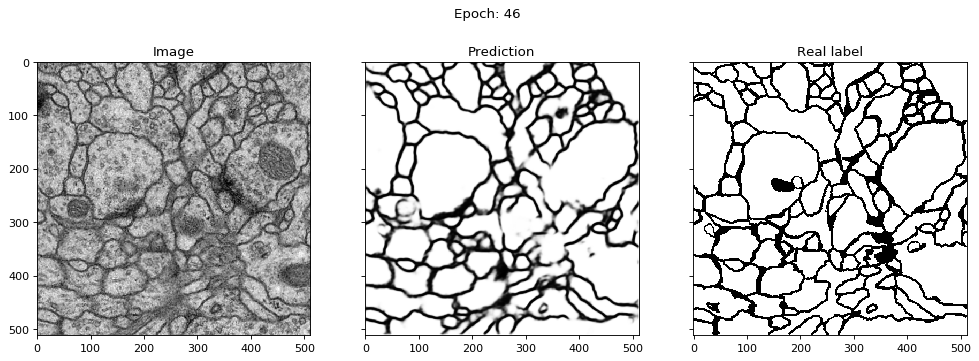

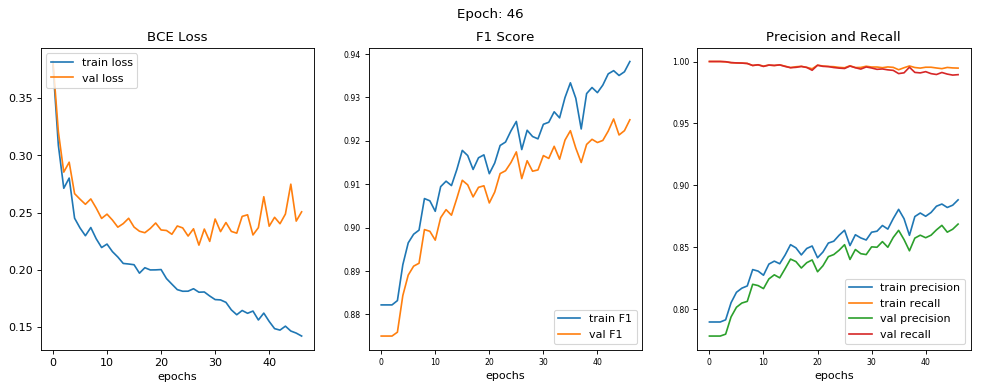

epoch [46/100] 
train loss = 0.1420, train f1 score = 0.9383 
train precision = 0.8882, train recall = 0.9947 

val loss = 0.2506, val f1 score = 0.9248 
val precision = 0.8686, val recall = 0.9894 




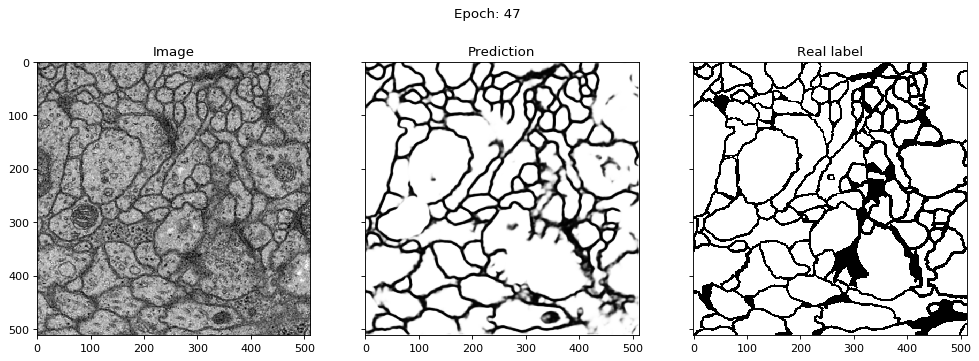

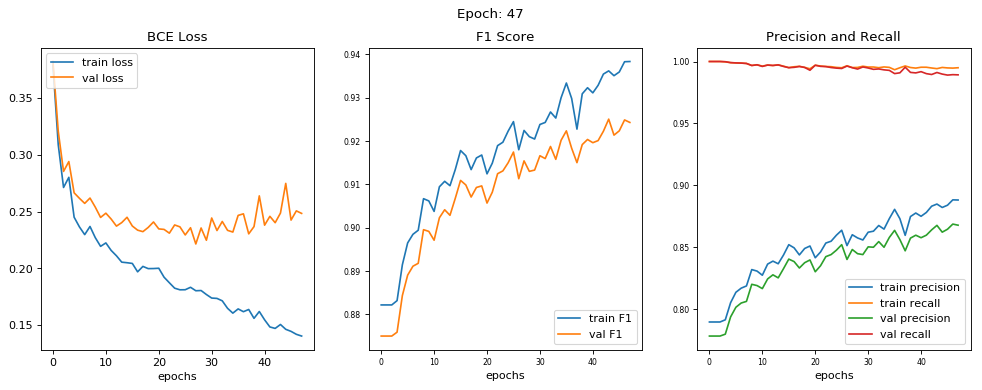

epoch [47/100] 
train loss = 0.1405, train f1 score = 0.9383 
train precision = 0.8880, train recall = 0.9950 

val loss = 0.2484, val f1 score = 0.9243 
val precision = 0.8677, val recall = 0.9892 




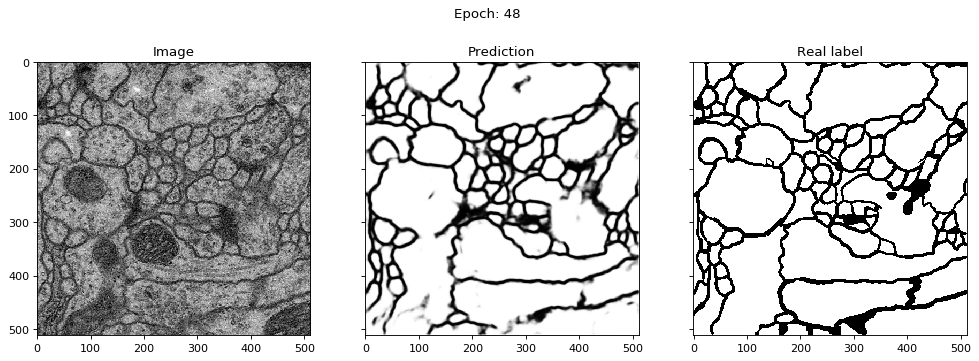

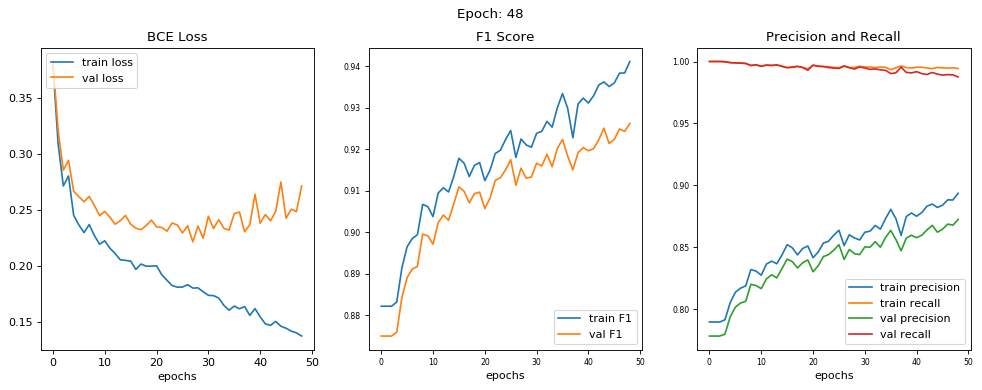

epoch [48/100] 
train loss = 0.1377, train f1 score = 0.9411 
train precision = 0.8935, train recall = 0.9943 

val loss = 0.2713, val f1 score = 0.9262 
val precision = 0.8723, val recall = 0.9875 




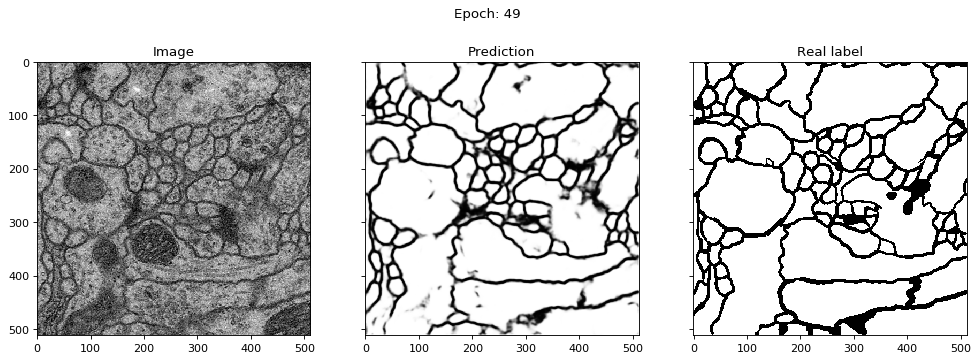

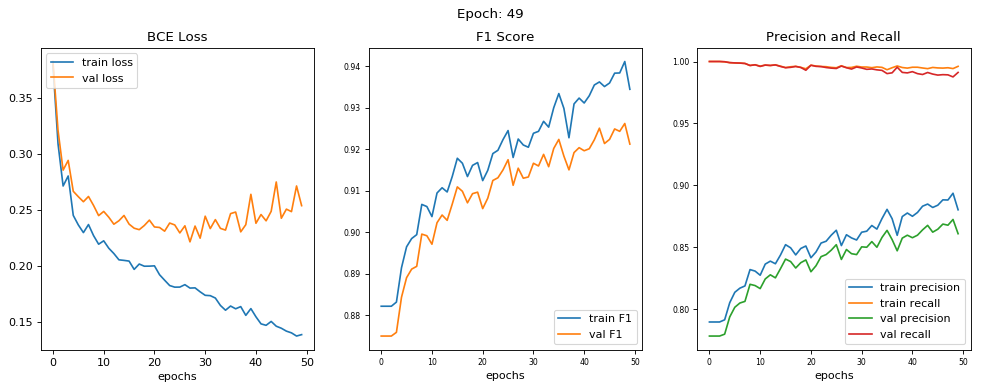

epoch [49/100] 
train loss = 0.1389, train f1 score = 0.9344 
train precision = 0.8801, train recall = 0.9961 

val loss = 0.2537, val f1 score = 0.9212 
val precision = 0.8608, val recall = 0.9912 




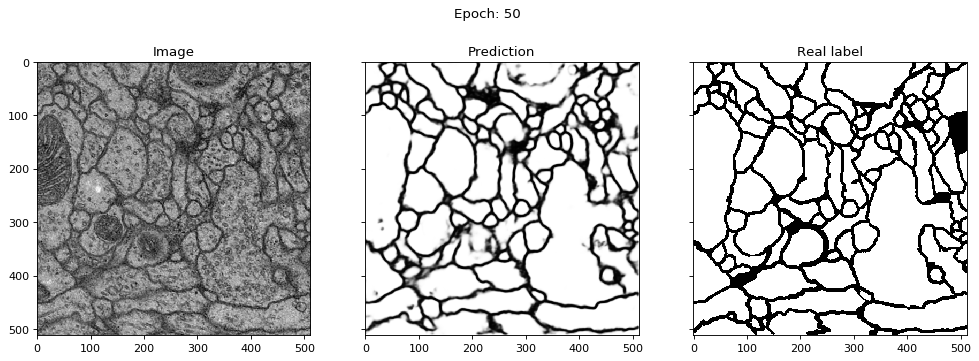

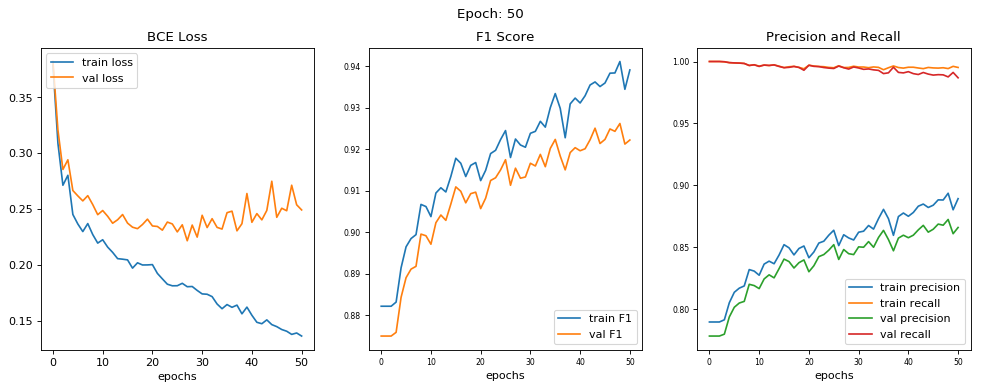

epoch [50/100] 
train loss = 0.1362, train f1 score = 0.9390 
train precision = 0.8892, train recall = 0.9952 

val loss = 0.2491, val f1 score = 0.9222 
val precision = 0.8659, val recall = 0.9868 




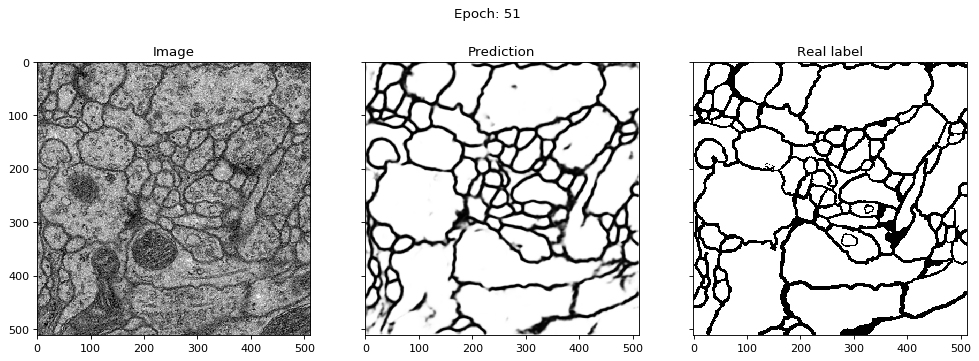

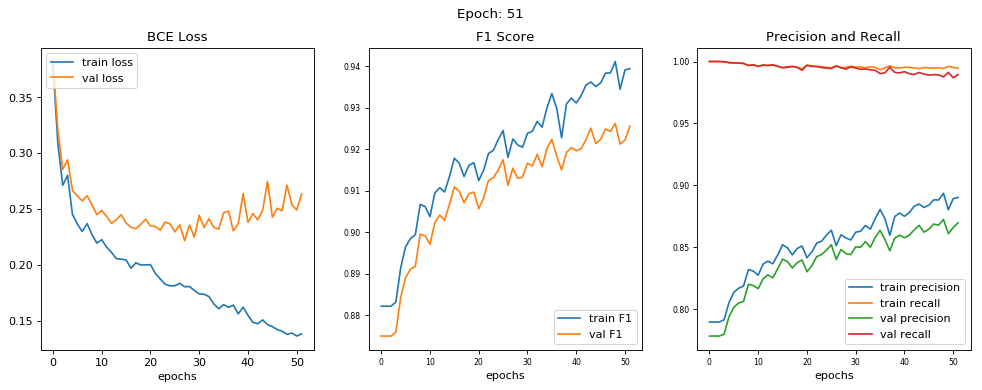

epoch [51/100] 
train loss = 0.1381, train f1 score = 0.9393 
train precision = 0.8901, train recall = 0.9946 

val loss = 0.2635, val f1 score = 0.9255 
val precision = 0.8697, val recall = 0.9895 




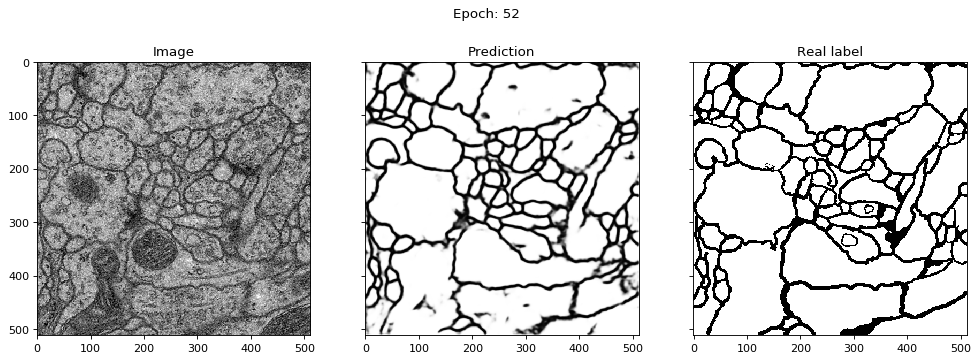

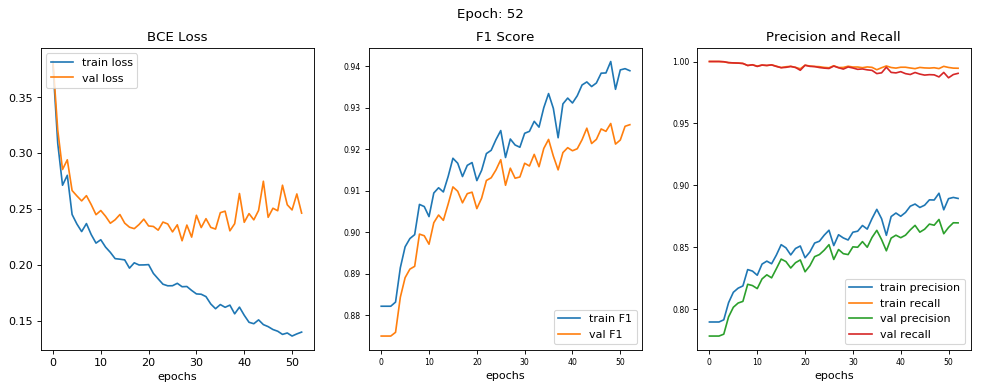

epoch [52/100] 
train loss = 0.1397, train f1 score = 0.9389 
train precision = 0.8893, train recall = 0.9946 

val loss = 0.2463, val f1 score = 0.9259 
val precision = 0.8696, val recall = 0.9904 




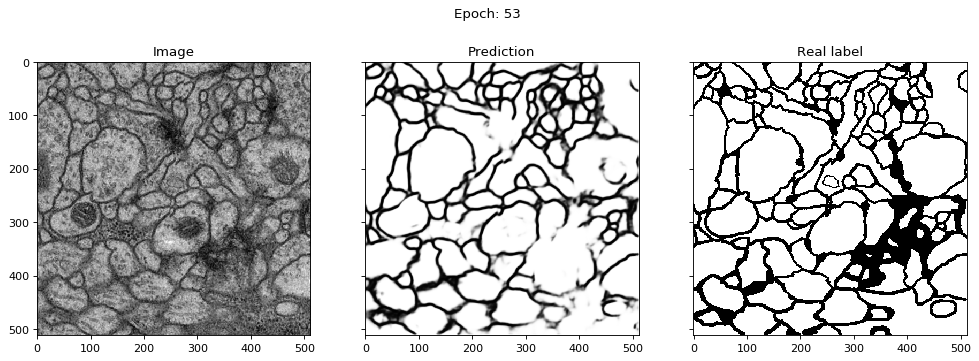

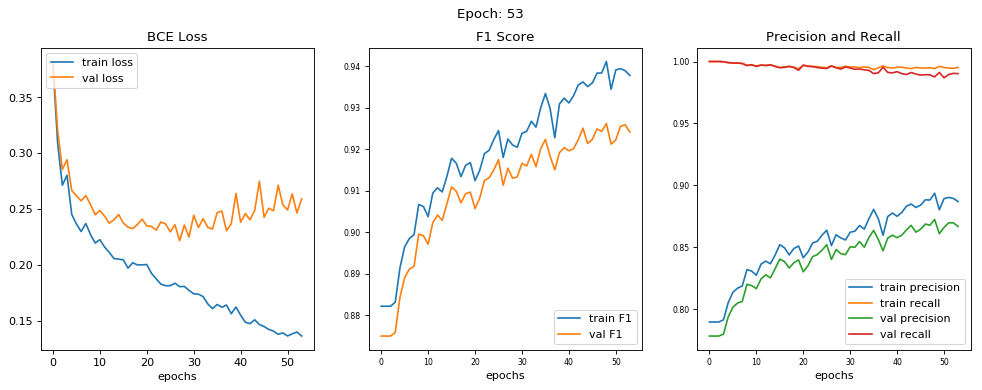

epoch [53/100] 
train loss = 0.1361, train f1 score = 0.9377 
train precision = 0.8868, train recall = 0.9952 

val loss = 0.2590, val f1 score = 0.9241 
val precision = 0.8666, val recall = 0.9902 




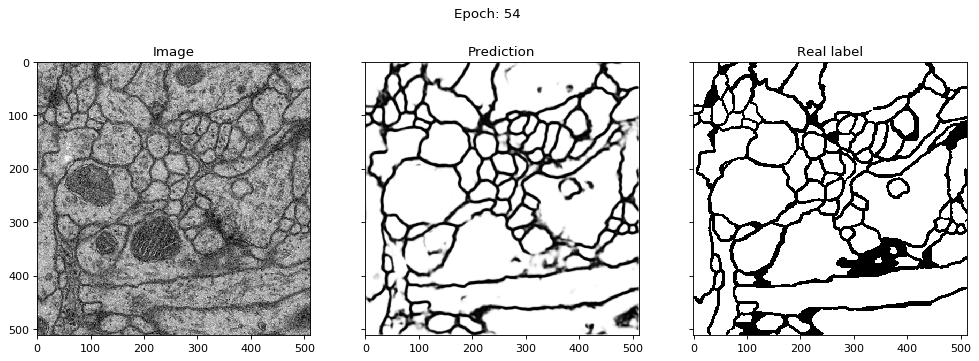

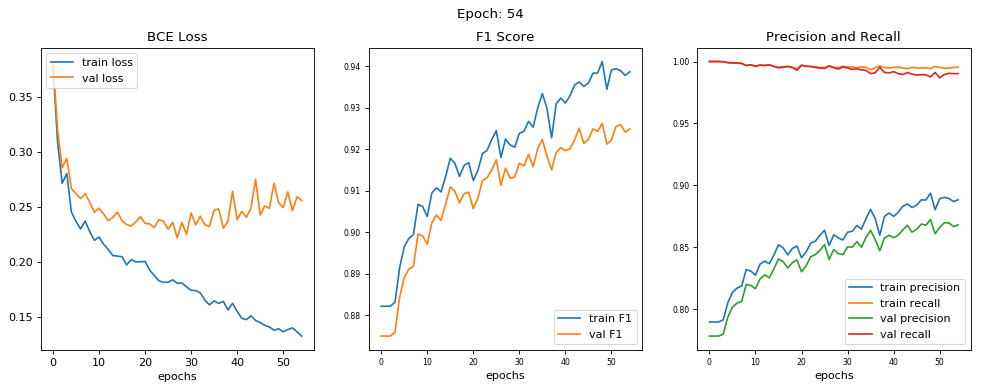

epoch [54/100] 
train loss = 0.1323, train f1 score = 0.9386 
train precision = 0.8882, train recall = 0.9954 

val loss = 0.2555, val f1 score = 0.9248 
val precision = 0.8679, val recall = 0.9902 




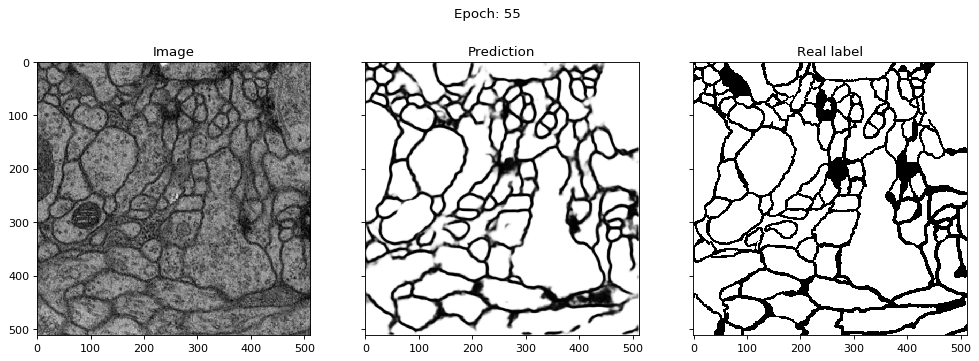

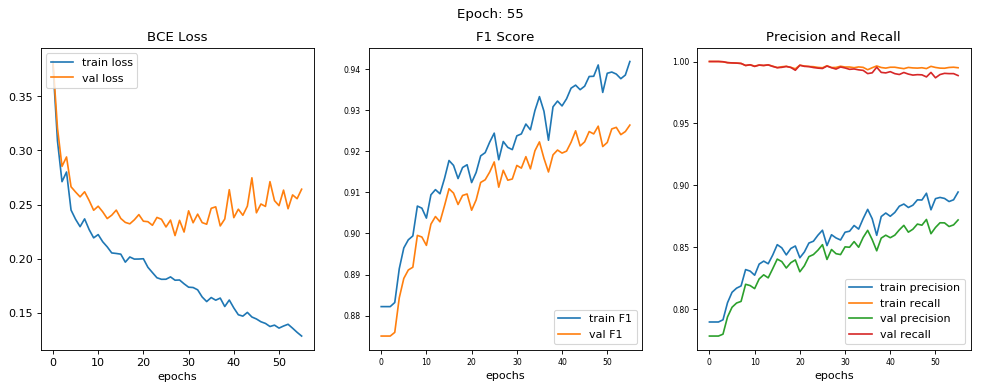

epoch [55/100] 
train loss = 0.1289, train f1 score = 0.9419 
train precision = 0.8945, train recall = 0.9950 

val loss = 0.2643, val f1 score = 0.9264 
val precision = 0.8719, val recall = 0.9886 




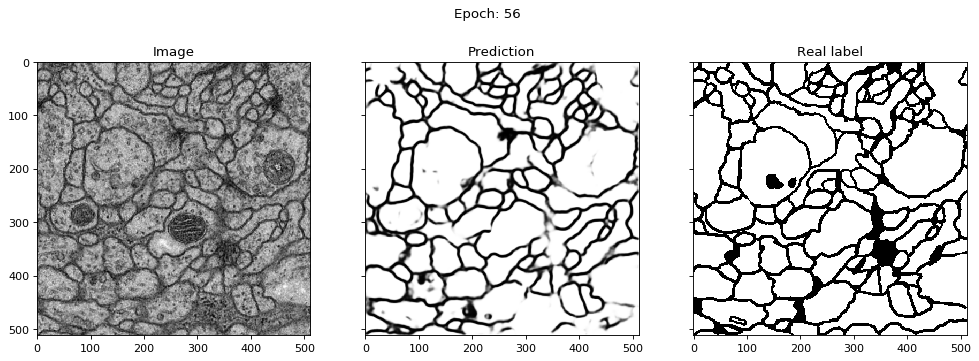

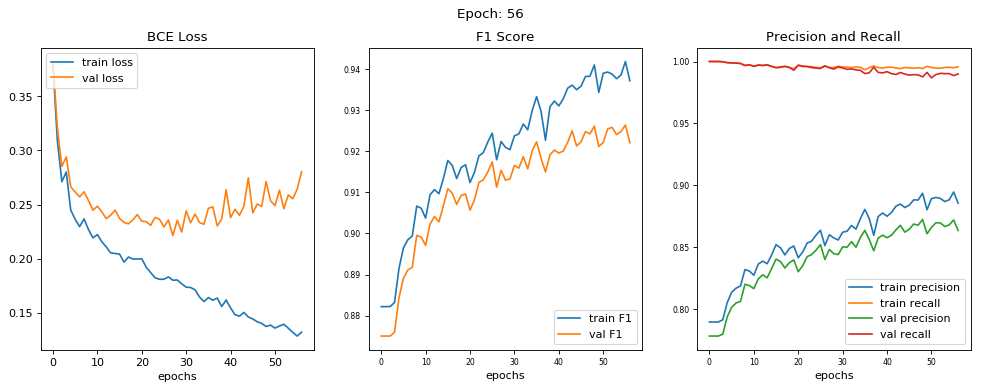

epoch [56/100] 
train loss = 0.1325, train f1 score = 0.9372 
train precision = 0.8855, train recall = 0.9957 

val loss = 0.2805, val f1 score = 0.9221 
val precision = 0.8634, val recall = 0.9899 




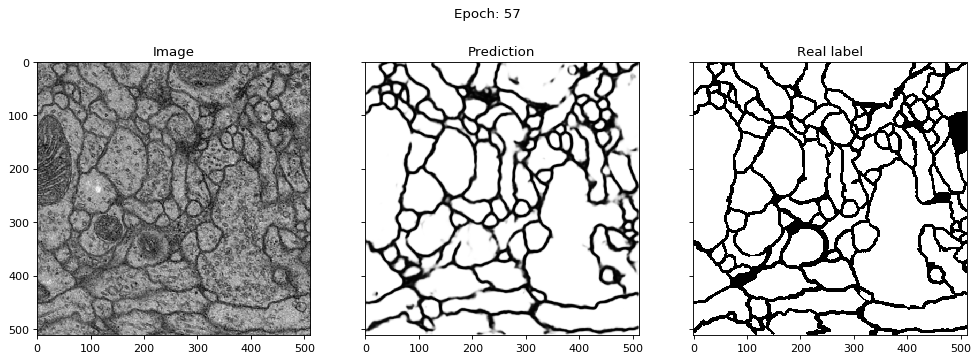

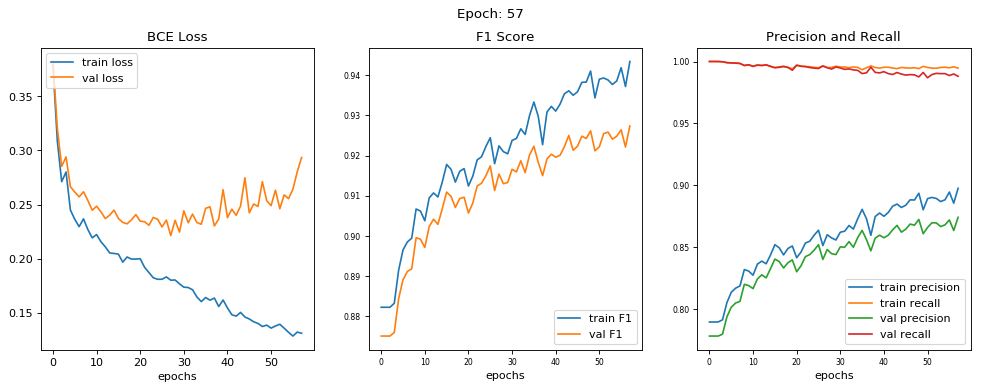

epoch [57/100] 
train loss = 0.1315, train f1 score = 0.9435 
train precision = 0.8975, train recall = 0.9947 

val loss = 0.2936, val f1 score = 0.9274 
val precision = 0.8741, val recall = 0.9881 




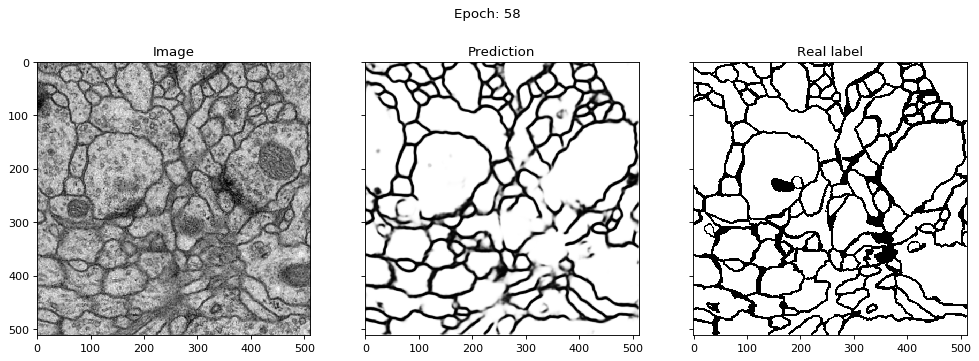

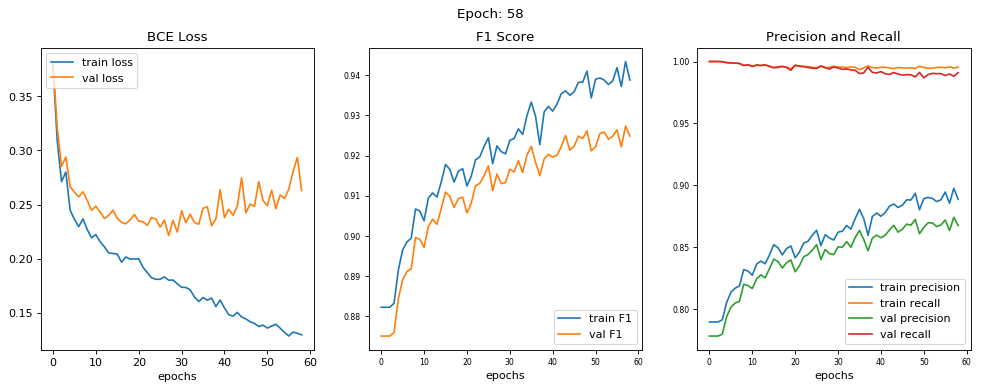

epoch [58/100] 
train loss = 0.1299, train f1 score = 0.9388 
train precision = 0.8886, train recall = 0.9955 

val loss = 0.2631, val f1 score = 0.9249 
val precision = 0.8674, val recall = 0.9910 




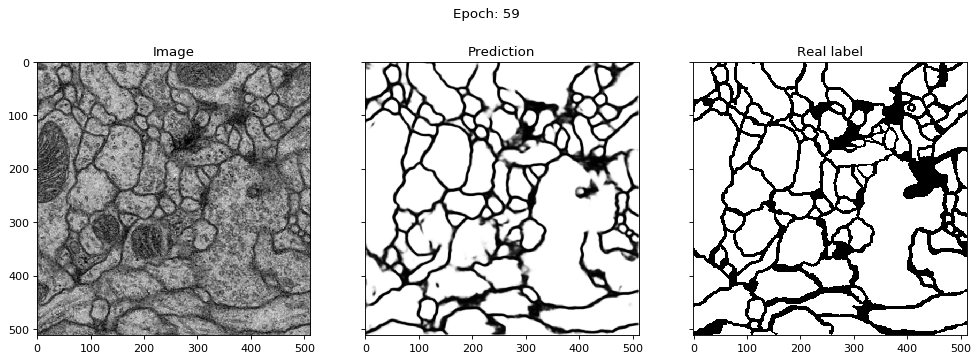

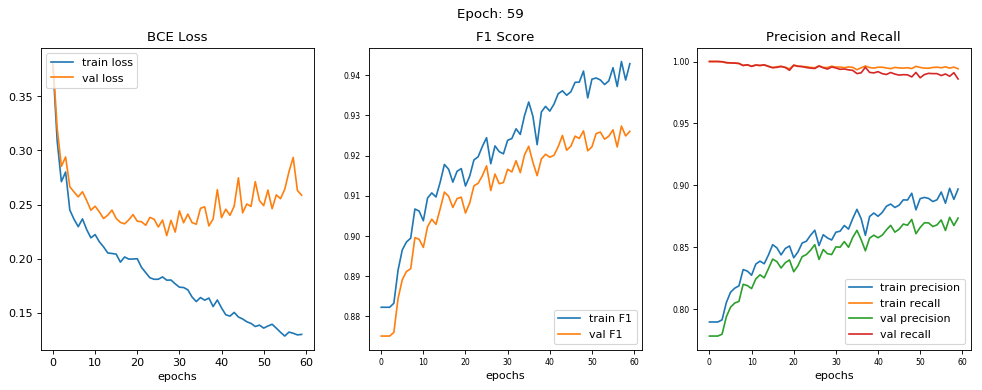

epoch [59/100] 
train loss = 0.1304, train f1 score = 0.9429 
train precision = 0.8969, train recall = 0.9942 

val loss = 0.2588, val f1 score = 0.9261 
val precision = 0.8734, val recall = 0.9859 




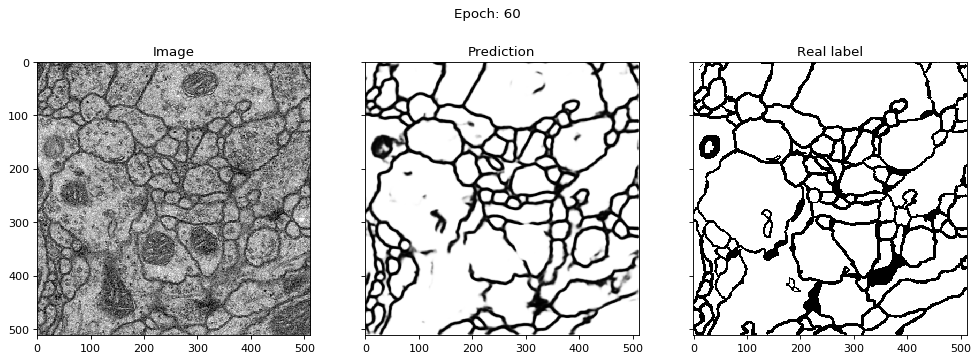

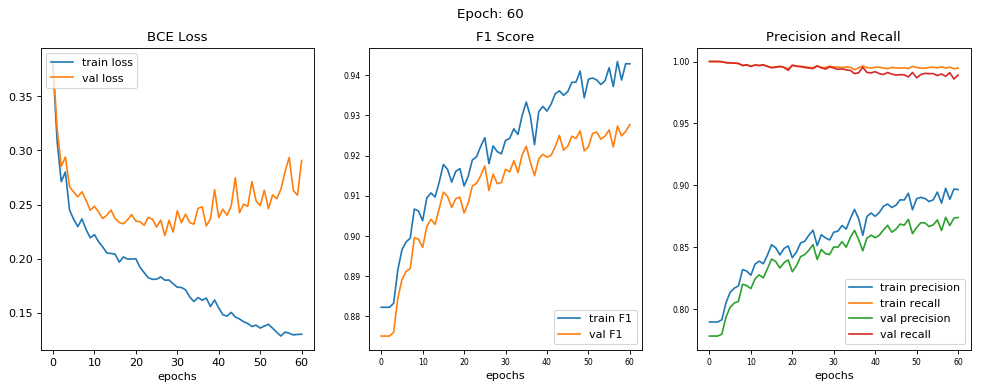

epoch [60/100] 
train loss = 0.1305, train f1 score = 0.9429 
train precision = 0.8965, train recall = 0.9947 

val loss = 0.2907, val f1 score = 0.9277 
val precision = 0.8739, val recall = 0.9891 




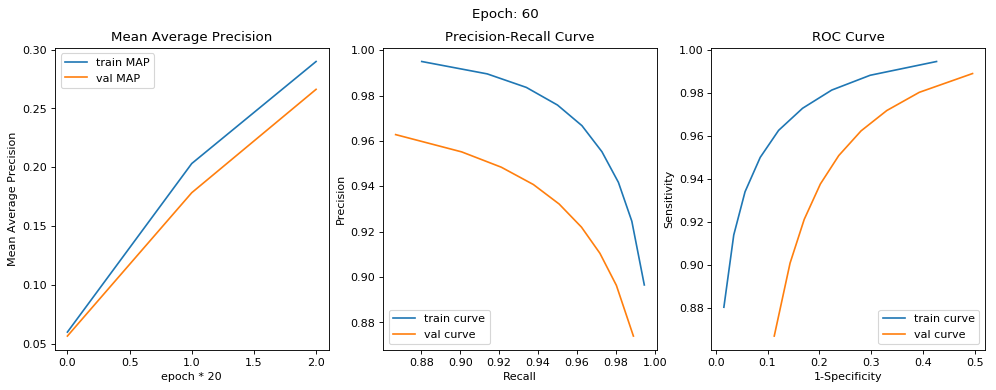

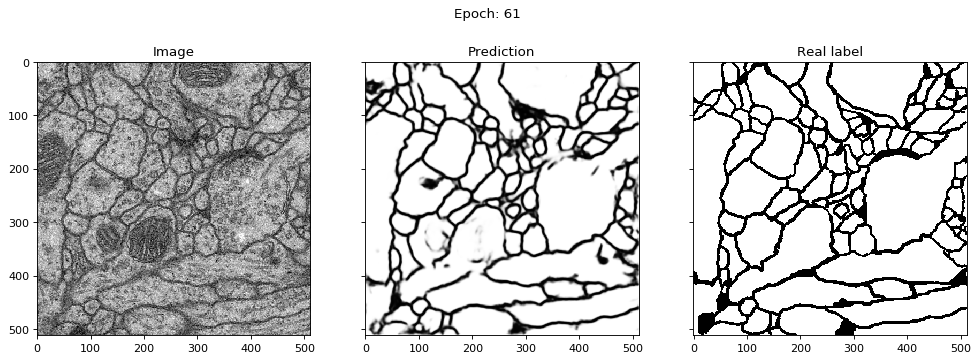

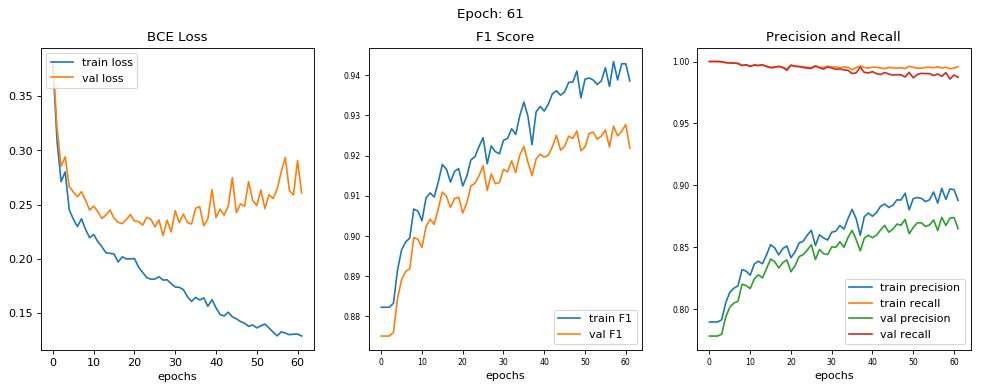

epoch [61/100] 
train loss = 0.1287, train f1 score = 0.9386 
train precision = 0.8877, train recall = 0.9959 

val loss = 0.2608, val f1 score = 0.9218 
val precision = 0.8649, val recall = 0.9873 




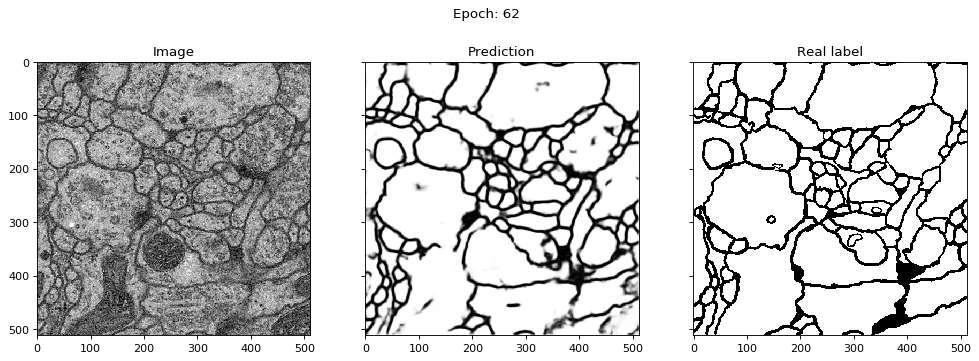

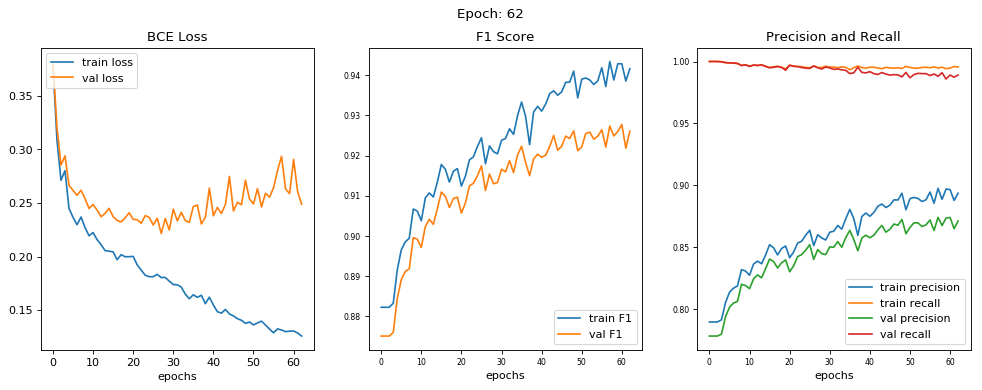

epoch [62/100] 
train loss = 0.1258, train f1 score = 0.9417 
train precision = 0.8935, train recall = 0.9956 

val loss = 0.2488, val f1 score = 0.9261 
val precision = 0.8711, val recall = 0.9890 




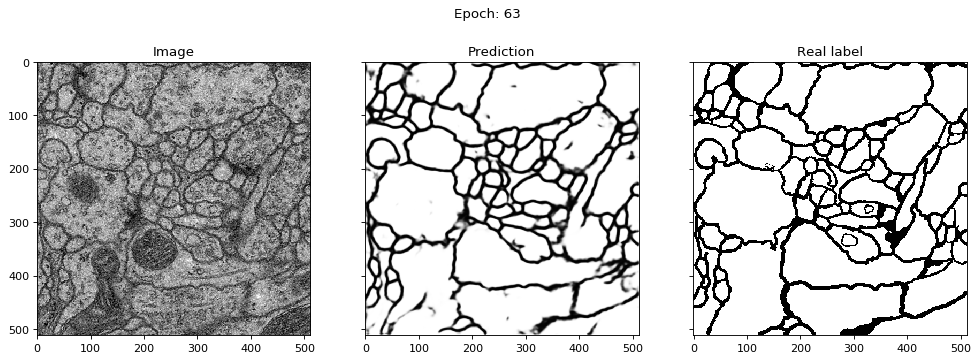

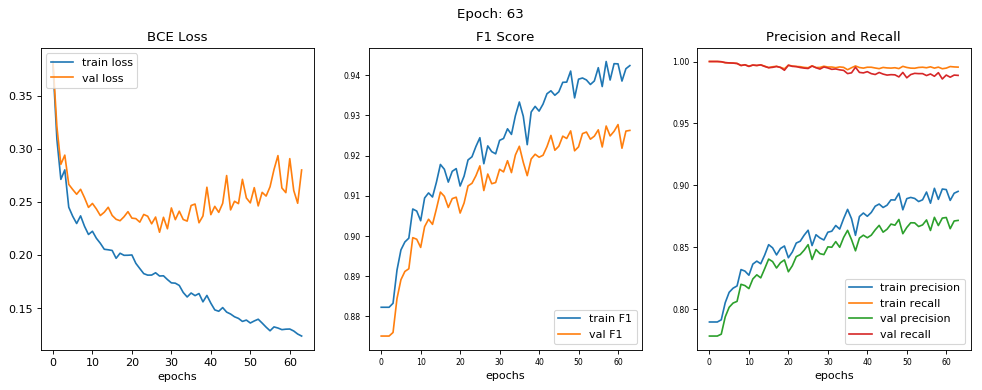

epoch [63/100] 
train loss = 0.1239, train f1 score = 0.9424 
train precision = 0.8950, train recall = 0.9955 

val loss = 0.2801, val f1 score = 0.9263 
val precision = 0.8716, val recall = 0.9888 




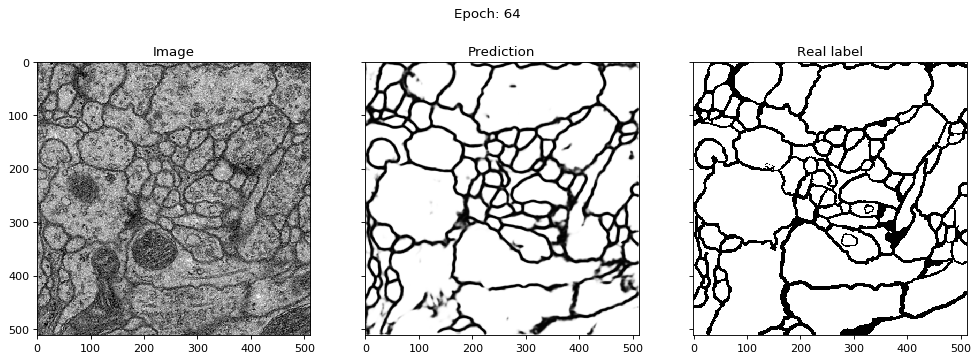

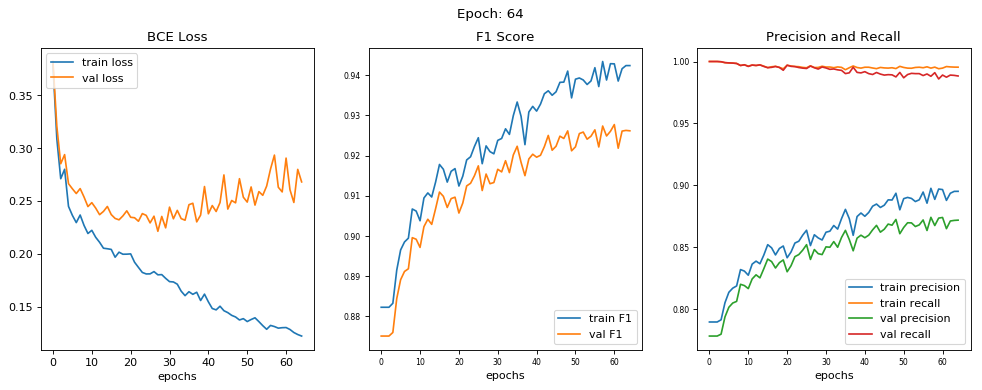

epoch [64/100] 
train loss = 0.1225, train f1 score = 0.9424 
train precision = 0.8951, train recall = 0.9954 

val loss = 0.2682, val f1 score = 0.9262 
val precision = 0.8718, val recall = 0.9883 




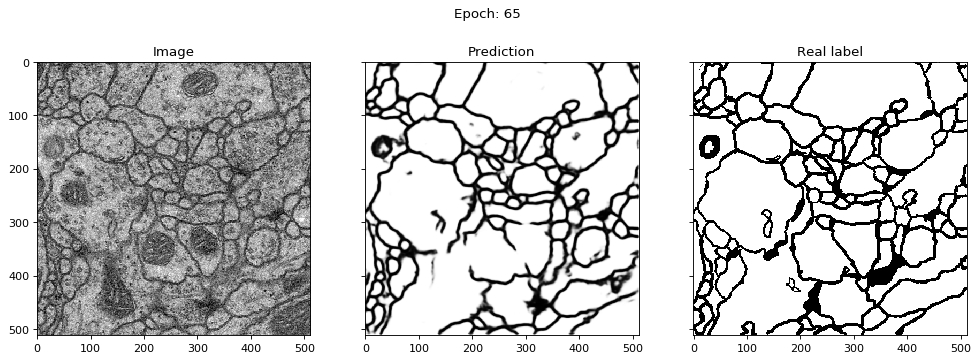

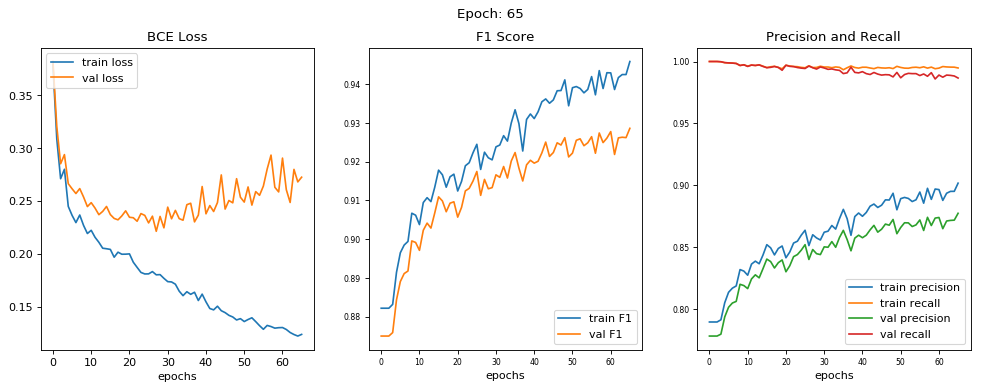

epoch [65/100] 
train loss = 0.1240, train f1 score = 0.9458 
train precision = 0.9017, train recall = 0.9948 

val loss = 0.2727, val f1 score = 0.9286 
val precision = 0.8773, val recall = 0.9866 




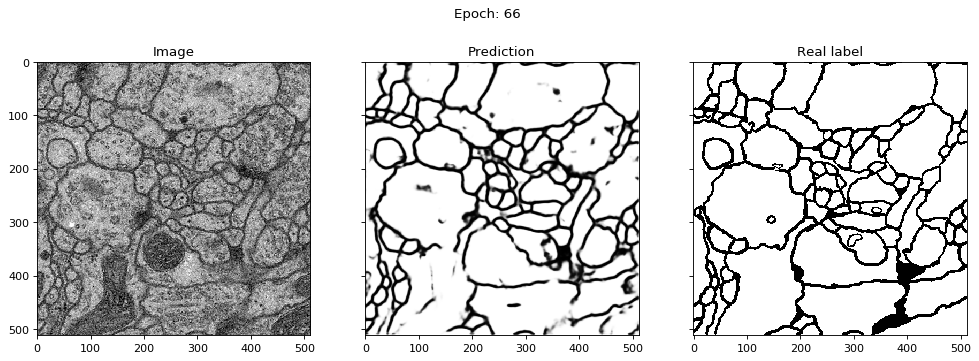

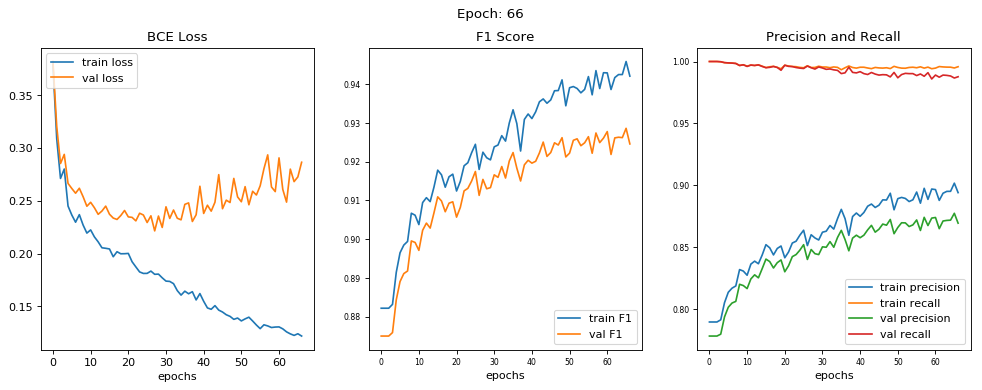

epoch [66/100] 
train loss = 0.1218, train f1 score = 0.9420 
train precision = 0.8940, train recall = 0.9958 

val loss = 0.2866, val f1 score = 0.9245 
val precision = 0.8693, val recall = 0.9877 




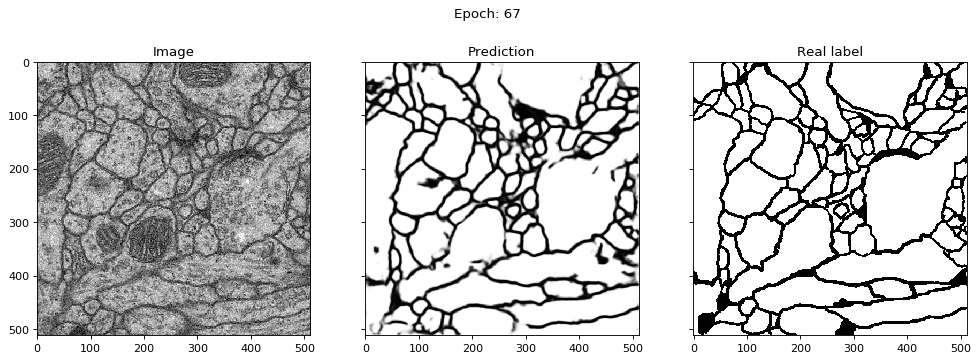

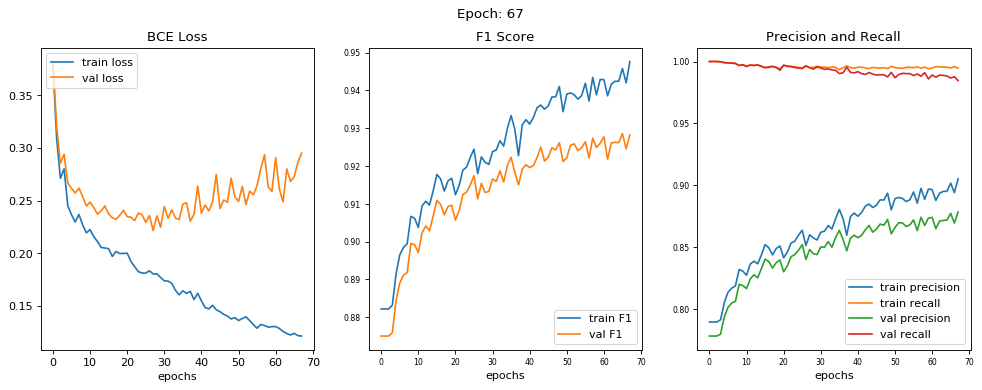

epoch [67/100] 
train loss = 0.1215, train f1 score = 0.9477 
train precision = 0.9051, train recall = 0.9947 

val loss = 0.2951, val f1 score = 0.9282 
val precision = 0.8784, val recall = 0.9845 




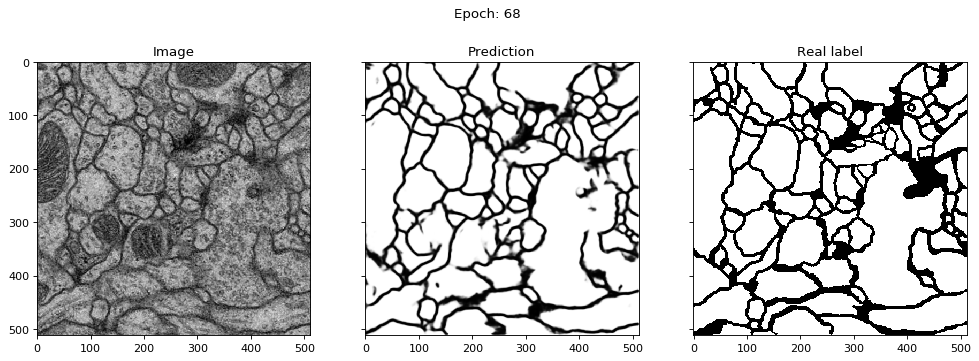

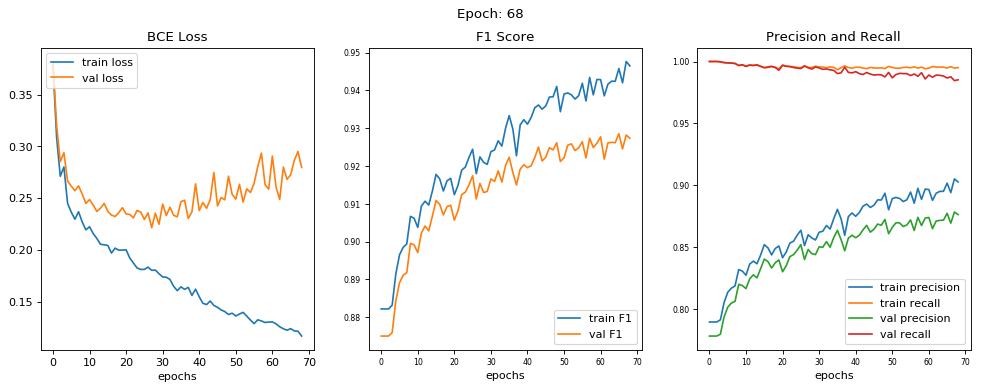

epoch [68/100] 
train loss = 0.1168, train f1 score = 0.9465 
train precision = 0.9027, train recall = 0.9951 

val loss = 0.2798, val f1 score = 0.9273 
val precision = 0.8763, val recall = 0.9852 




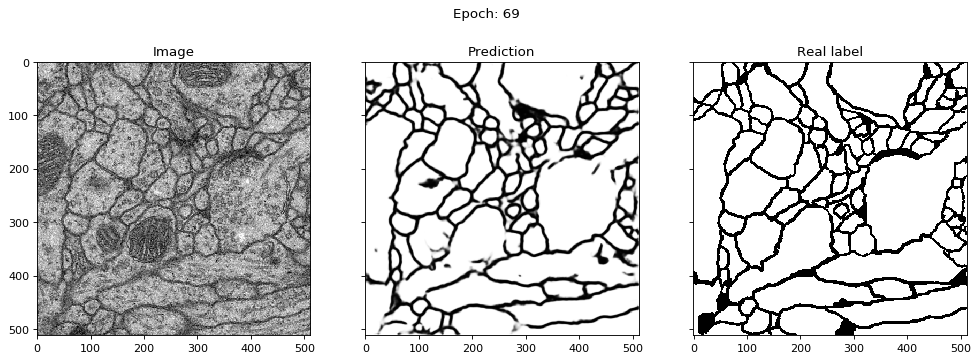

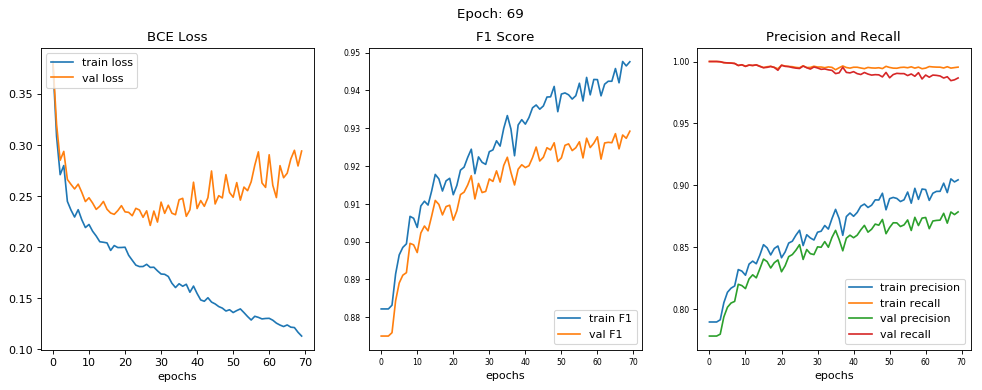

epoch [69/100] 
train loss = 0.1132, train f1 score = 0.9476 
train precision = 0.9044, train recall = 0.9955 

val loss = 0.2944, val f1 score = 0.9292 
val precision = 0.8784, val recall = 0.9867 




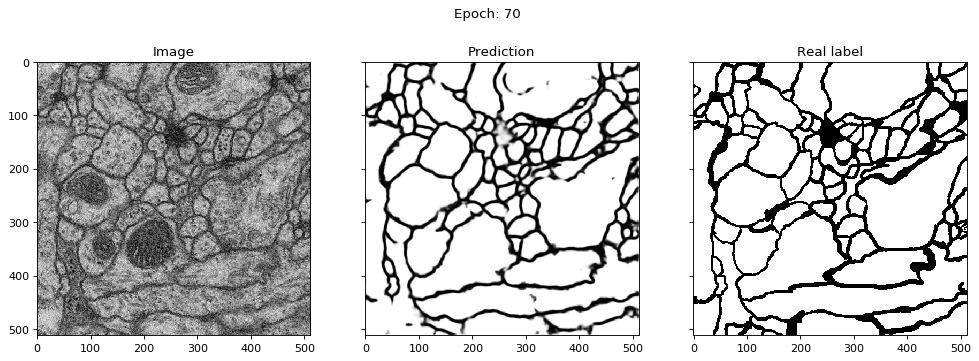

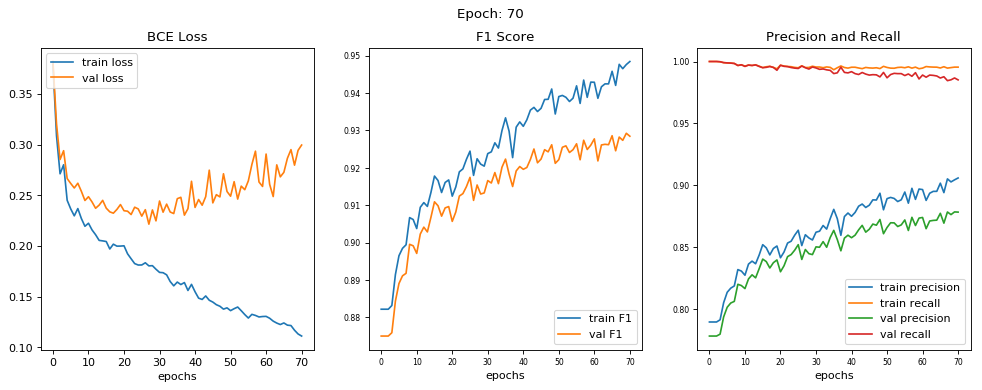

epoch [70/100] 
train loss = 0.1111, train f1 score = 0.9484 
train precision = 0.9059, train recall = 0.9954 

val loss = 0.2996, val f1 score = 0.9284 
val precision = 0.8783, val recall = 0.9851 




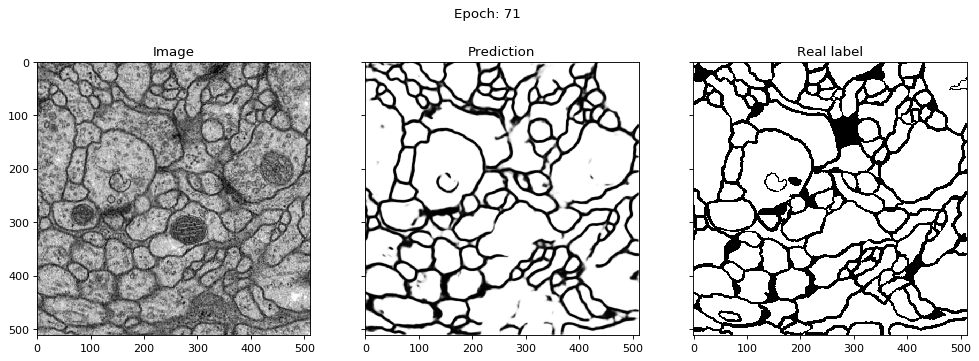

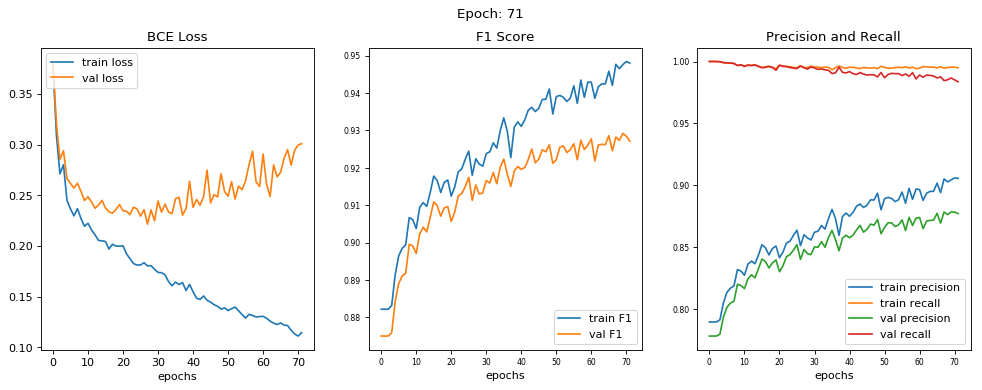

epoch [71/100] 
train loss = 0.1144, train f1 score = 0.9480 
train precision = 0.9055, train recall = 0.9949 

val loss = 0.3009, val f1 score = 0.9271 
val precision = 0.8771, val recall = 0.9837 




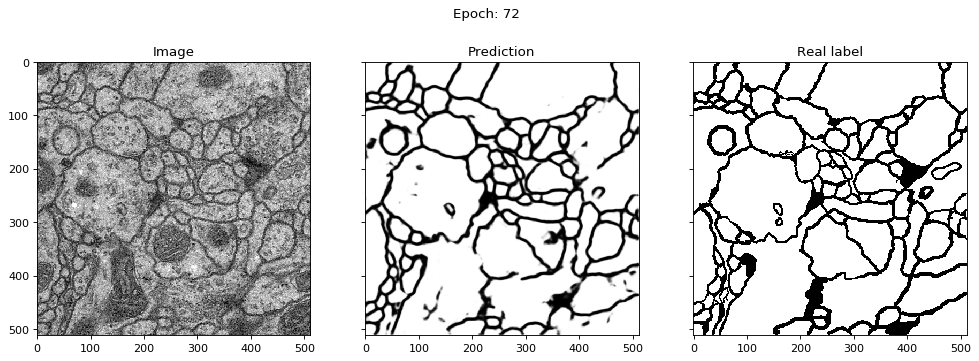

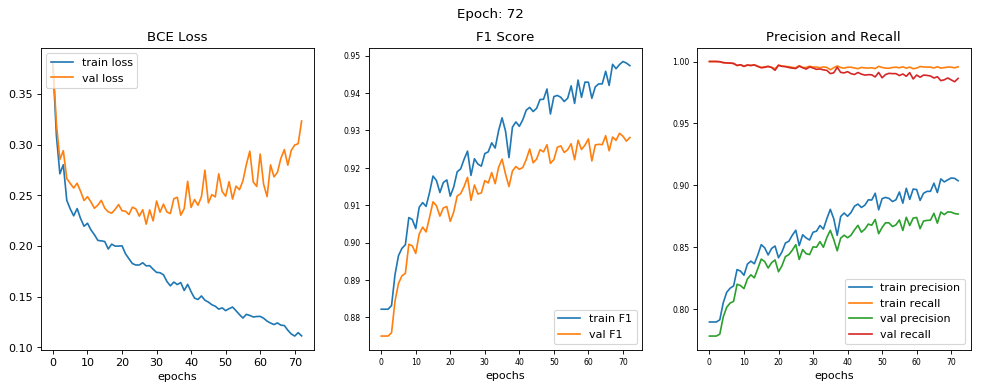

epoch [72/100] 
train loss = 0.1113, train f1 score = 0.9473 
train precision = 0.9036, train recall = 0.9957 

val loss = 0.3234, val f1 score = 0.9281 
val precision = 0.8767, val recall = 0.9863 




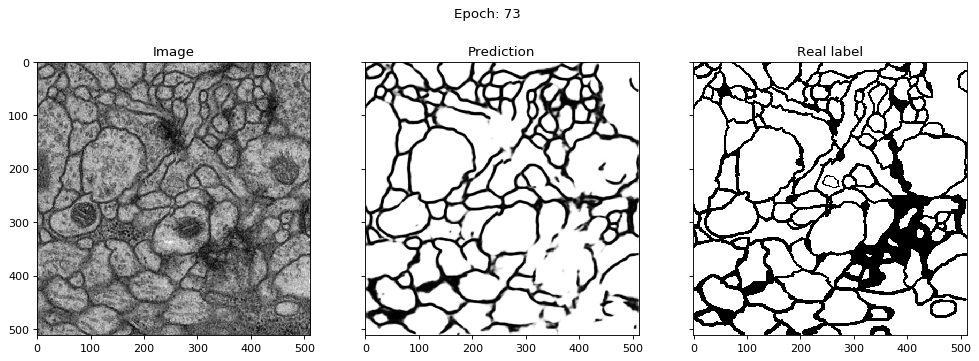

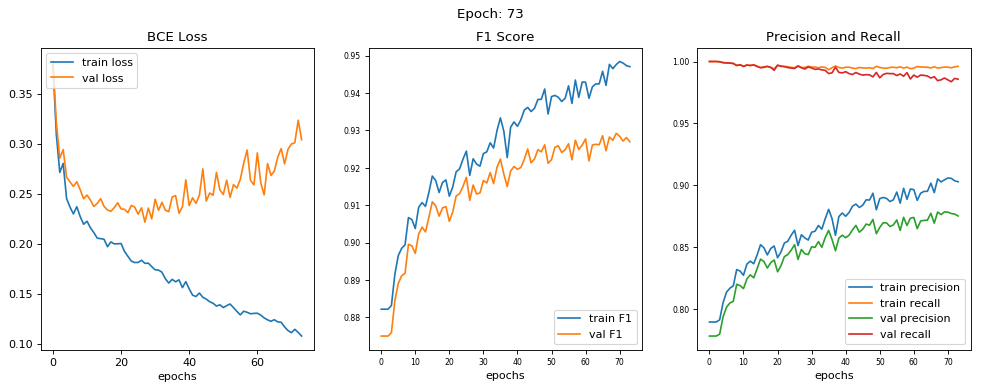

epoch [73/100] 
train loss = 0.1077, train f1 score = 0.9470 
train precision = 0.9028, train recall = 0.9961 

val loss = 0.3039, val f1 score = 0.9269 
val precision = 0.8752, val recall = 0.9857 




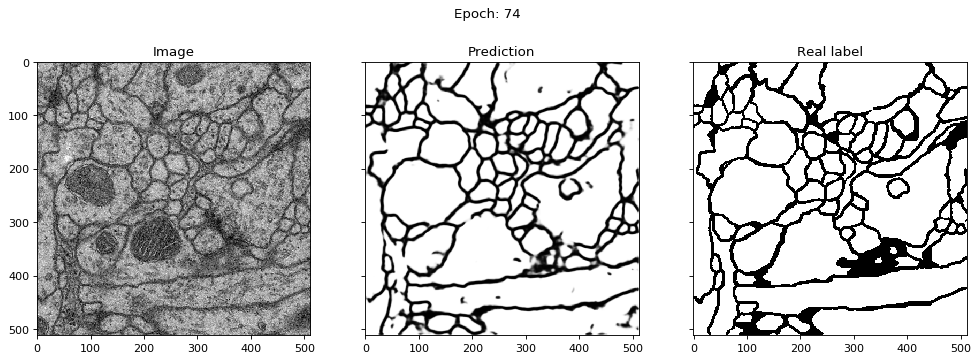

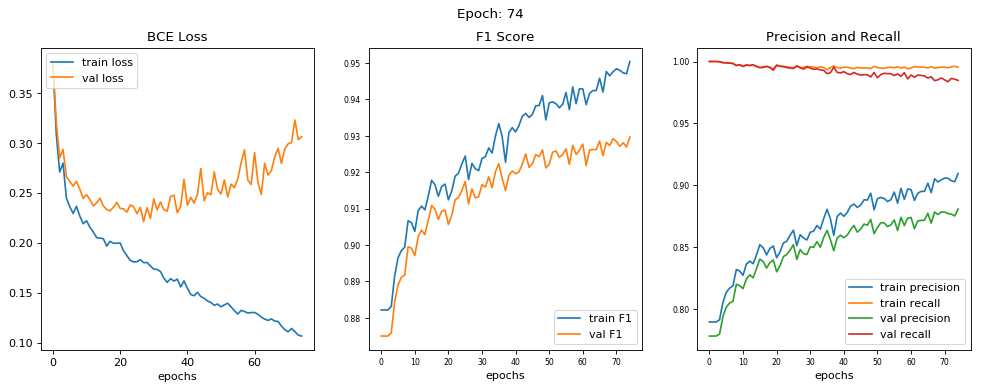

epoch [74/100] 
train loss = 0.1068, train f1 score = 0.9504 
train precision = 0.9095, train recall = 0.9954 

val loss = 0.3067, val f1 score = 0.9297 
val precision = 0.8808, val recall = 0.9847 




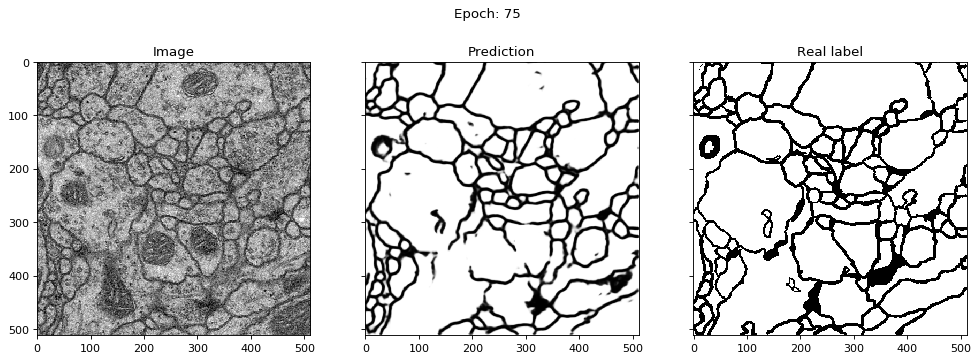

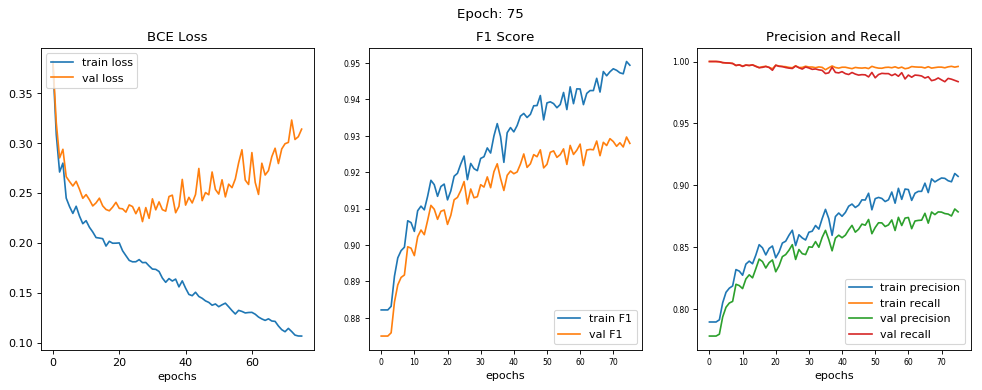

epoch [75/100] 
train loss = 0.1068, train f1 score = 0.9494 
train precision = 0.9072, train recall = 0.9960 

val loss = 0.3143, val f1 score = 0.9279 
val precision = 0.8785, val recall = 0.9837 




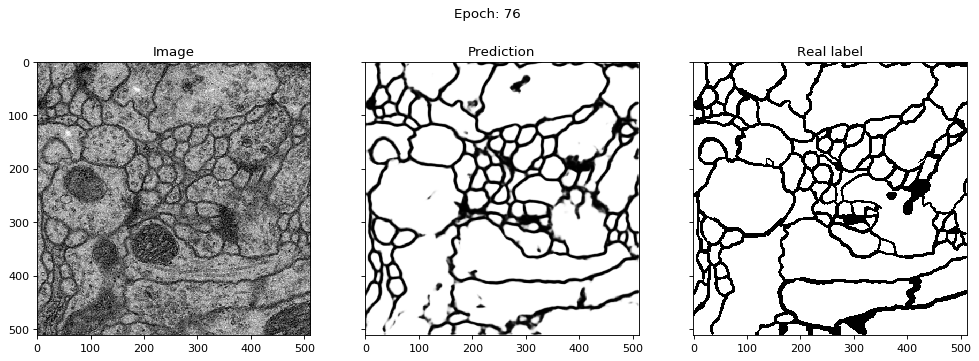

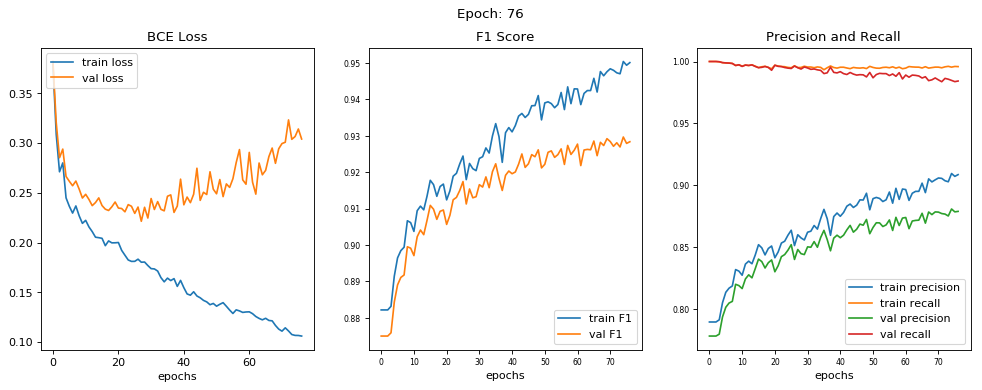

epoch [76/100] 
train loss = 0.1062, train f1 score = 0.9501 
train precision = 0.9086, train recall = 0.9959 

val loss = 0.3042, val f1 score = 0.9284 
val precision = 0.8789, val recall = 0.9842 




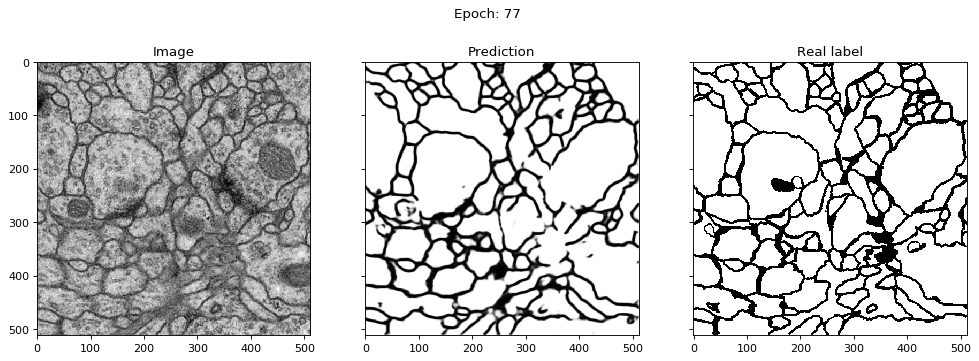

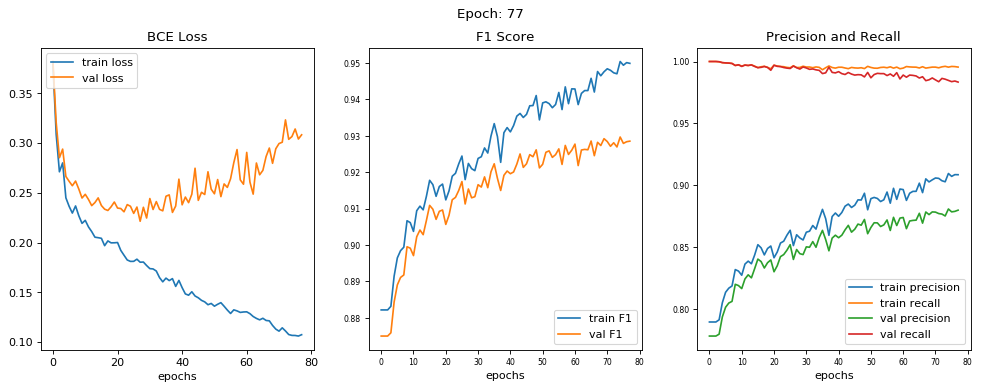

epoch [77/100] 
train loss = 0.1075, train f1 score = 0.9499 
train precision = 0.9085, train recall = 0.9955 

val loss = 0.3084, val f1 score = 0.9285 
val precision = 0.8799, val recall = 0.9834 




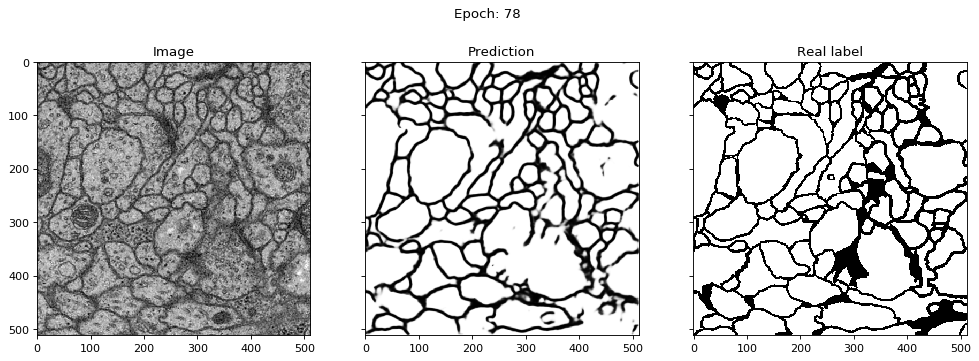

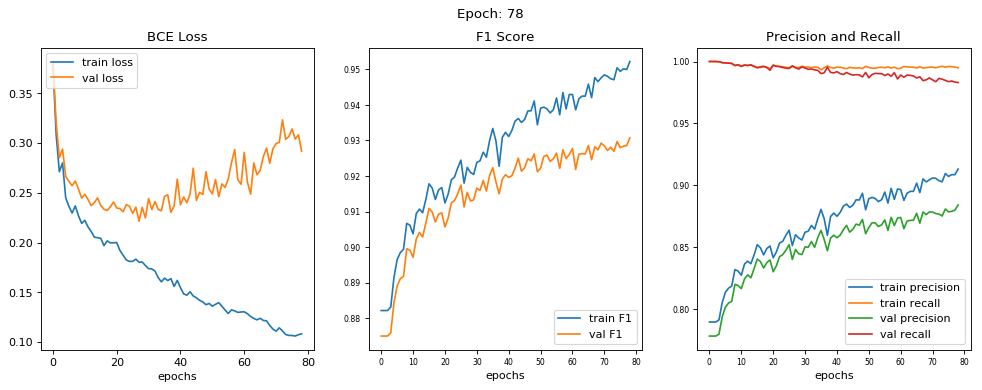

epoch [78/100] 
train loss = 0.1085, train f1 score = 0.9522 
train precision = 0.9131, train recall = 0.9949 

val loss = 0.2920, val f1 score = 0.9307 
val precision = 0.8841, val recall = 0.9830 




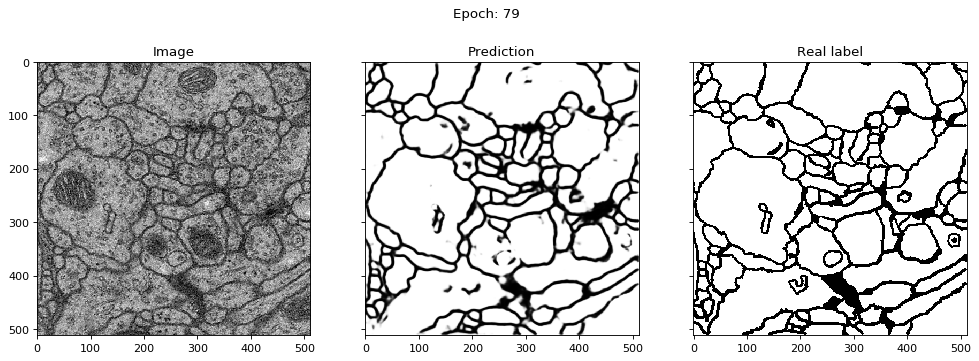

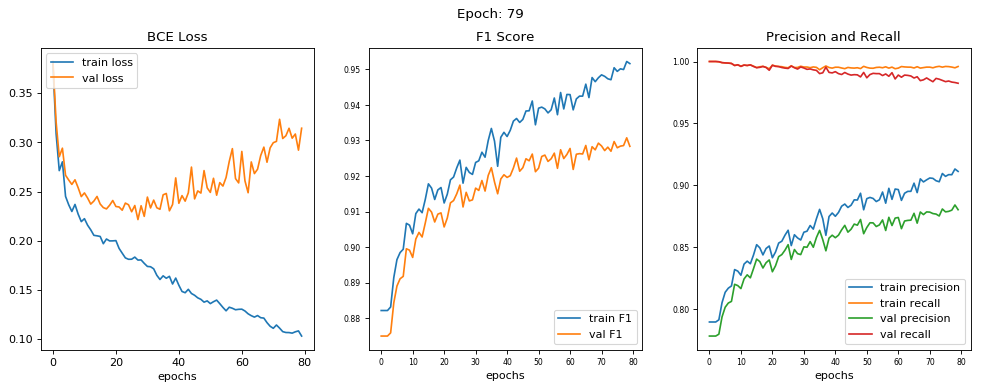

epoch [79/100] 
train loss = 0.1032, train f1 score = 0.9516 
train precision = 0.9112, train recall = 0.9960 

val loss = 0.3143, val f1 score = 0.9283 
val precision = 0.8802, val recall = 0.9824 




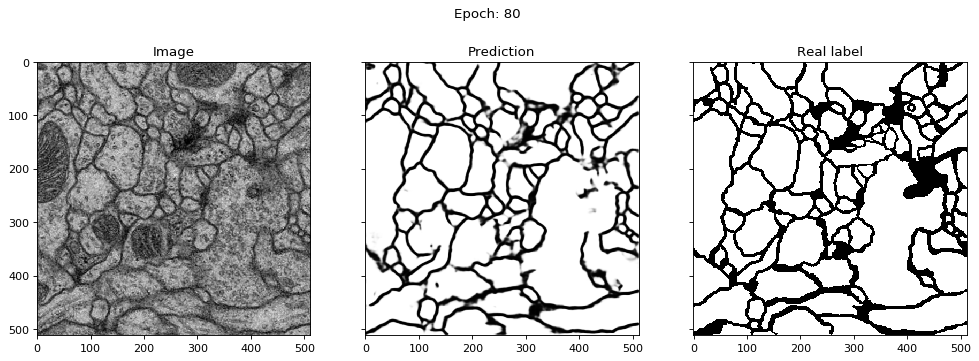

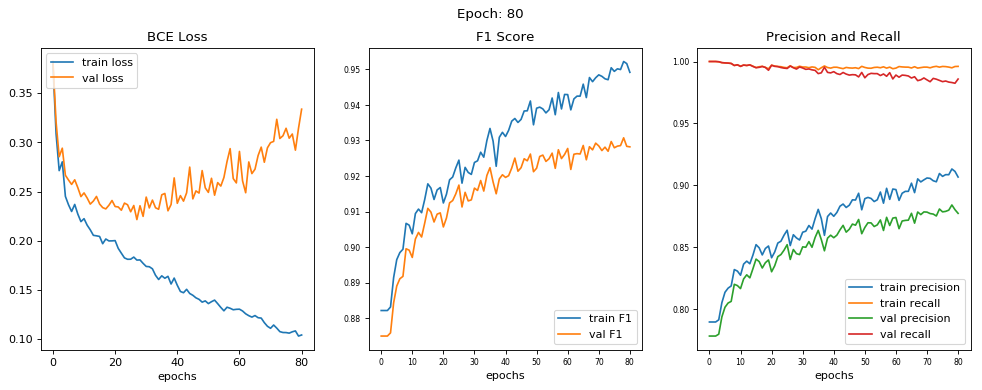

epoch [80/100] 
train loss = 0.1043, train f1 score = 0.9491 
train precision = 0.9066, train recall = 0.9961 

val loss = 0.3336, val f1 score = 0.9282 
val precision = 0.8773, val recall = 0.9858 




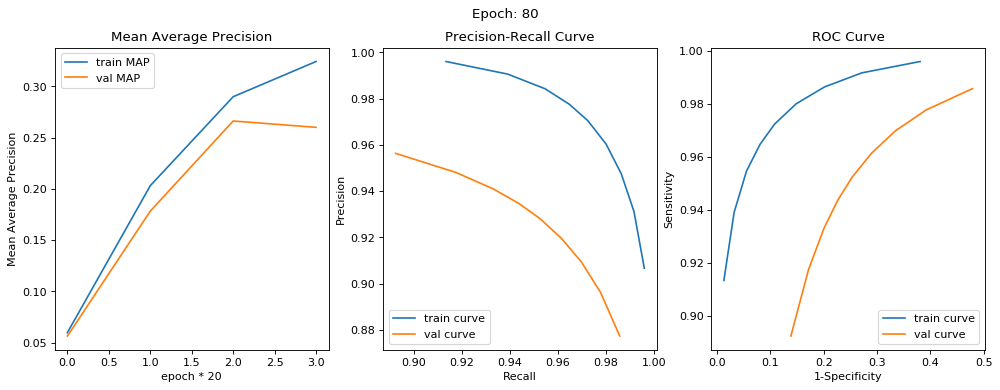

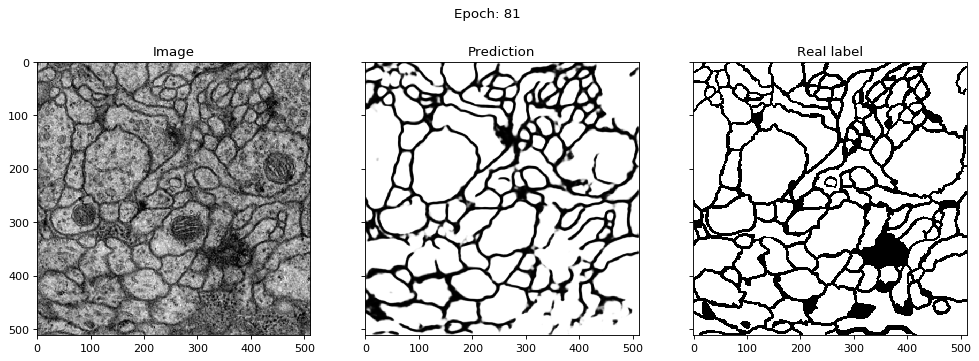

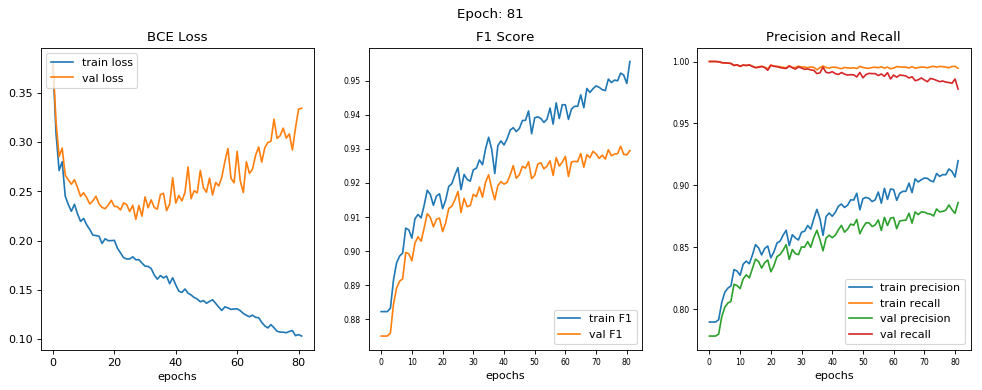

epoch [81/100] 
train loss = 0.1028, train f1 score = 0.9556 
train precision = 0.9198, train recall = 0.9945 

val loss = 0.3346, val f1 score = 0.9294 
val precision = 0.8860, val recall = 0.9778 




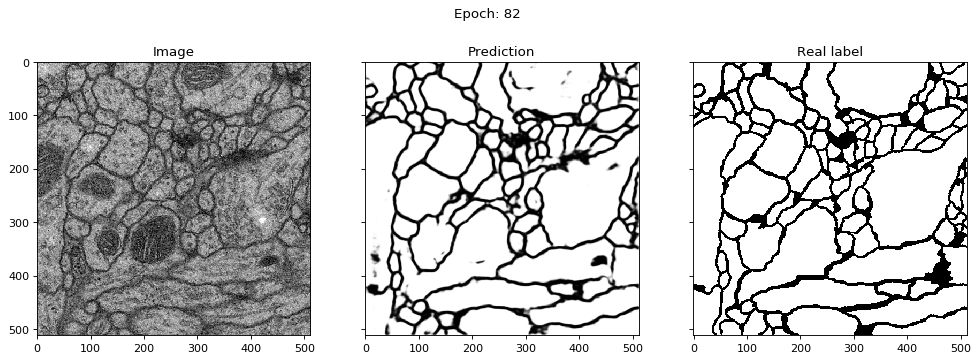

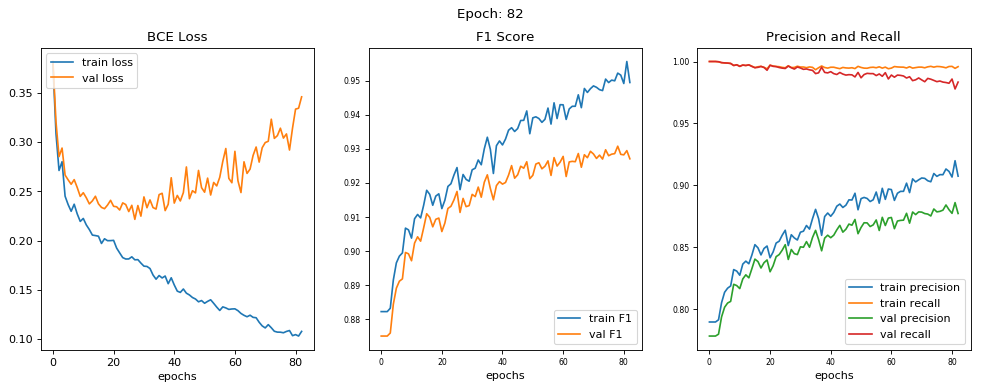

epoch [82/100] 
train loss = 0.1076, train f1 score = 0.9494 
train precision = 0.9073, train recall = 0.9958 

val loss = 0.3461, val f1 score = 0.9270 
val precision = 0.8771, val recall = 0.9834 




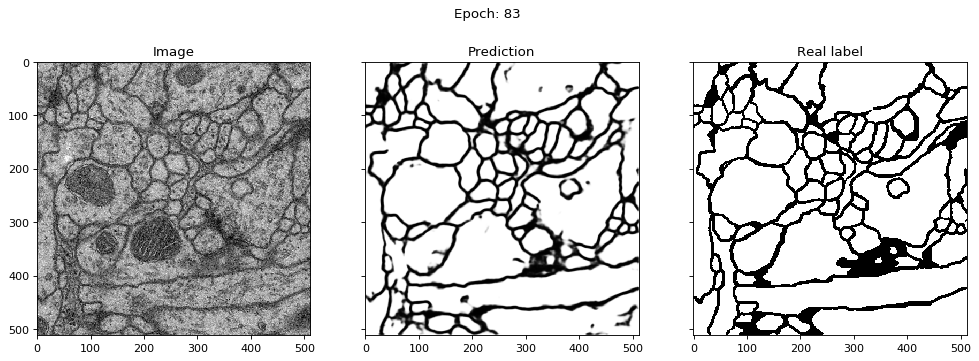

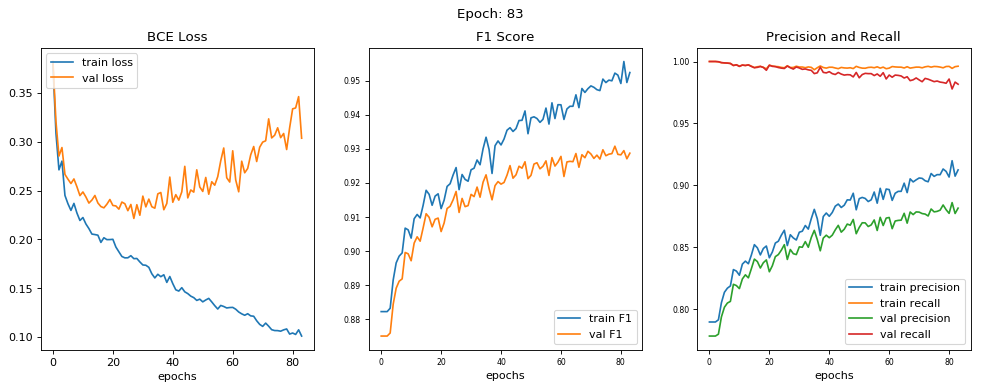

epoch [83/100] 
train loss = 0.1012, train f1 score = 0.9523 
train precision = 0.9124, train recall = 0.9962 

val loss = 0.3036, val f1 score = 0.9287 
val precision = 0.8815, val recall = 0.9817 




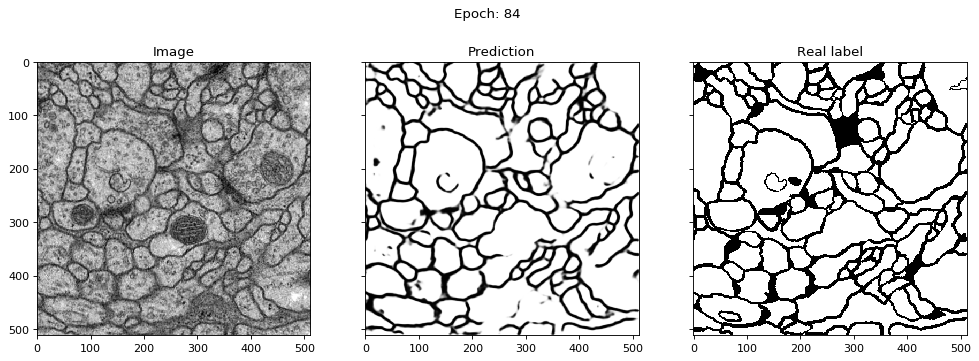

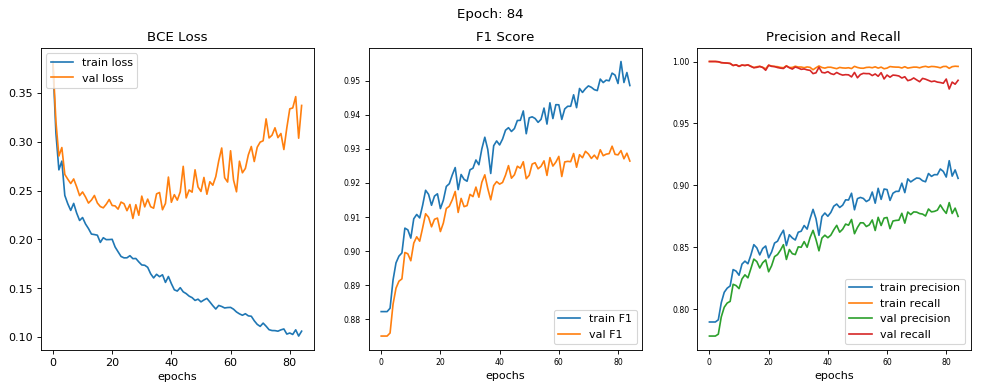

epoch [84/100] 
train loss = 0.1062, train f1 score = 0.9485 
train precision = 0.9056, train recall = 0.9960 

val loss = 0.3371, val f1 score = 0.9264 
val precision = 0.8748, val recall = 0.9848 




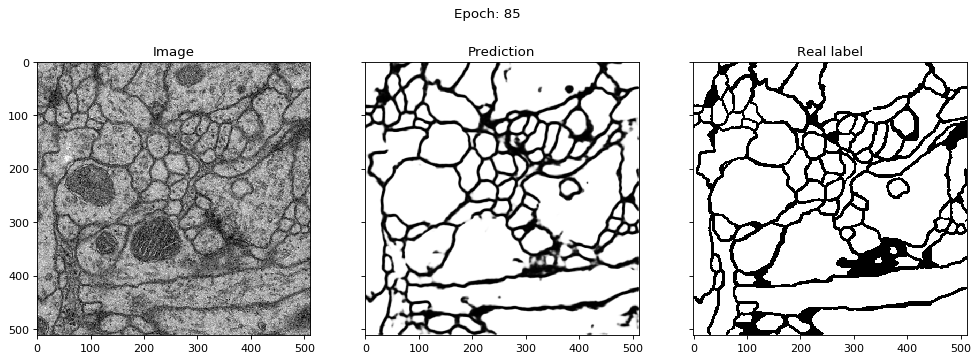

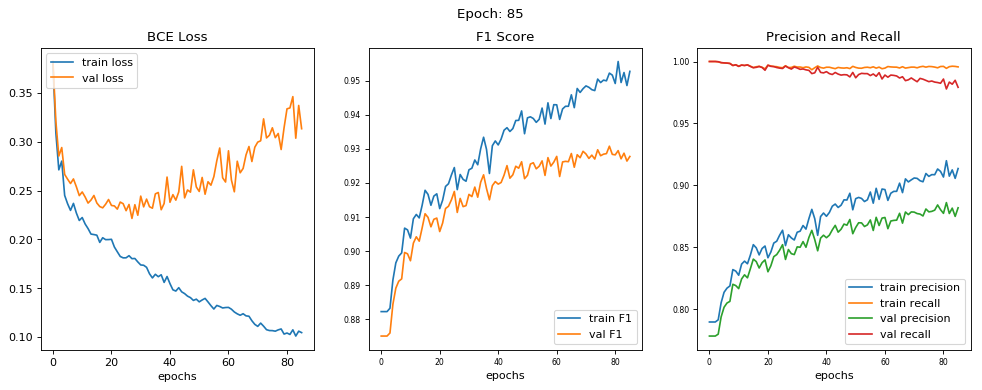

epoch [85/100] 
train loss = 0.1047, train f1 score = 0.9527 
train precision = 0.9135, train recall = 0.9956 

val loss = 0.3133, val f1 score = 0.9277 
val precision = 0.8818, val recall = 0.9791 




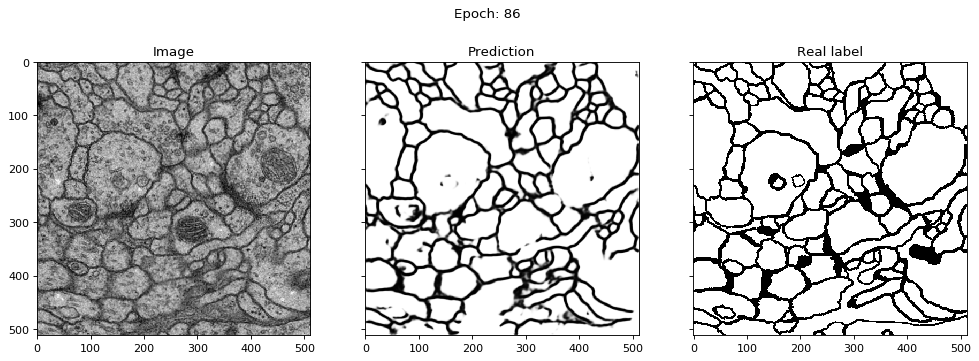

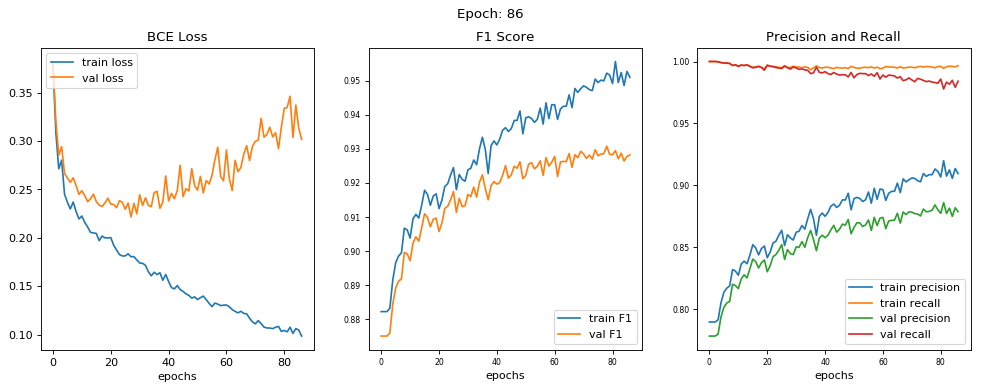

epoch [86/100] 
train loss = 0.0985, train f1 score = 0.9509 
train precision = 0.9094, train recall = 0.9966 

val loss = 0.3017, val f1 score = 0.9281 
val precision = 0.8786, val recall = 0.9841 




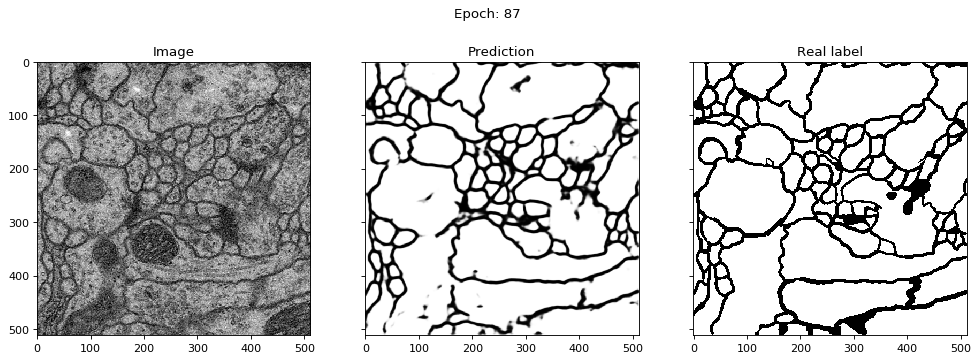

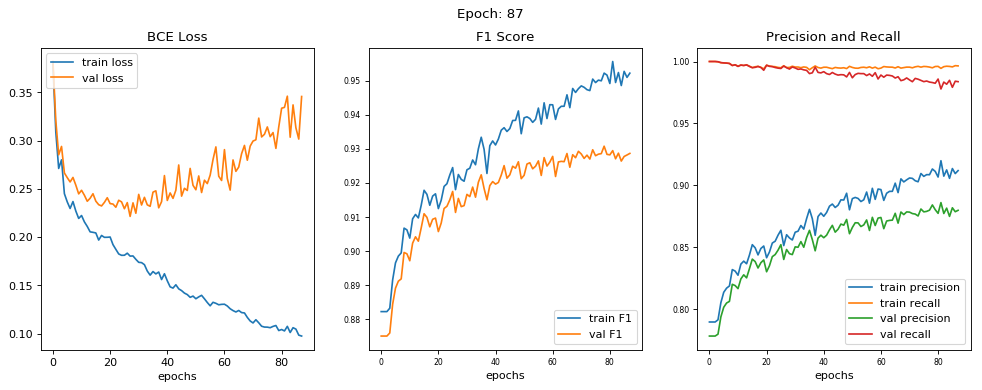

epoch [87/100] 
train loss = 0.0975, train f1 score = 0.9522 
train precision = 0.9118, train recall = 0.9964 

val loss = 0.3458, val f1 score = 0.9286 
val precision = 0.8797, val recall = 0.9837 




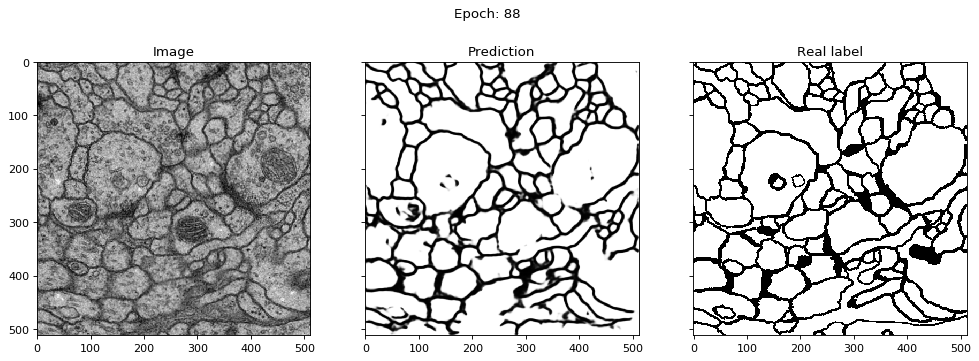

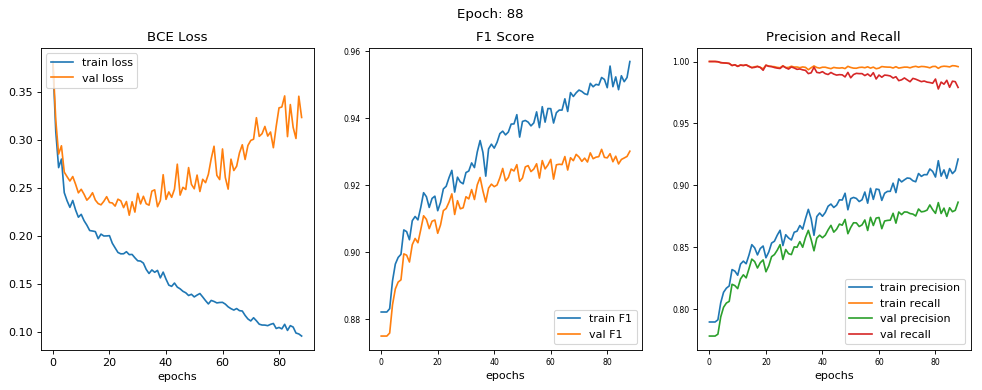

epoch [88/100] 
train loss = 0.0953, train f1 score = 0.9569 
train precision = 0.9211, train recall = 0.9958 

val loss = 0.3236, val f1 score = 0.9302 
val precision = 0.8863, val recall = 0.9790 




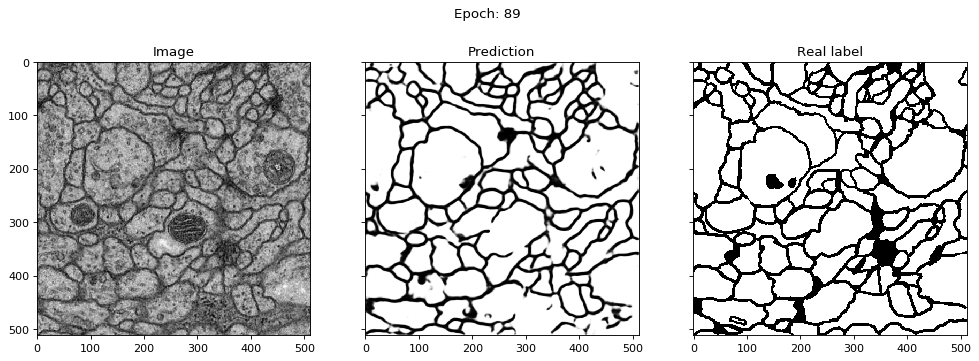

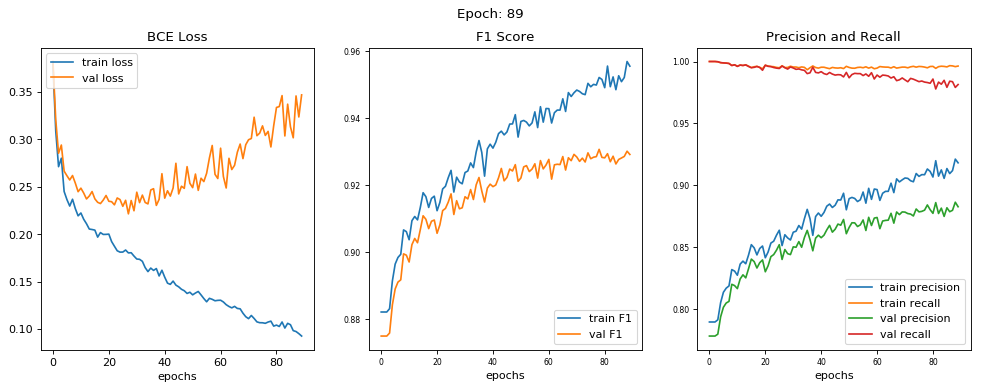

epoch [89/100] 
train loss = 0.0928, train f1 score = 0.9555 
train precision = 0.9181, train recall = 0.9963 

val loss = 0.3469, val f1 score = 0.9292 
val precision = 0.8826, val recall = 0.9814 




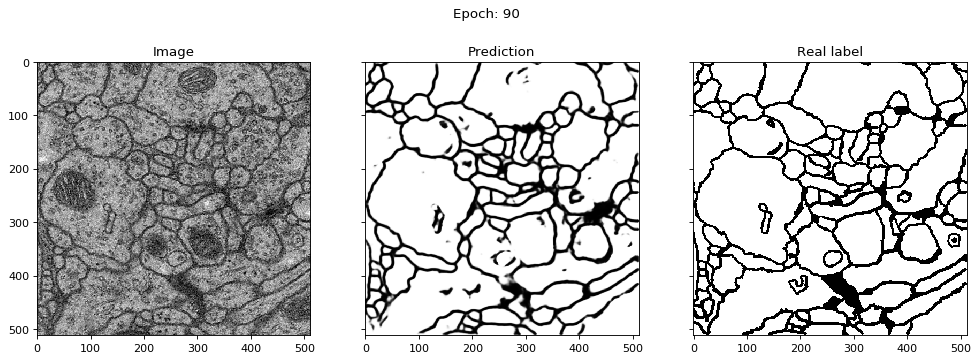

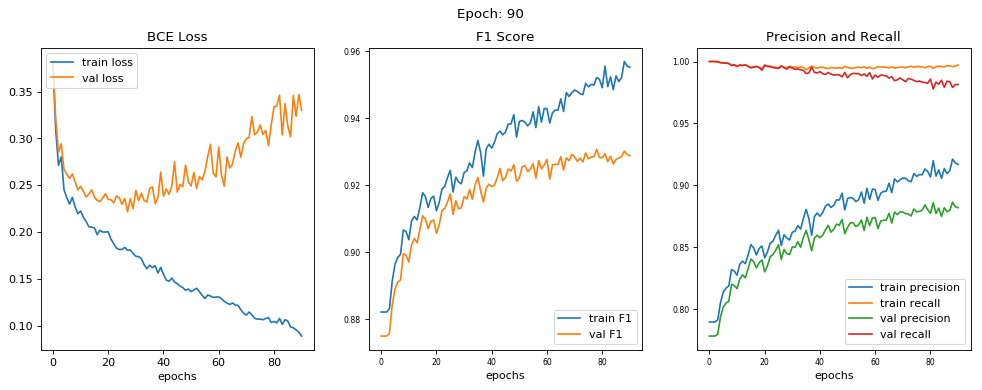

epoch [90/100] 
train loss = 0.0887, train f1 score = 0.9553 
train precision = 0.9168, train recall = 0.9972 

val loss = 0.3298, val f1 score = 0.9288 
val precision = 0.8819, val recall = 0.9814 




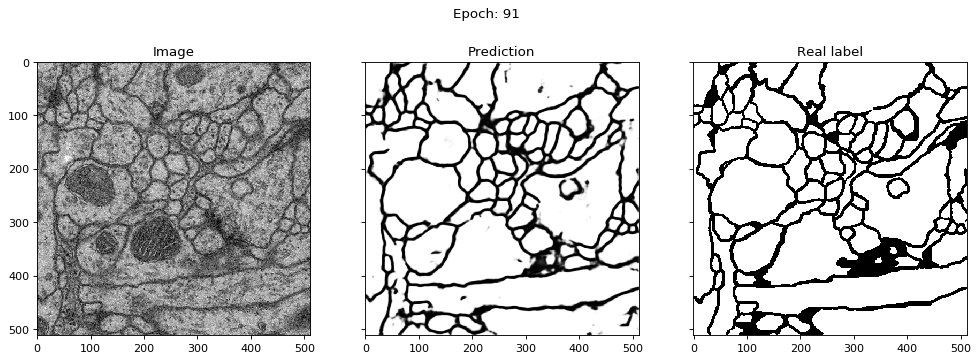

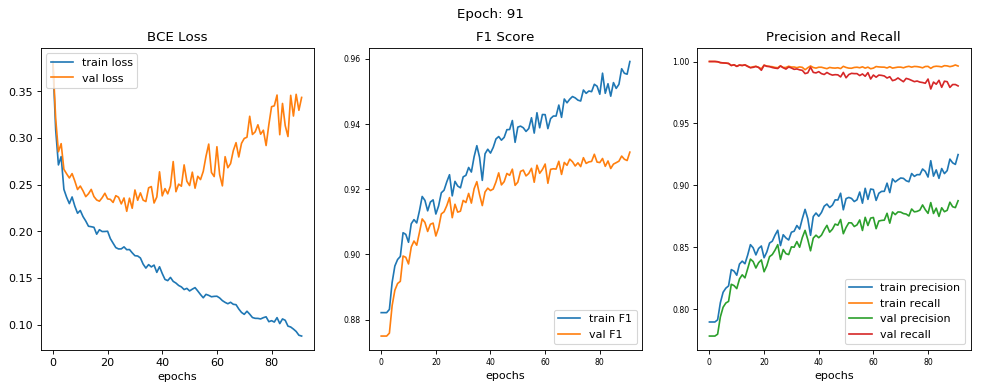

epoch [91/100] 
train loss = 0.0878, train f1 score = 0.9592 
train precision = 0.9248, train recall = 0.9963 

val loss = 0.3436, val f1 score = 0.9314 
val precision = 0.8875, val recall = 0.9803 




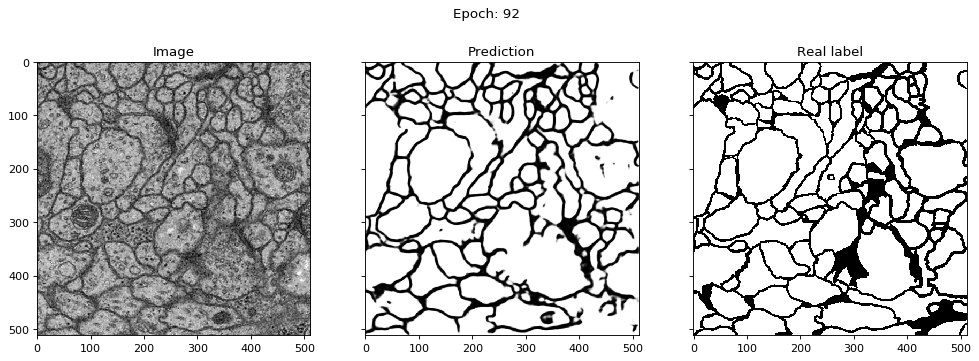

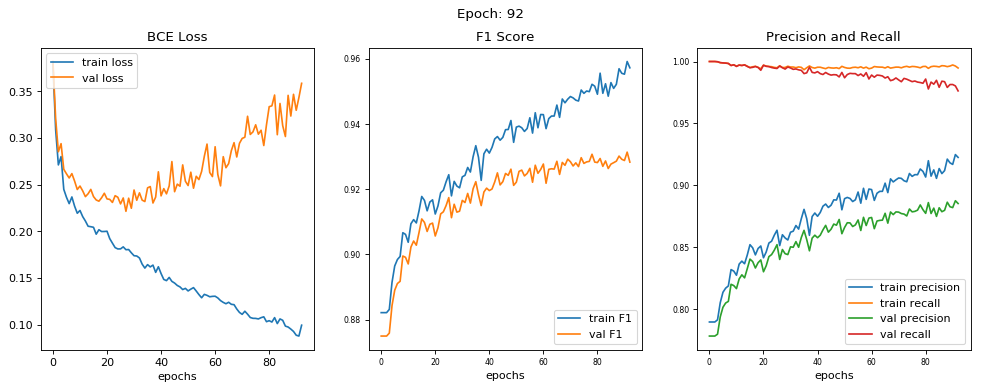

epoch [92/100] 
train loss = 0.0995, train f1 score = 0.9572 
train precision = 0.9225, train recall = 0.9948 

val loss = 0.3587, val f1 score = 0.9283 
val precision = 0.8852, val recall = 0.9762 




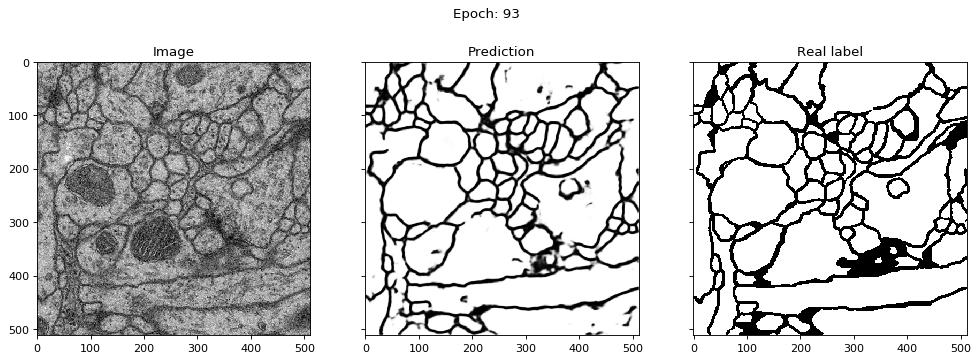

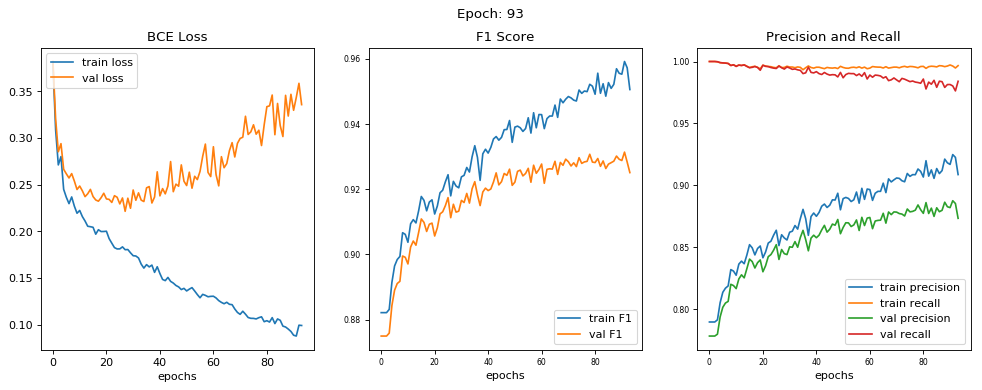

epoch [93/100] 
train loss = 0.0992, train f1 score = 0.9506 
train precision = 0.9086, train recall = 0.9966 

val loss = 0.3359, val f1 score = 0.9251 
val precision = 0.8733, val recall = 0.9840 




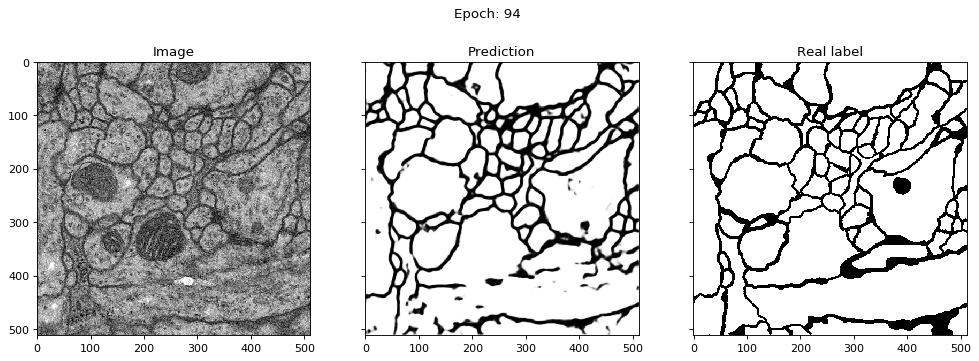

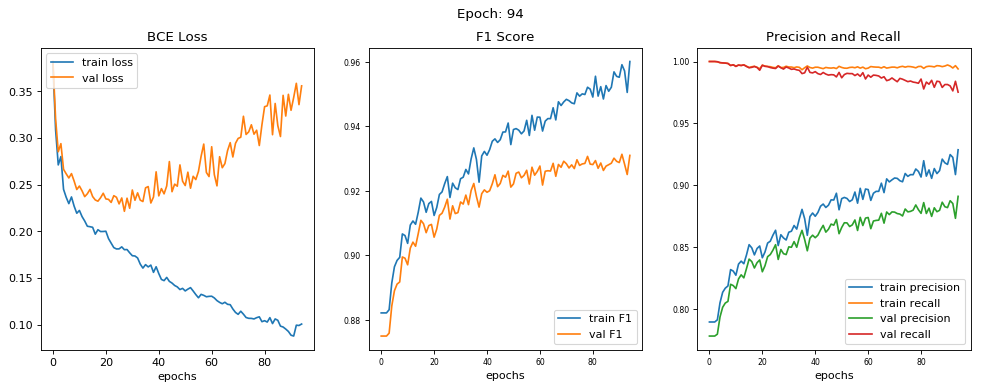

epoch [94/100] 
train loss = 0.1007, train f1 score = 0.9602 
train precision = 0.9287, train recall = 0.9940 

val loss = 0.3560, val f1 score = 0.9310 
val precision = 0.8910, val recall = 0.9752 




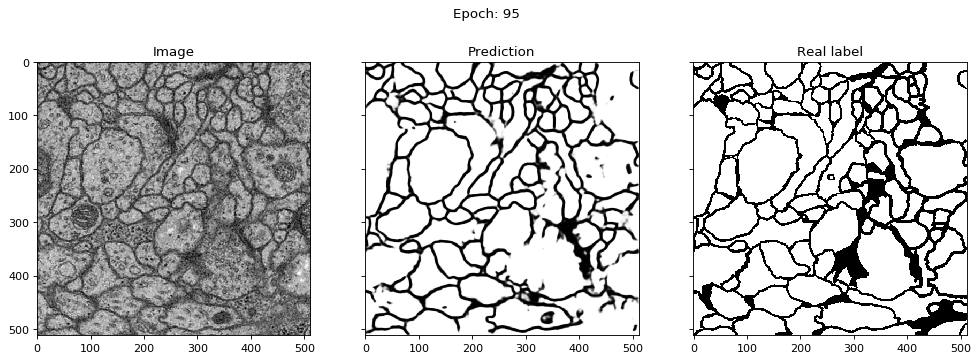

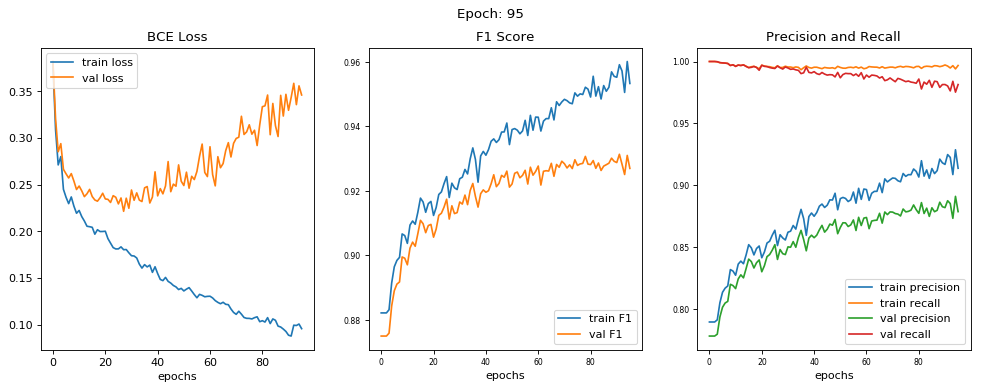

epoch [95/100] 
train loss = 0.0958, train f1 score = 0.9533 
train precision = 0.9137, train recall = 0.9968 

val loss = 0.3462, val f1 score = 0.9270 
val precision = 0.8787, val recall = 0.9814 




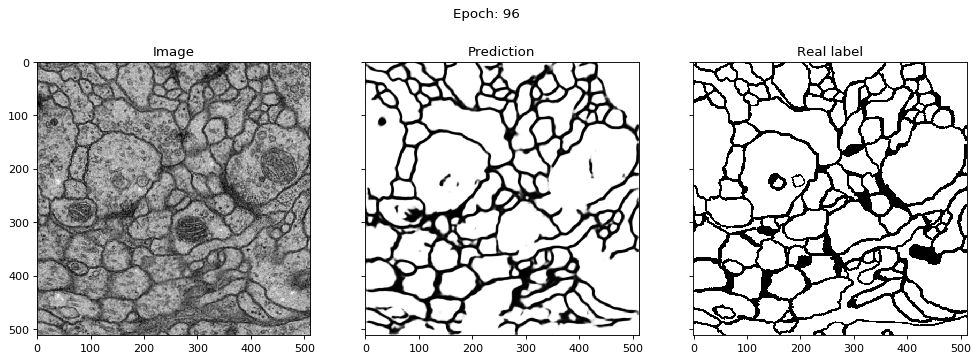

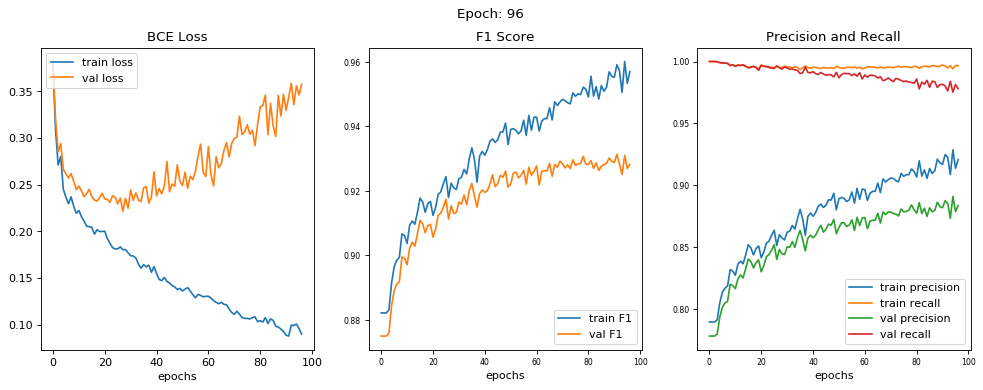

epoch [96/100] 
train loss = 0.0899, train f1 score = 0.9570 
train precision = 0.9207, train recall = 0.9966 

val loss = 0.3577, val f1 score = 0.9282 
val precision = 0.8835, val recall = 0.9781 




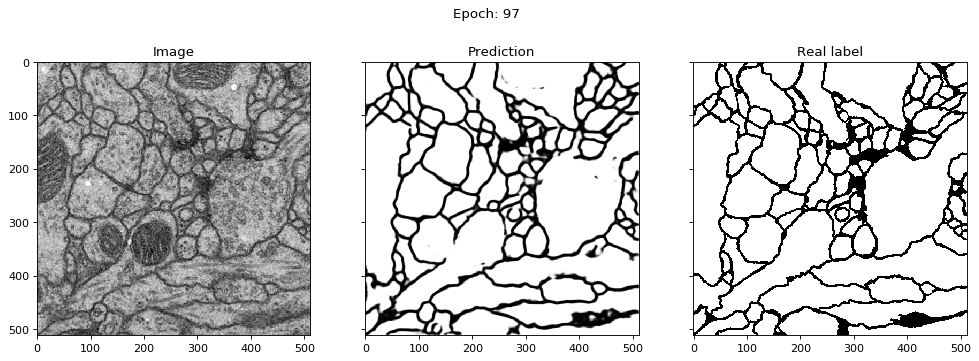

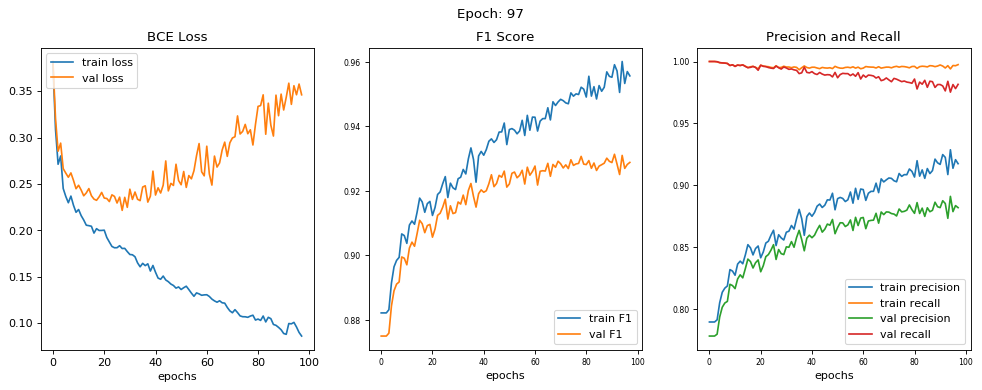

epoch [97/100] 
train loss = 0.0860, train f1 score = 0.9557 
train precision = 0.9174, train recall = 0.9975 

val loss = 0.3462, val f1 score = 0.9289 
val precision = 0.8819, val recall = 0.9815 




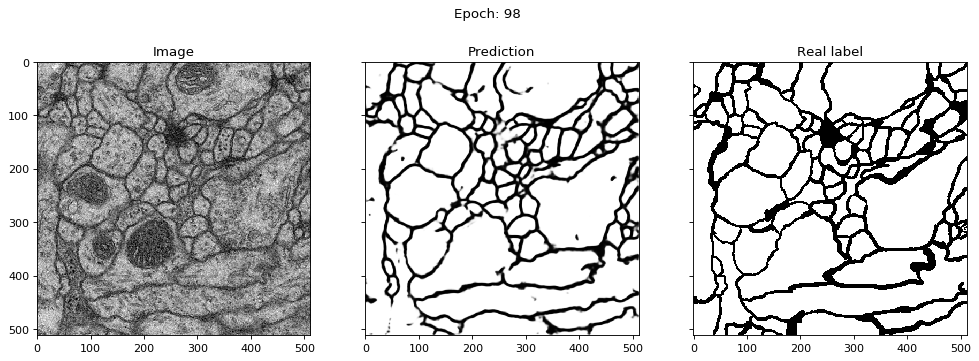

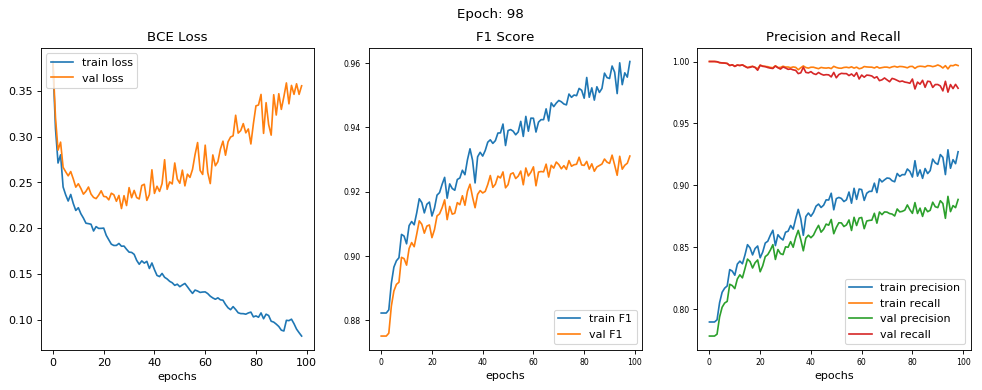

epoch [98/100] 
train loss = 0.0823, train f1 score = 0.9606 
train precision = 0.9271, train recall = 0.9967 

val loss = 0.3555, val f1 score = 0.9311 
val precision = 0.8885, val recall = 0.9784 




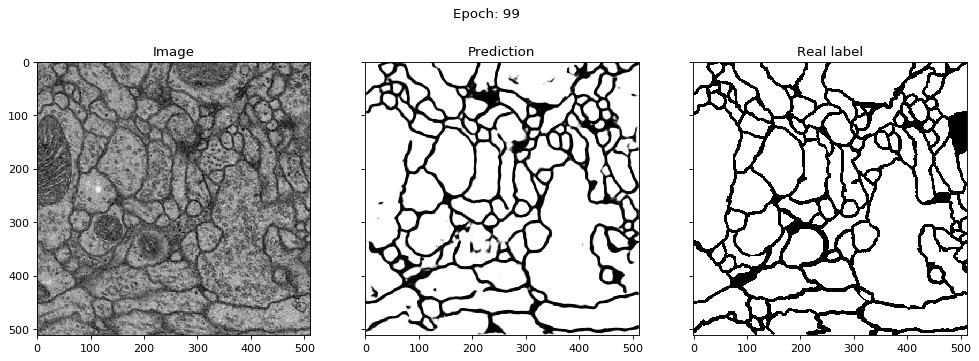

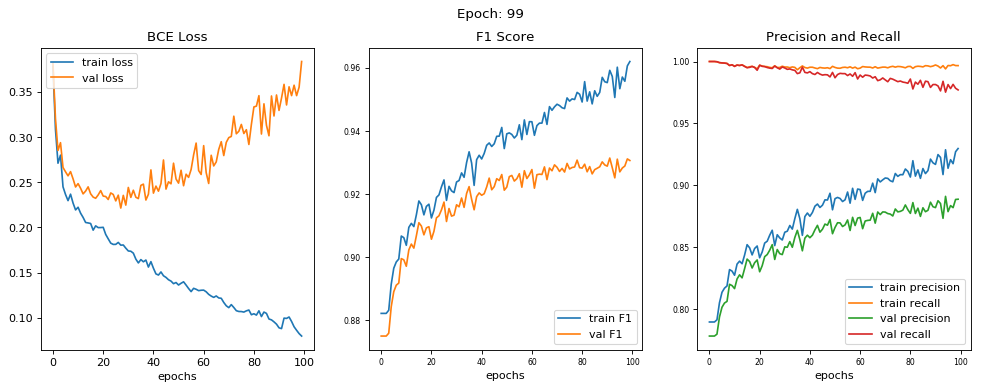

epoch [99/100] 
train loss = 0.0796, train f1 score = 0.9620 
train precision = 0.9297, train recall = 0.9967 

val loss = 0.3840, val f1 score = 0.9306 
val precision = 0.8887, val recall = 0.9770 




In [3]:
# Prep GPU
GPU = torch.cuda.is_available()
print("GPU is {}enabled ".format(['not ', ''][GPU]))

batch_size = 1
n_epochs = 200


#unet(n_channels, n_classes, n_filters_start=64 )
un = unet(1,1)
if GPU: 
    un = un.cuda()

optimizer = torch.optim.Adam(un.parameters(), lr=0.01)
criterion = nn.BCELoss()




# split into training and validation set 
total_train_size = train_imgs.shape[0]
p = np.random.permutation(total_train_size)
train_imgs = train_imgs[p]
train_labels = train_labels[p]

val_size = int(0.8*total_train_size)

val_imgs = train_imgs[:val_size]
val_labels = train_labels[:val_size]

train_imgs = train_imgs[val_size:]
train_labels = train_labels[val_size:]

print("80/20 training/validation split")
print("total_train_size = ",total_train_size)
print("val_size = ", val_size)


# traning set

img_resize = 512
TrainDataset = Array_Dataset(train_imgs, train_labels, img_resize)
TrainDataLoader = DataLoader(TrainDataset,
                             batch_size=batch_size,
                             shuffle=True,
                             num_workers=4)

# validation set 
ValDataset = Array_Dataset(val_imgs, val_labels, img_resize, do_transform=False)
ValDataLoader = DataLoader(ValDataset,
                             batch_size=1,
                             shuffle=True,
                             num_workers=4)

for i, data in enumerate(TrainDataLoader):

        print("training image from batch %d" % i)
        
    

        imgs = np.array(data[0])
        labels = data[1]
       
        mask, nlabels = ndimage.label(labels[0])

        
        rand_cmap = ListedColormap(np.random.rand(256,3))

        labels_for_display = np.where(mask > 0, mask, np.nan)

        f, (ax1,ax2,ax3) = plt.subplots(1,3, sharey=True,figsize=(15,5), dpi=80)

        #original = (np.squeeze(imgs[0])+1)*127.0
        original = np.squeeze(imgs[0])
        

        ax1.imshow(original, cmap="gray")
        ax1.set_title("Original Image")
        ax1.axis('off')
        
        ax2.imshow(np.squeeze(labels[0]), cmap="gray")
        ax2.set_title("Ground Truth Mask")
        ax2.axis('off')
        
        ax3.imshow(original, cmap="gray")
        ax3.imshow(np.squeeze(labels_for_display), cmap=rand_cmap)
        ax3.set_title("Instance Segmentation (%d structures)"% nlabels)
        ax3.axis('off')
        

        plt.show()
        
        if i > 1: 
            break



output_dir = "./isbi2012_output/"
# run training 
#training(GPU, un,train_imgs, train_labels, val_imgs, val_labels, optimizer, criterion, n_epochs, batch_size)
training(GPU, TrainDataLoader, ValDataLoader, ValDataset, un, optimizer, criterion, n_epochs, batch_size, output_dir, warm_start=False)

In [4]:
whos


Variable                 Type              Data/Info
----------------------------------------------------
Array_Dataset            type              <class 'data_loader.Array_Dataset'>
DataLoader               type              <class 'torch.utils.data.dataloader.DataLoader'>
Dataset                  type              <class 'torch.utils.data.dataset.Dataset'>
EM_Dataset               type              <class 'data_loader.EM_Dataset'>
F                        module            <module 'torch.nn.functio<...>/torch/nn/functional.py'>
GPU                      bool              True
Image                    module            <module 'PIL.Image' from <...>e-packages/PIL/Image.py'>
Kaggle_Dataset           type              <class 'data_loader.Kaggle_Dataset'>
ListedColormap           type              <class 'matplotlib.colors.ListedColormap'>
TrainDataLoader          DataLoader        <torch.utils.data.dataloa<...>object at 0x7f08f023bf60>
TrainDataset             Array_Dataset     <data_l

# todo 

0. model.train() vs model.eval()
1. tune prediction threshold parameter 
2. disconnecting objects 
3. more datasets 
4. inception modules 